In [1]:
%matplotlib notebook

# import standard packages
from scipy.optimize import curve_fit
import sys
import matplotlib.pyplot as plt
plt.rcParams['figure.max_open_warning'] = 50
import pickle
import imageio
import os

# import own packages
beam_tomo_analyse_folder = r"C:\Users\Rui\Documents\GitHub\beam_tomography" #Windows
beam_tomo_analyse_folder = r"/Users/rui/Documents/GitHub/beam_tomography/" #Mac
sys.path.append(beam_tomo_analyse_folder)
from beam_tomo_analyse import *

print(os.getcwd())


/Users/rui/Library/CloudStorage/GoogleDrive-rui.vasconcelos@vitrealab.com/Shared drives/VitreaLab Share/Lab Data/Light Engine Team/X-Reality Projects (XR)/Augmented Reality (AR)/Lab Data/AR/2024-01-19/Blue


# Generate preview movie 

In [ ]:
print("-"*30)
filenames = [item for item in os.listdir() if ".pkl" in item and ".mp4" not in item]
filenames

In [ ]:
#load data
filename = filenames[0]
with open(filename, "rb") as file:
    data = pickle.load(file)
    
img_store = data["img_store"]
coord_store = data["coord_store"]

# Convert numpy arrays to uint8 (required for imageio)
img_store_8bit = [convert_uint16_to_uint8(item) for item in img_store] 

# Create a movie
imageio.mimsave(f'{filename}_seq.mp4', img_store_8bit, fps=15)  # fps specifies frames per second

#Generate images
for i in range(len(img_store)):
    img_i = img_store_8bit[i]
    label_i = float(coord_store[i])
    plt.figure()
    plt.imshow(img_i)
    plt.xlabel("id_y")
    plt.ylabel("id_x")
    plt.colorbar()
    plt.title(f"z = {label_i:.2f}mm")

# Run entire analysis at once

In [ ]:

# Access folder with data in G drive
folder_path = r"G:\Shared drives\VitreaLab Share\Lab Data\Light Engine Team\X-Reality Projects (XR)\Augmented Reality (AR)\Lab Data\AR\2024-01-19\Blue\\"
folder_path = r"/Users/rui/Library/CloudStorage/GoogleDrive-rui.vasconcelos@vitrealab.com/Shared drives/VitreaLab Share/Lab Data/Light Engine Team/X-Reality Projects (XR)/Augmented Reality (AR)/Lab Data/AR/2024-01-19/Blue/"
files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]
filenames = sorted([item for item in files if ".pkl" in item and ".mp4" not in item])

# Parameters
filename = filenames[0] 
file_path = os.path.join(folder_path, filename)
grid_shape = (10, 8) #rows, cols 
roi_width = 100
method = "stats" #"stats" of "fit"

# Load data
tomo = Tomography(file_path, grid_shape, method, roi_width)
tomo.load_data()

#Prepare images, extract beams coords and widths and calculate direction cosines and divergence
tomo.find_rot_spacing(angle_min = 0, angle_max = 3, angle_step = 0.25)
tomo.find_pos_and_widths(debug = False) #Find coords for all the other layers
tomo.set_max_z(16.89) #limits fits to cross section with z<max_z;
tomo.find_dir_cos_div(limit_z_fit = True, debug = True) #debug = True, shows and saves the fits to the beam positions and divergence

#Plots
tomo.plot_div(save = True,)
tomo.plot_div_hist(save = True)
tomo.plot_dir(save = True)
tomo.plot_dir_single(save = True)
tomo.plot_uniformity(save = True)

# List and load measurements 

In [2]:
# Access folder with data in G drive
folder_path = r"G:\Shared drives\VitreaLab Share\Lab Data\Light Engine Team\X-Reality Projects (XR)\Augmented Reality (AR)\Lab Data\AR\2024-01-19\Blue\\"
folder_path = r"/Users/rui/Library/CloudStorage/GoogleDrive-rui.vasconcelos@vitrealab.com/Shared drives/VitreaLab Share/Lab Data/Light Engine Team/X-Reality Projects (XR)/Augmented Reality (AR)/Lab Data/AR/2024-01-19/Blue/"
files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]
filenames = sorted([item for item in files if ".pkl" in item and ".mp4" not in item])
filenames

['17.15.33 tomography.pkl', '17.22.08 tomography.pkl']

In [3]:
# Parameters
filename = filenames[1] 
file_path = os.path.join(folder_path, filename)
grid_shape = (10, 8) #rows, cols 
roi_width = 100
method = "stats" #"stats" of "fit"
sub_backg = False #

# Load data
tomo = Tomography(file_path, grid_shape, method, roi_width = roi_width, sub_backg = sub_backg)
tomo.load_data()

#Extract beams coords and widths
tomo.find_rot_spacing(angle_min = 0, angle_max = 10, angle_step = 0.25)
tomo.find_pos_and_widths(debug = False) #Find coords for all the other layers

Loaded
Tomography measurement:

        - Filename = /Users/rui/Library/CloudStorage/GoogleDrive-rui.vasconcelos@vitrealab.com/Shared drives/VitreaLab Share/Lab Data/Light Engine Team/X-Reality Projects (XR)/Augmented Reality (AR)/Lab Data/AR/2024-01-19/Blue/17.22.08 tomography.pkl

        - Number of beam rows = 10

        - Number of beam cols = 8

        - Z-spacing: 0.100mm

        - Number of cross sections: 40
        
Extracting rotation angle for the lowest z cross section.


100%|███████████████████████████████████████████| 40/40 [00:09<00:00,  4.29it/s]


Optimal rotation angle = 1.25deg
Extracting the grid spacing
Average spacing [px] between beams = 145.17
Updating the rotation angle and rotated image for each cross section.


100%|███████████████████████████████████████████| 40/40 [00:03<00:00, 11.22it/s]


Coordinates of beam in first layer were determined.


100%|███████████████████████████████████████████| 10/10 [00:01<00:00,  6.53it/s]

Coordinates of the beams and respective widths have been determined in all cross sections


# Visualise data

In [ ]:
print(f"Lowest z: {np.min(tomo.cross_sect_z_l): .2f}mm")
print(f"Highest z: {np.max(tomo.cross_sect_z_l): .2f}mm")

## Plot beam trajectory and width

The beam.max_z_idx_fit attribute has not been set.  
 The trajectory will be plotted with all cross sections. 
 If you wish to define beam.max_z_idx_fit, please run tomo.set_max_z(val)


<IPython.core.display.Javascript object>


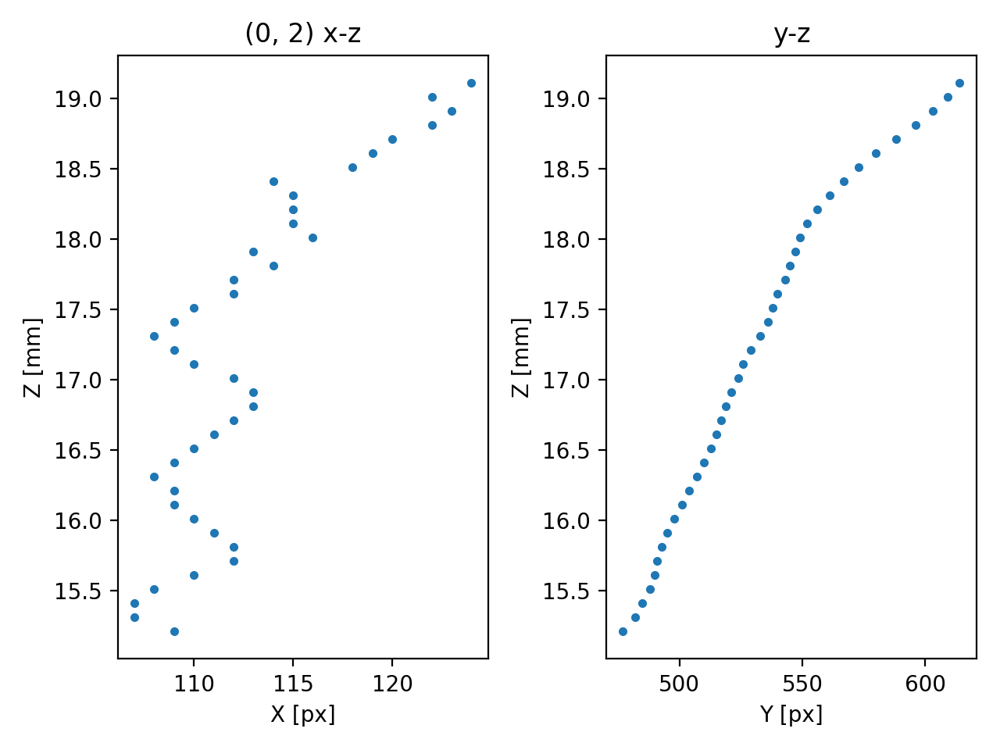

(<Figure size 640x480 with 2 Axes>,
 array([<AxesSubplot:title={'center':'(0, 2) x-z'}, xlabel='X [px]', ylabel='Z [mm]'>,
        <AxesSubplot:title={'center':'y-z'}, xlabel='Y [px]', ylabel='Z [mm]'>],
       dtype=object))

In [4]:
id_x = 0
id_y = 2
beam_i = tomo.beam_l[id_x][id_y]
beam_i.plot_trajectory(limit_z_fit = True)


## Plot single beam width evolution

In [ ]:
id_x = 0
id_y = 1
beam_i = tomo.beam_l[id_x][id_y]
beam_i.plot_width(limit_z_fit=False)


## Plot ROIs

In [ ]:
id_x = 2
id_y = 5
beam_i =tomo.beam_l[id_x][id_y]
beam_i.plot_rois()
    

## Plot ROIs and respective gaussian fits

In [ ]:
id_x = 2
id_y = 5
beam_i =tomo.beam_l[id_x][id_y]
beam_i.plot_gauss_fit(limit_z_fit = False)

## Plot beam parameters 

<IPython.core.display.Javascript object>


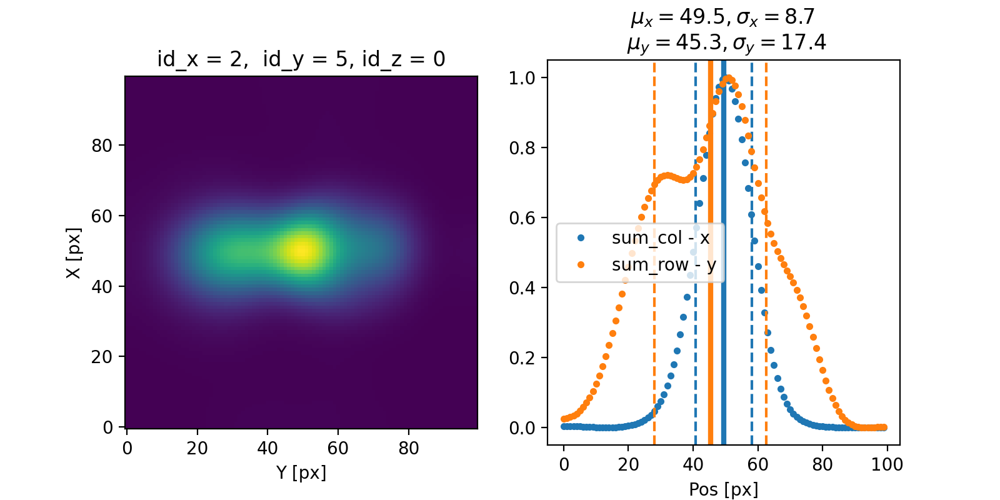

<IPython.core.display.Javascript object>


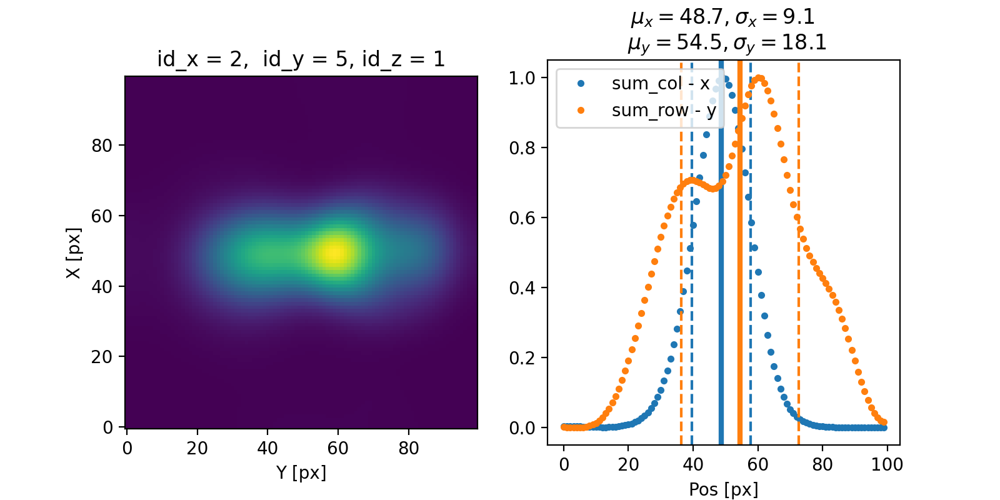

<IPython.core.display.Javascript object>


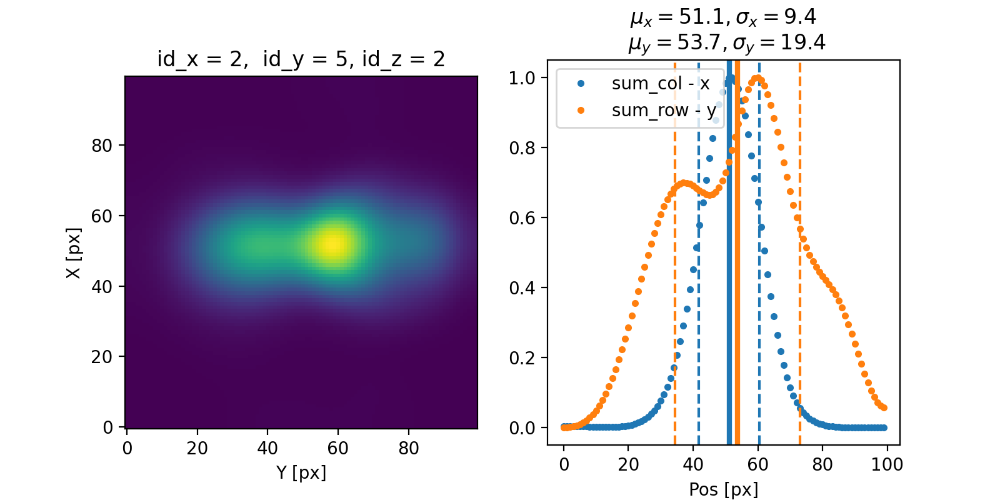

<IPython.core.display.Javascript object>


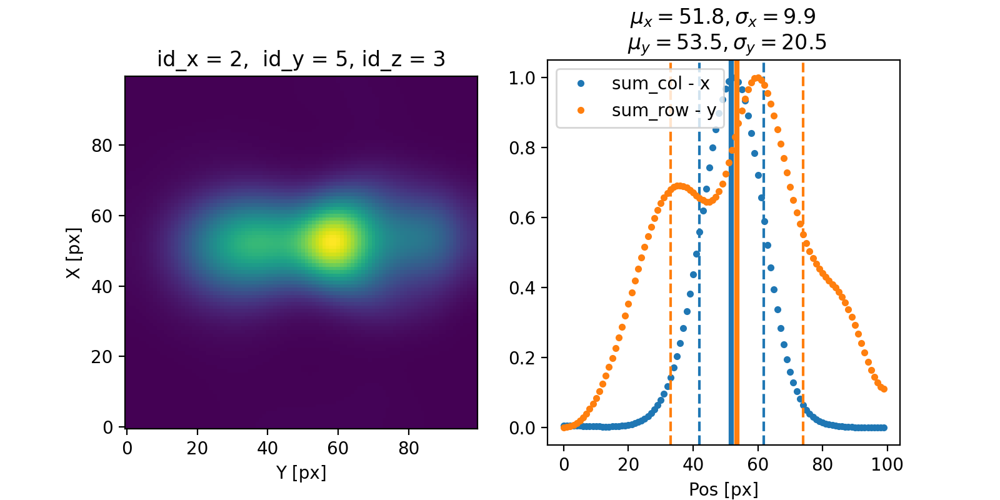

<IPython.core.display.Javascript object>


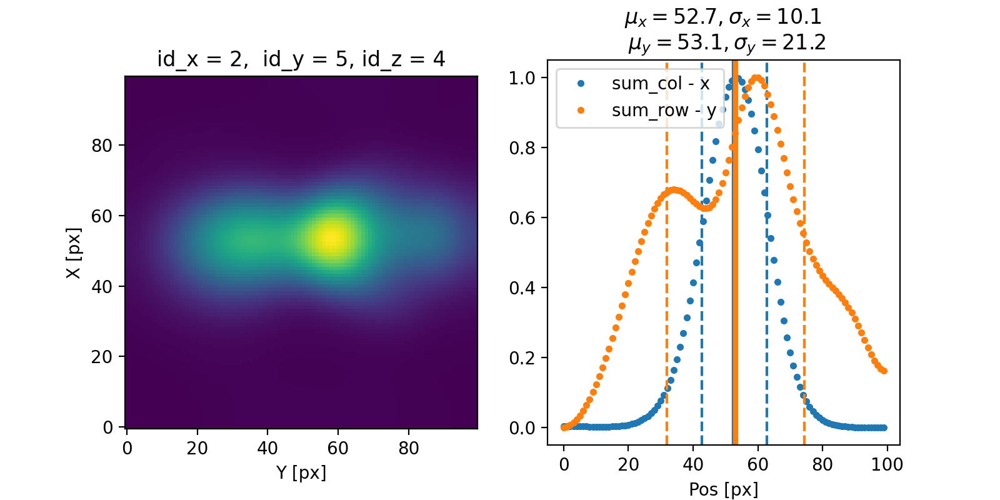

<IPython.core.display.Javascript object>


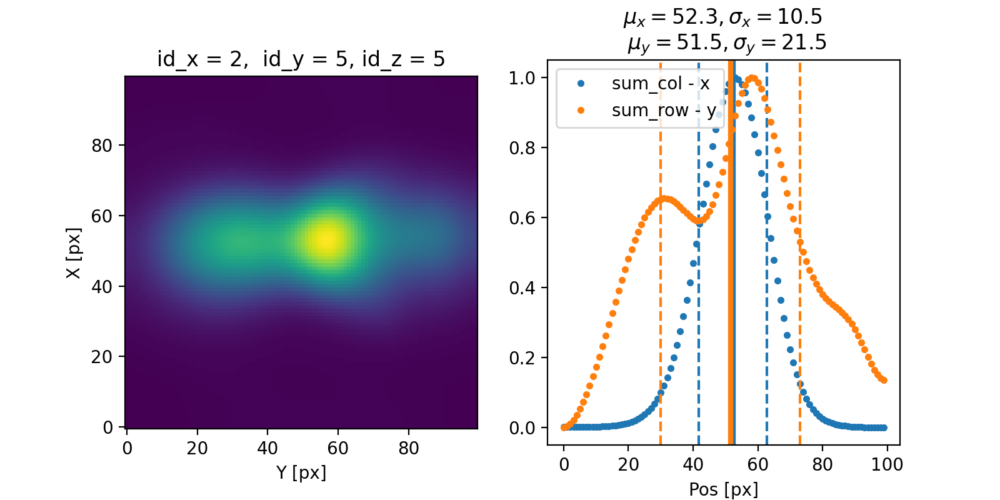

<IPython.core.display.Javascript object>


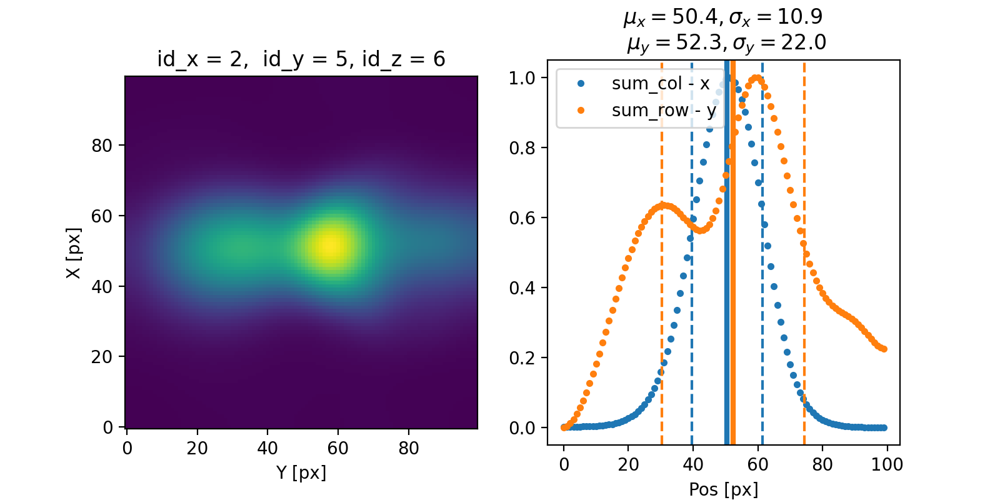

<IPython.core.display.Javascript object>


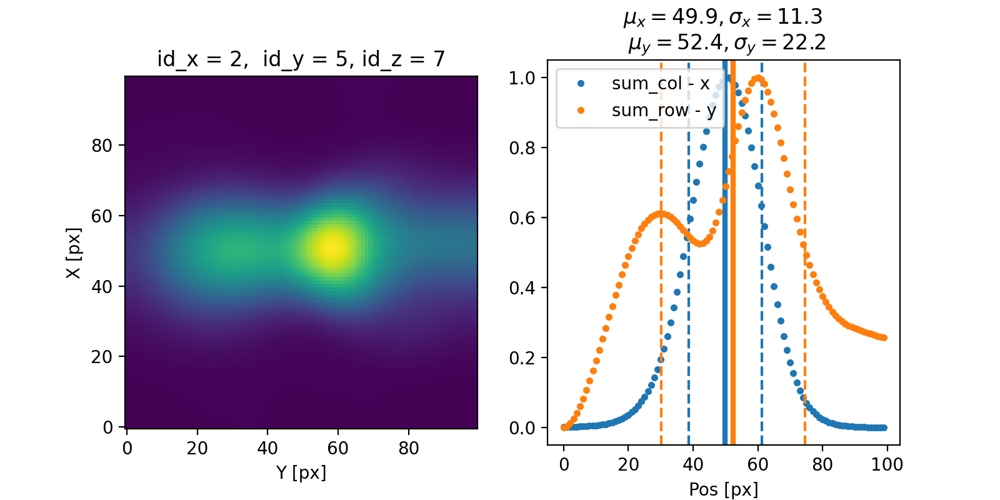

<IPython.core.display.Javascript object>


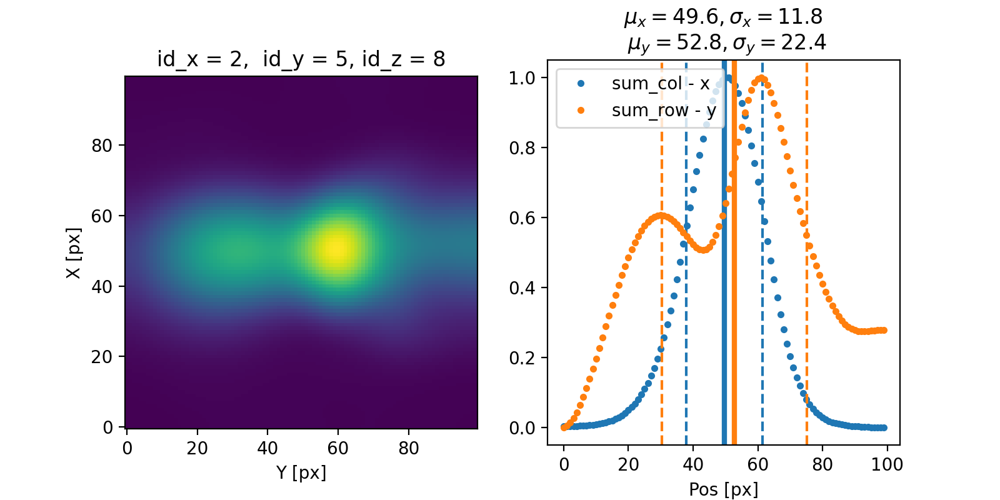

<IPython.core.display.Javascript object>


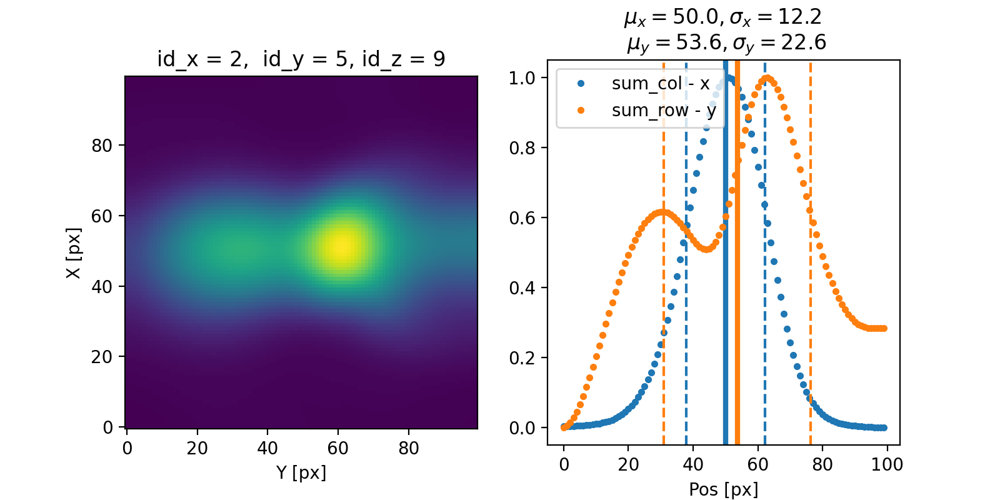

<IPython.core.display.Javascript object>


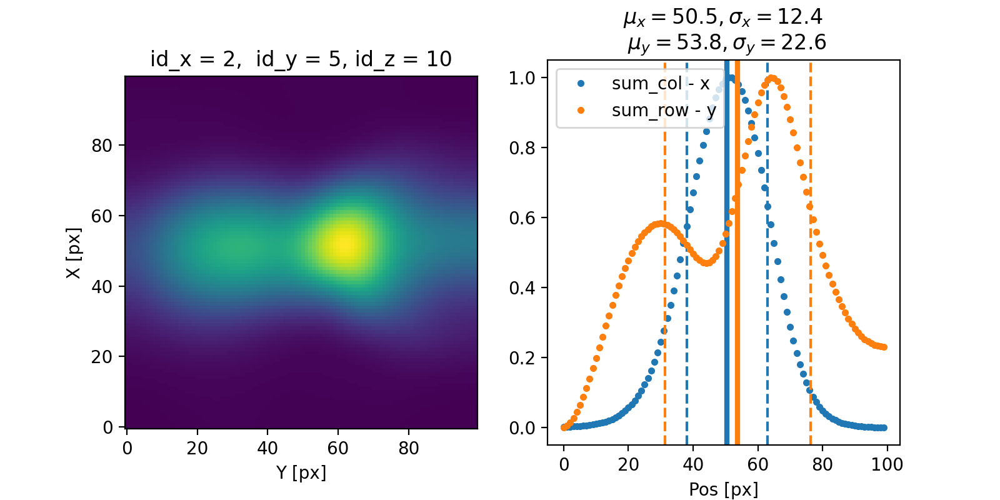

<IPython.core.display.Javascript object>


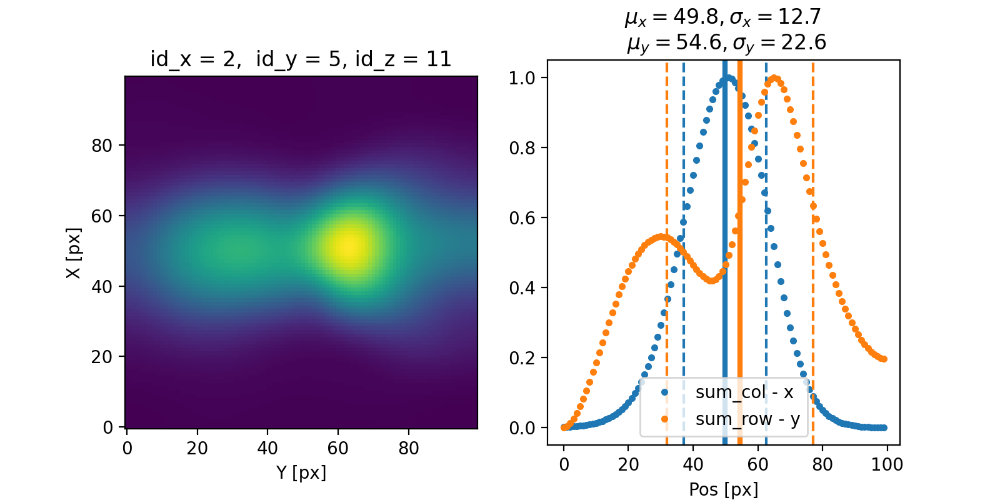

<IPython.core.display.Javascript object>


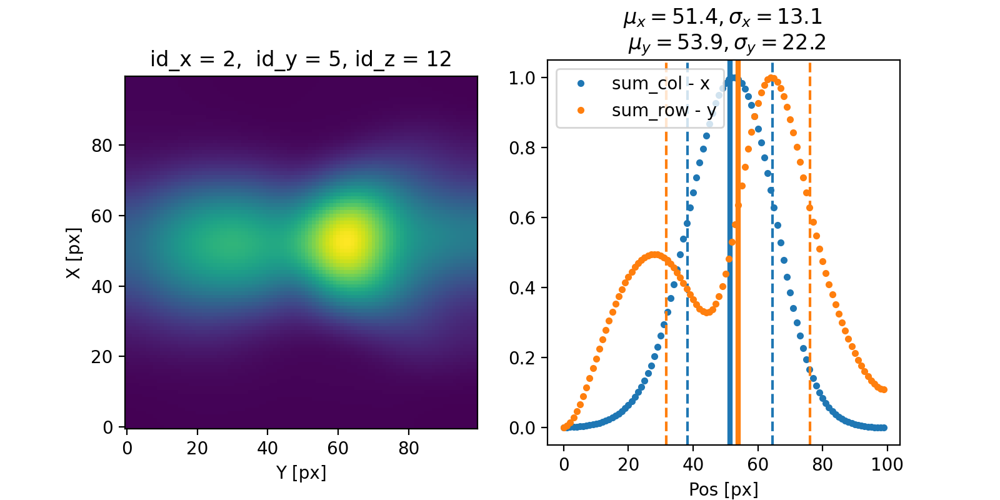

<IPython.core.display.Javascript object>


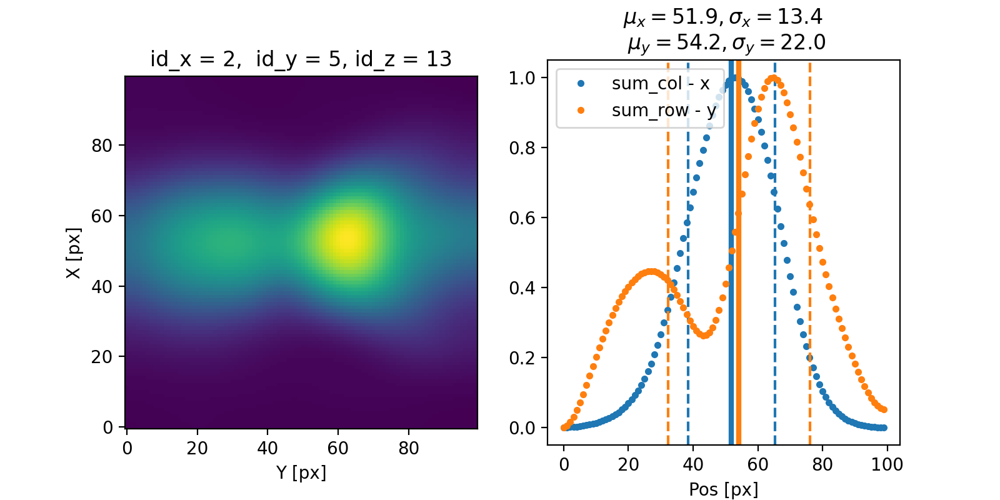

<IPython.core.display.Javascript object>


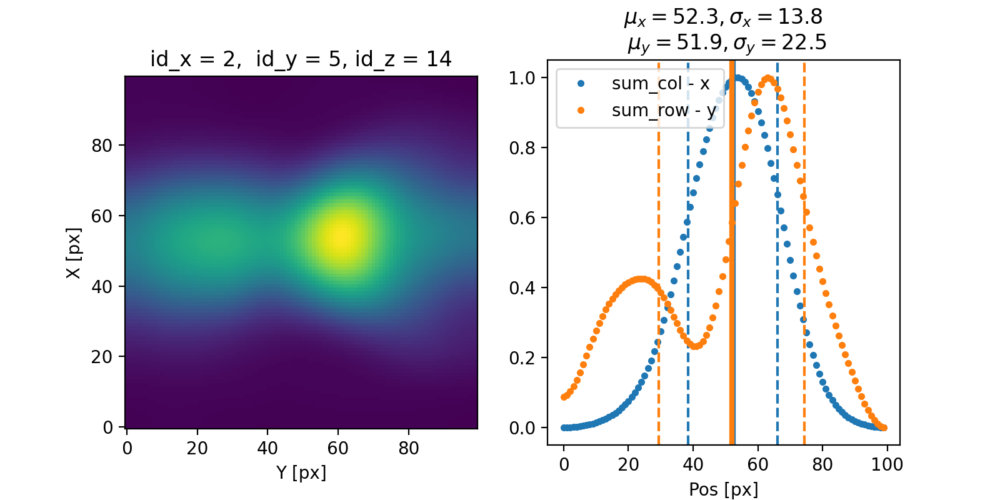

<IPython.core.display.Javascript object>


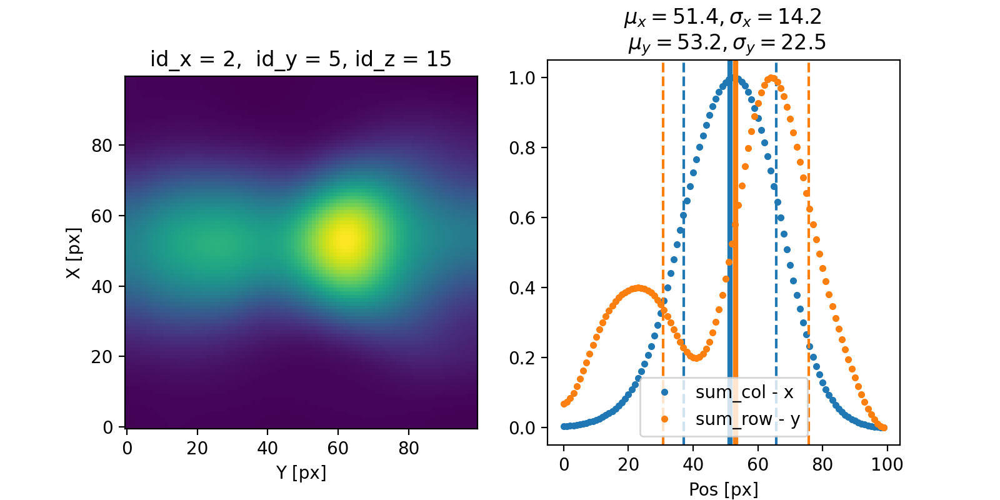

<IPython.core.display.Javascript object>


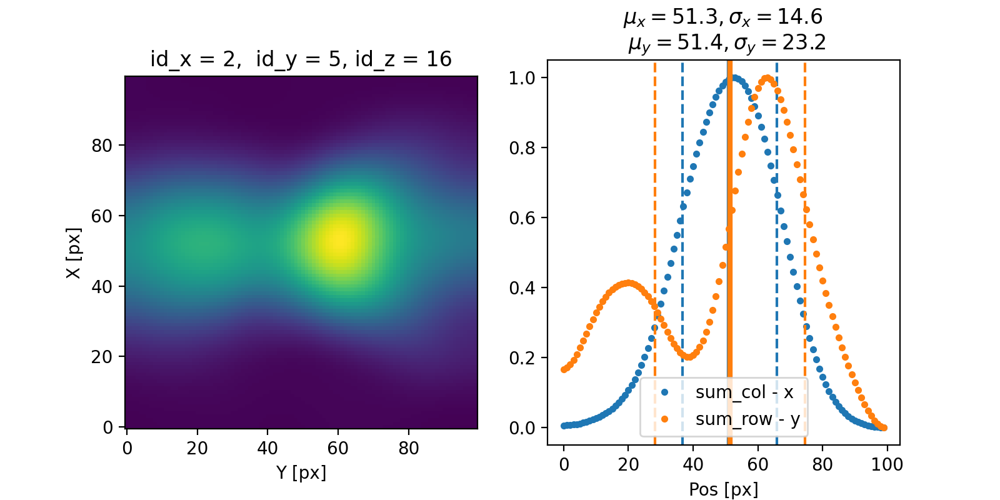

<IPython.core.display.Javascript object>


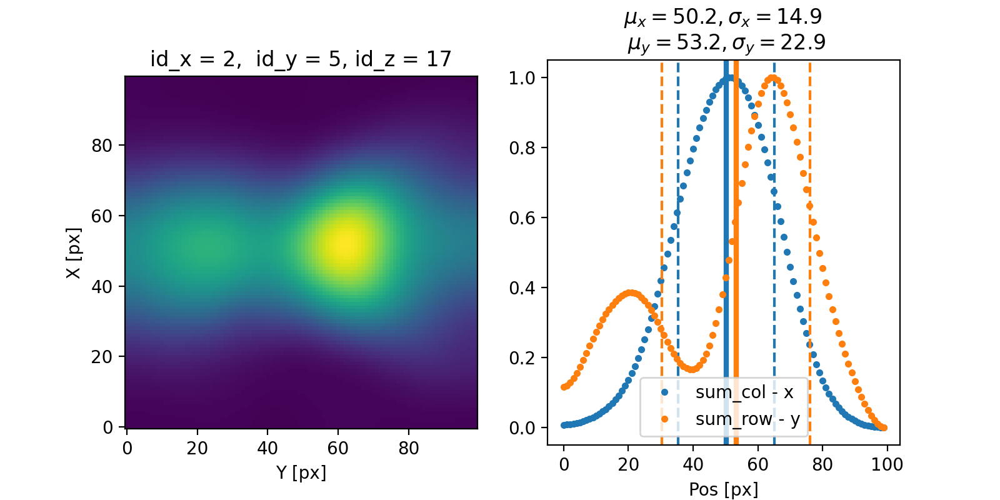

<IPython.core.display.Javascript object>


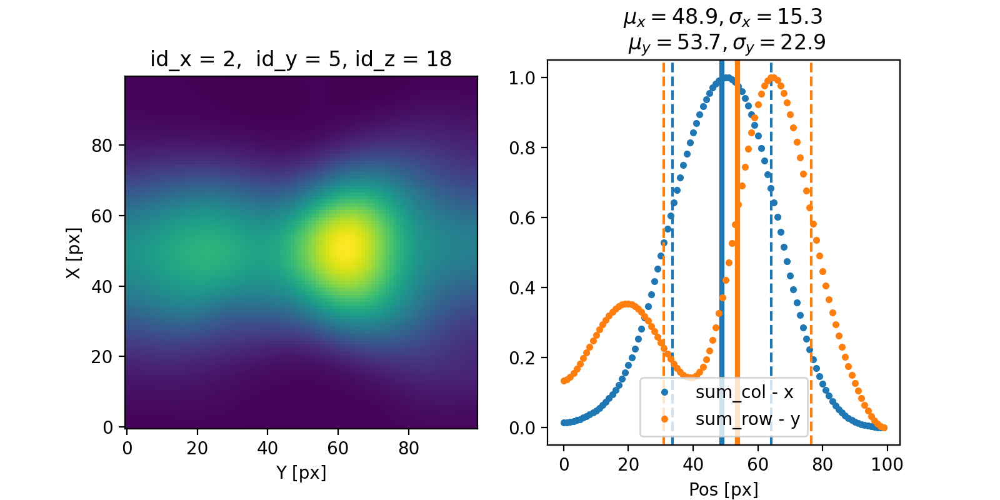

<IPython.core.display.Javascript object>


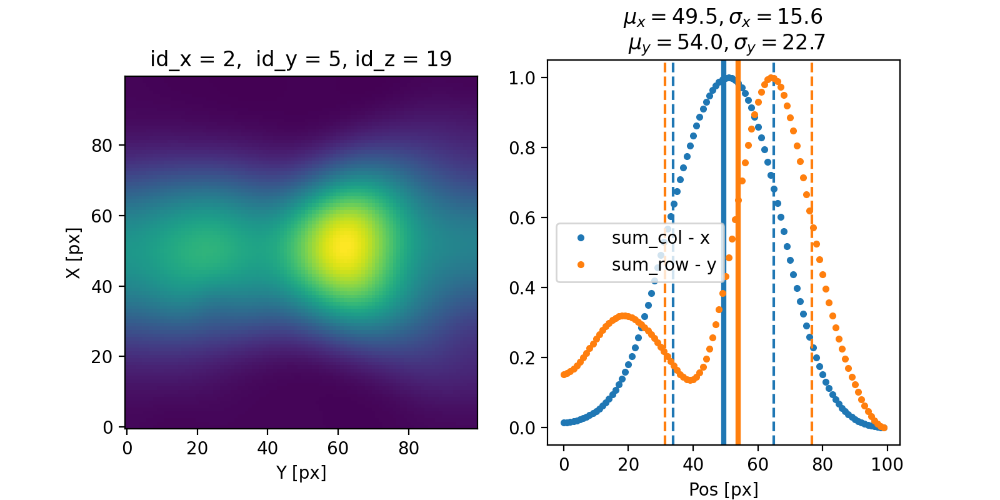

<IPython.core.display.Javascript object>


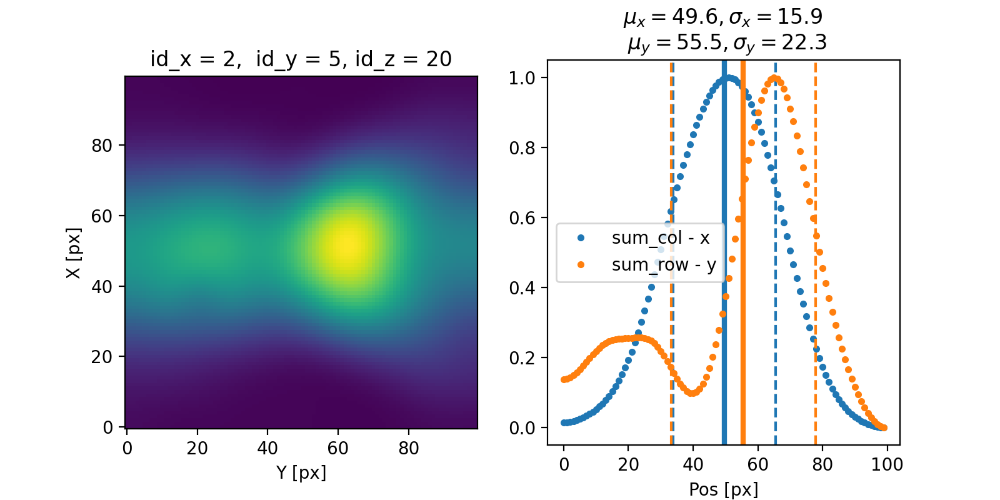

<IPython.core.display.Javascript object>


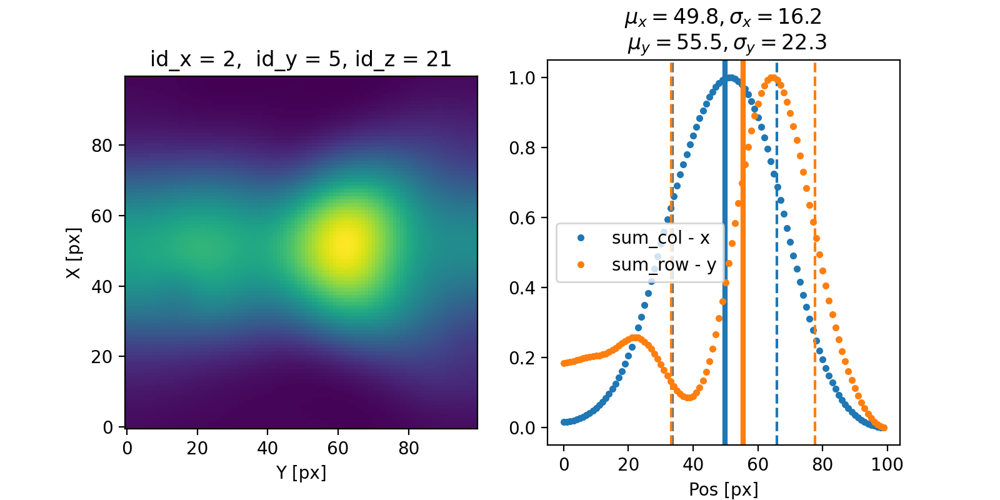

<IPython.core.display.Javascript object>


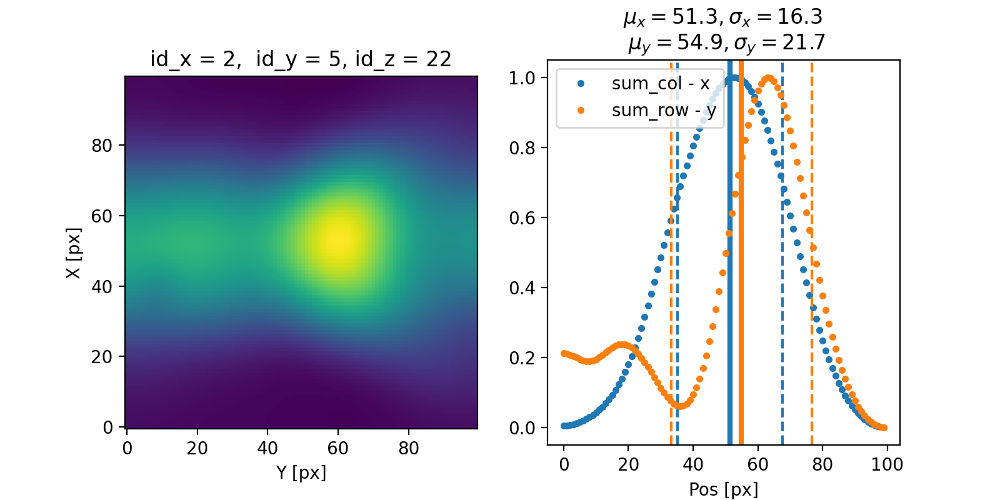

<IPython.core.display.Javascript object>


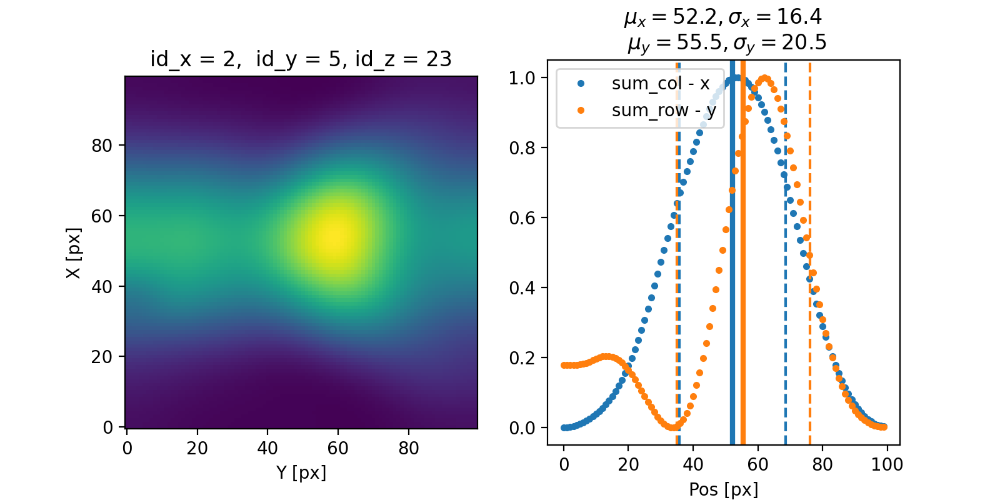

<IPython.core.display.Javascript object>


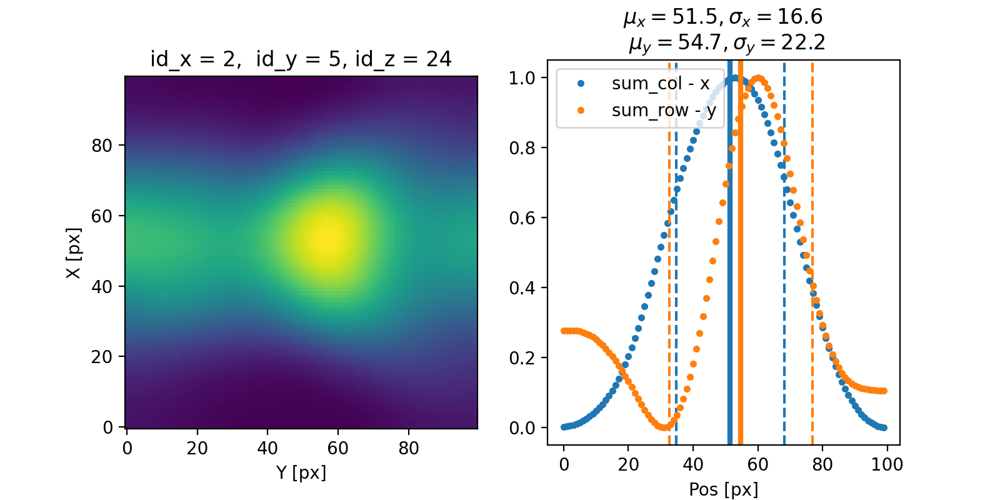

<IPython.core.display.Javascript object>


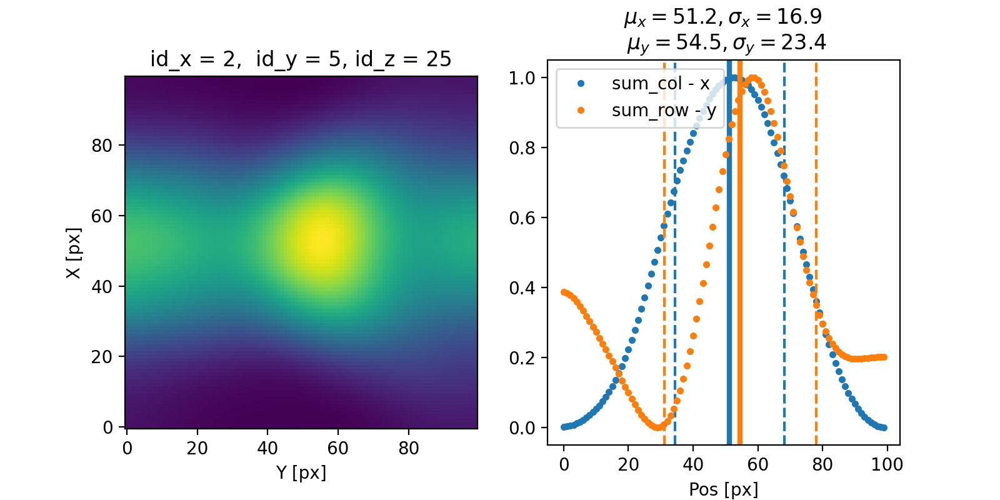

<IPython.core.display.Javascript object>


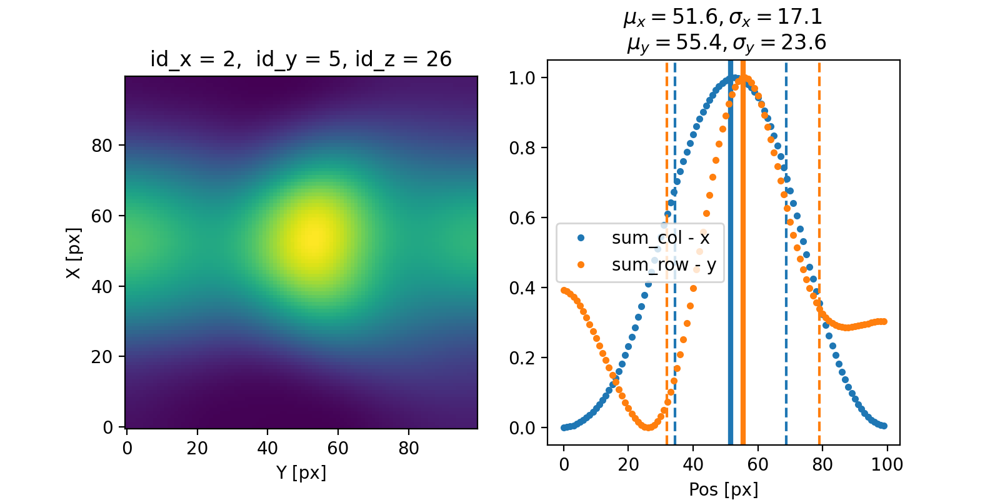

<IPython.core.display.Javascript object>


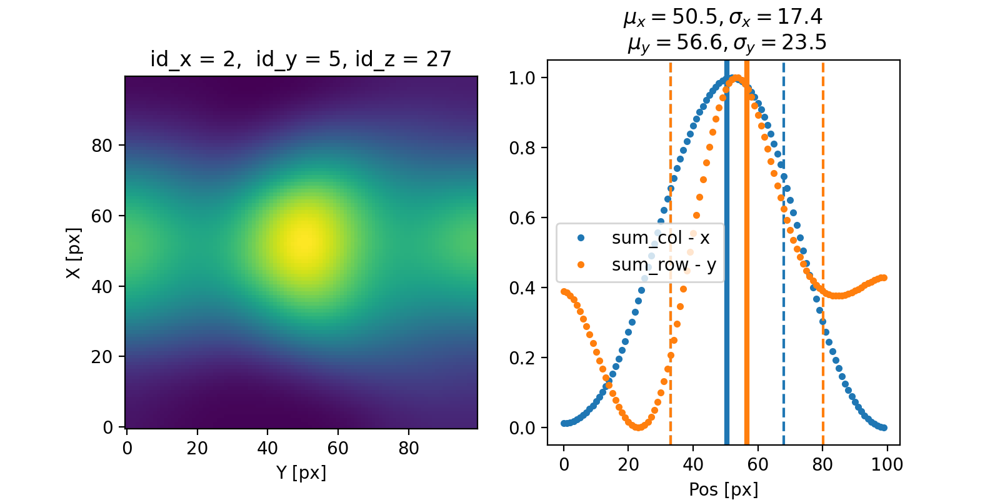

<IPython.core.display.Javascript object>


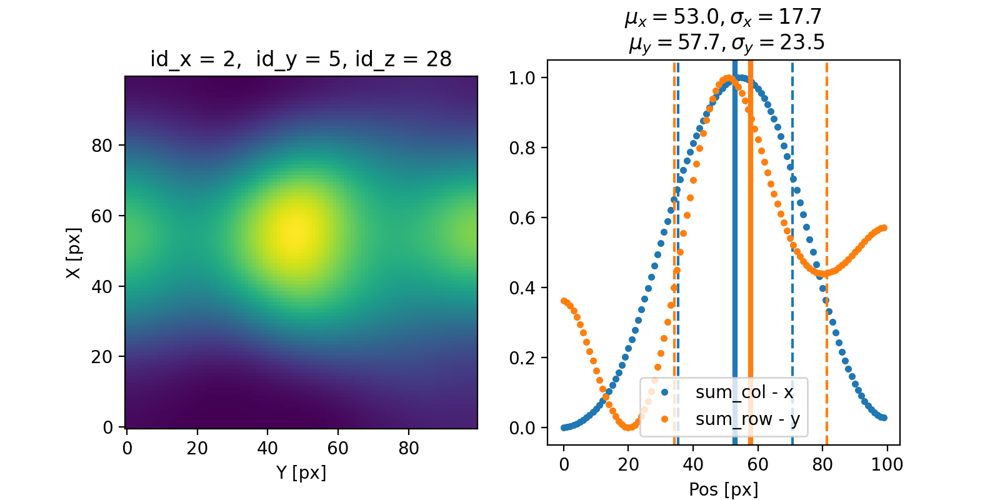

<IPython.core.display.Javascript object>


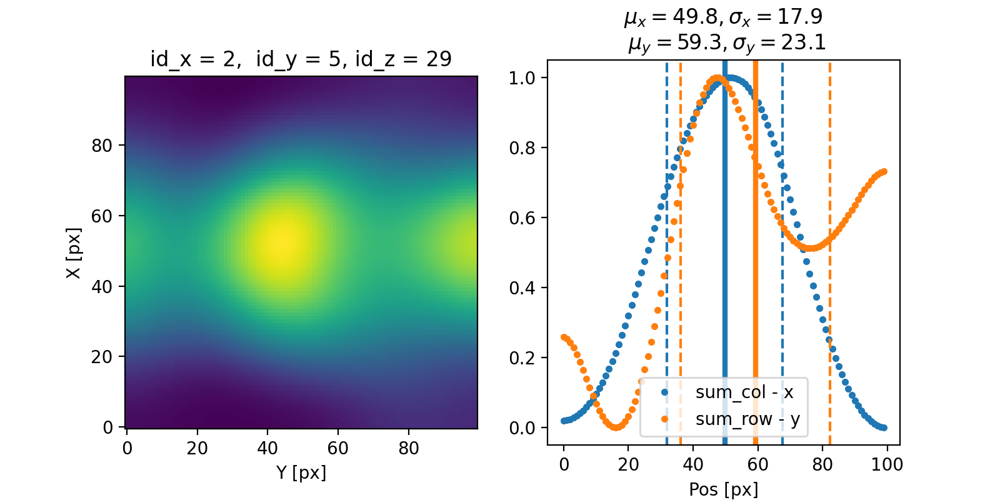

<IPython.core.display.Javascript object>


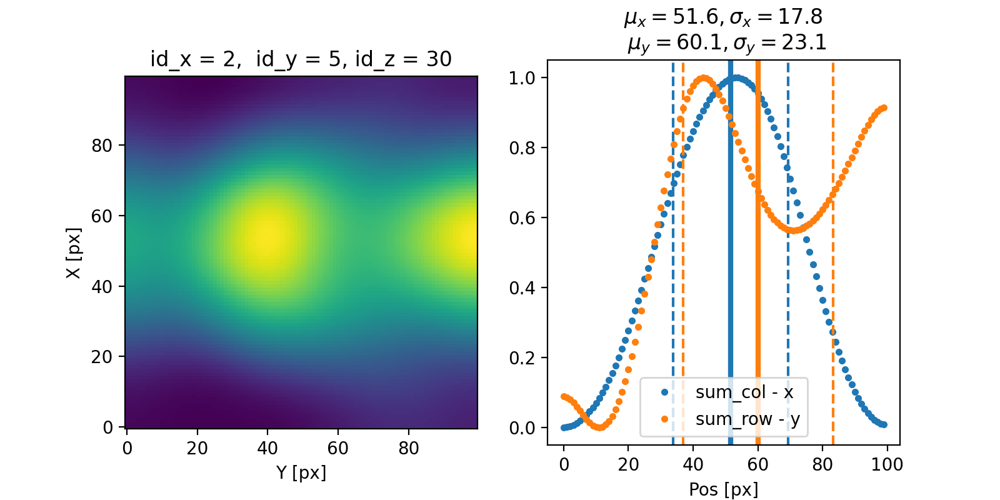

<IPython.core.display.Javascript object>


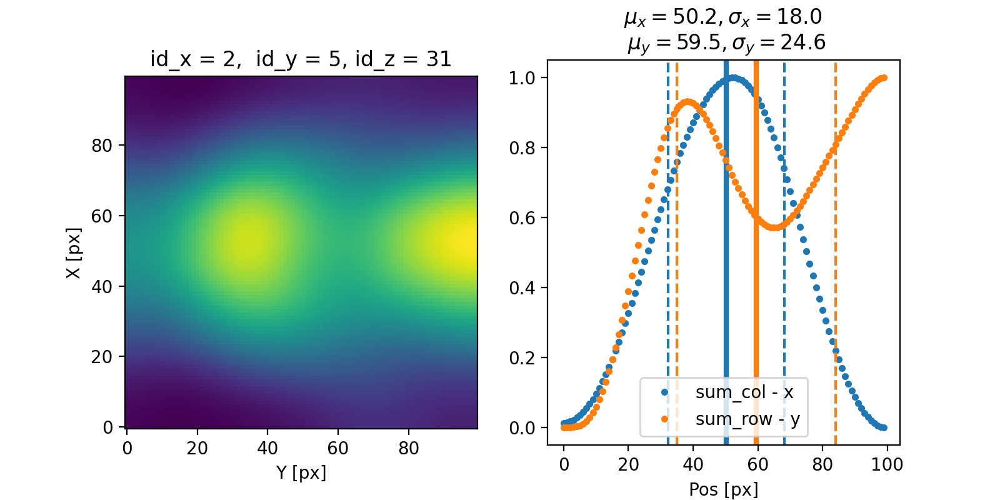

<IPython.core.display.Javascript object>


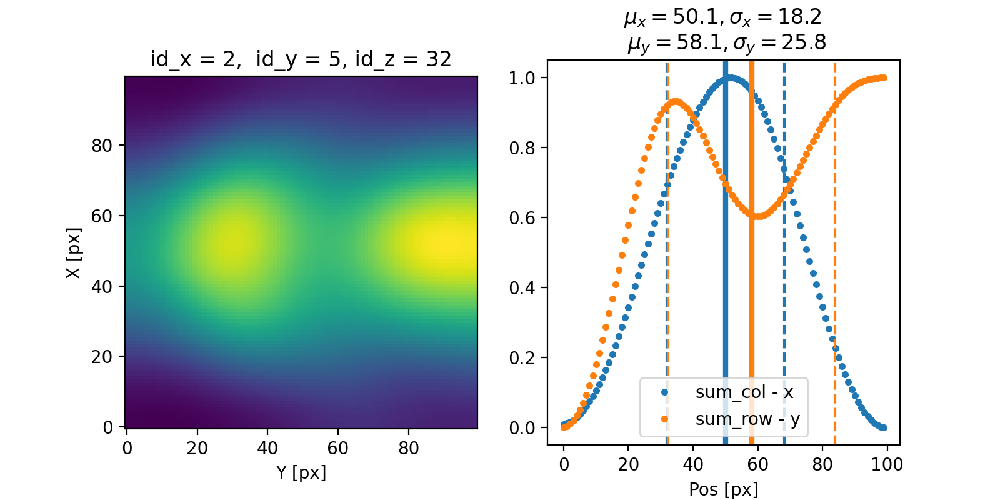

<IPython.core.display.Javascript object>


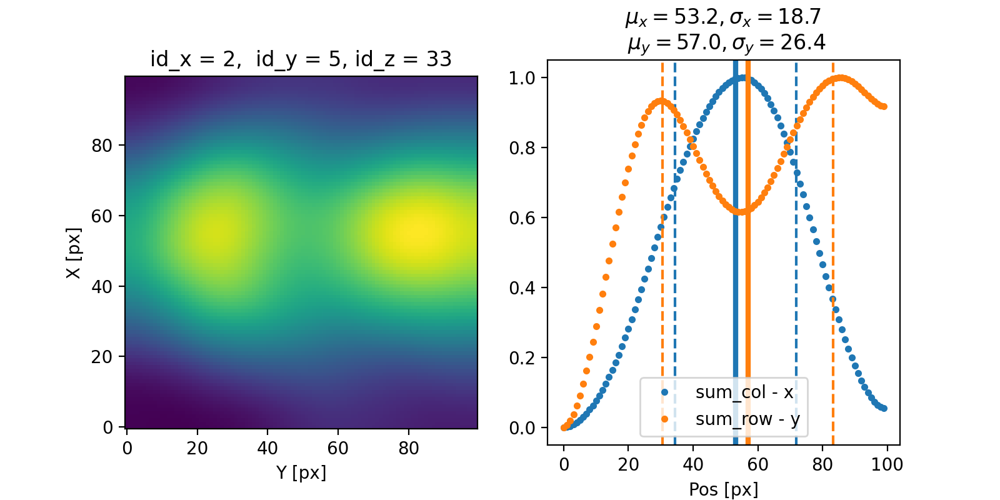

<IPython.core.display.Javascript object>


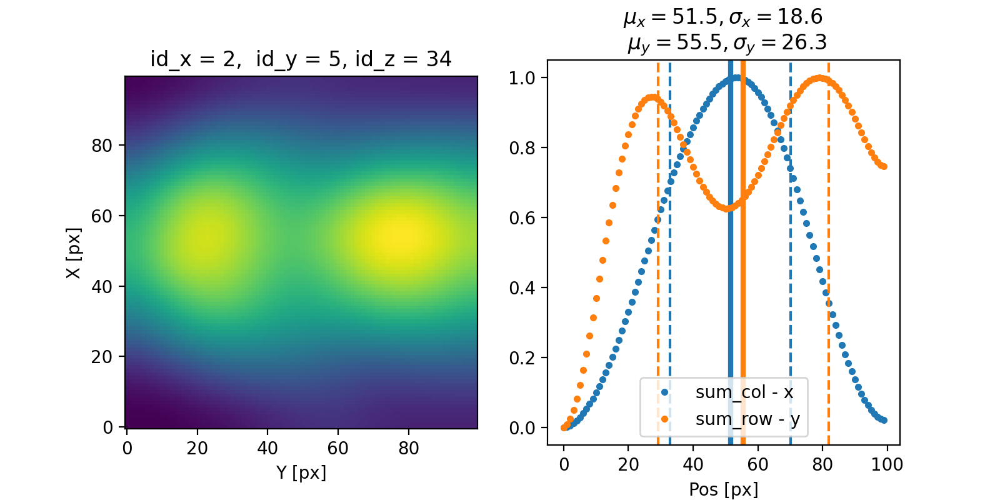

<IPython.core.display.Javascript object>


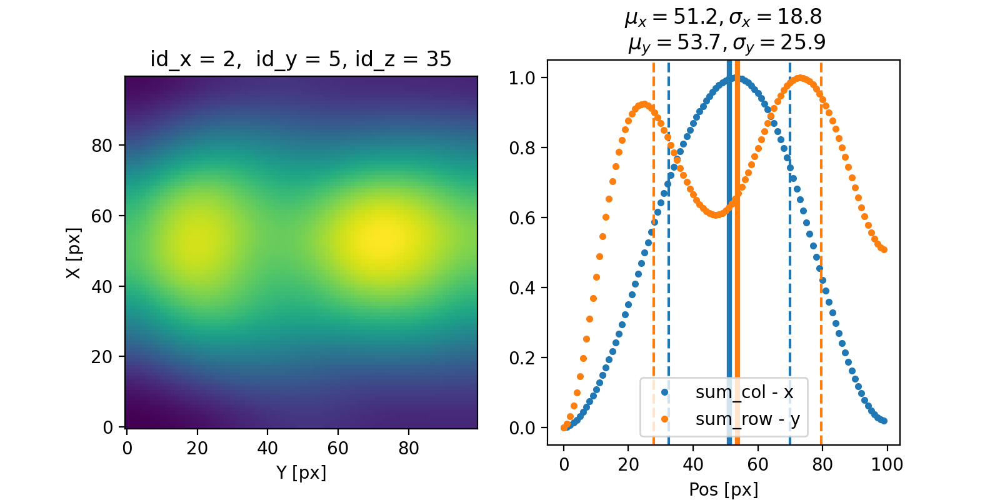

<IPython.core.display.Javascript object>


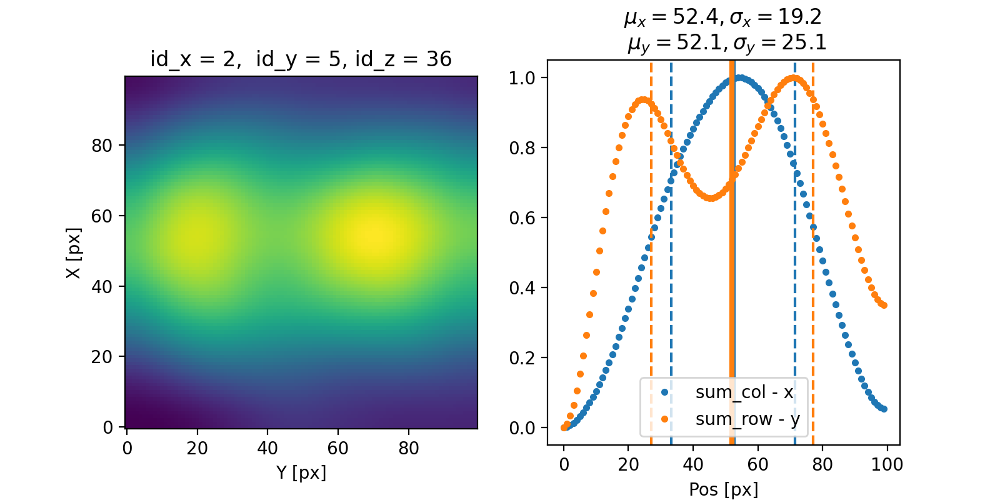

<IPython.core.display.Javascript object>


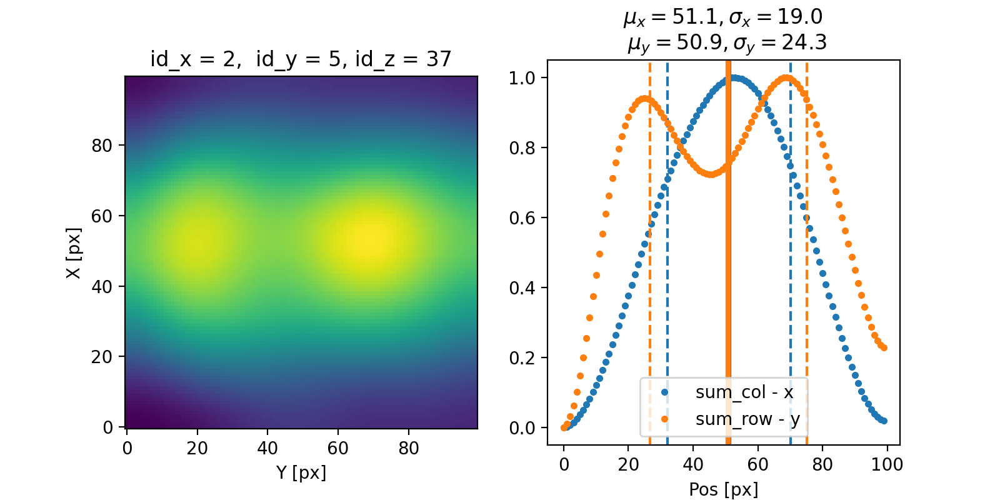

<IPython.core.display.Javascript object>


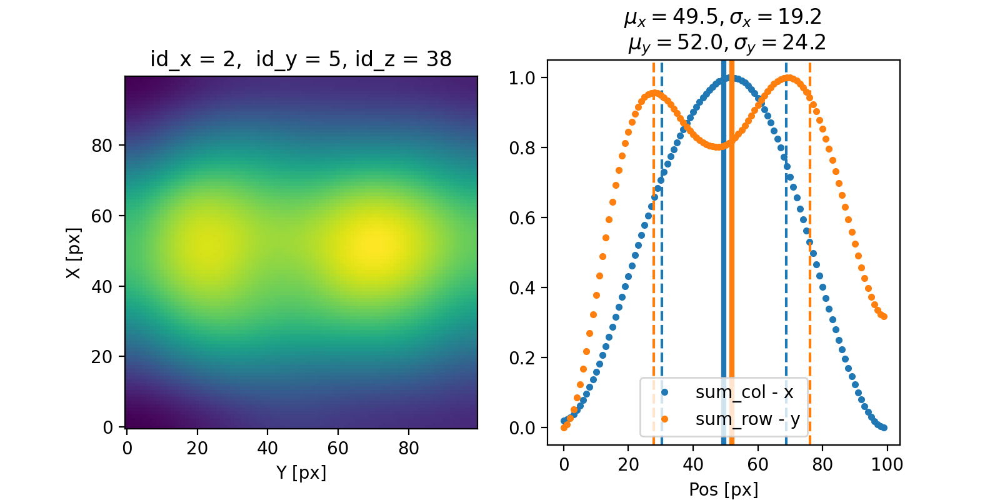

<IPython.core.display.Javascript object>


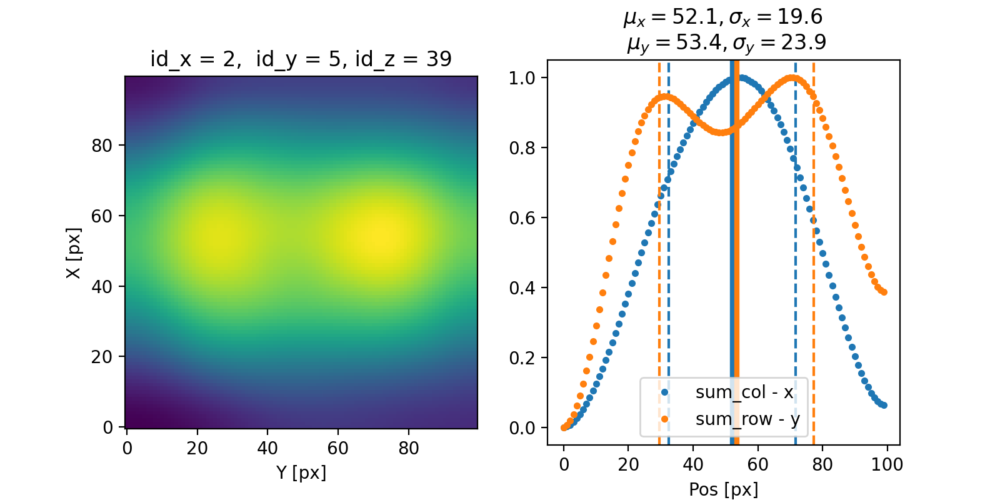

In [5]:
id_x = 2
id_y = 5
beam_i =tomo.beam_l[id_x][id_y]
beam_i.plot_beam_params(limit_z_fit = False,)

## Plot cross sections

In [ ]:
#for i in range(tomo.n_sections):
for i in range(len(tomo.cross_sect_l)):
    tomo.plot_cross_section(i)


In [ ]:
tomo.plot_cross_section(0)

# Extract beam parameters (tilt_x, tilt_y, div_x, div_y) 

## All beams - find direction cosines and divergence 

Tomo.max_z_fit and Tomo.max_z_idx_fit have been updated.
beam_i.max_z_fit and beam_i.max_z_idx_fit have been updated in all beams.
The fit is limited to the useful cross sections, defined by tomo.set_max_z()
The direction cosines of the beam idx=0, idy = 0 have been updated:
e_x = 0.007, e_y = 0.087, e_z = 0.996


<IPython.core.display.Javascript object>


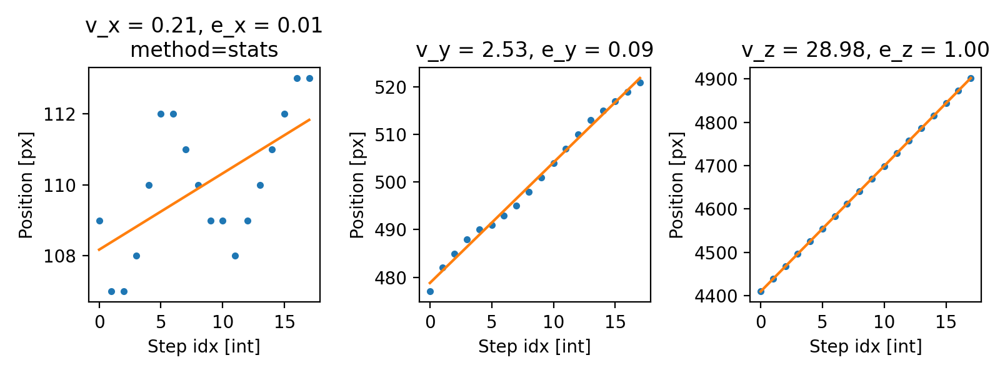

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 85.00deg
e_z = 1.00 --> gamma = 5.02deg
The direction cosines of the beam idx=0, idy = 1 have been updated:
e_x = 0.007, e_y = 0.087, e_z = 0.996


<IPython.core.display.Javascript object>


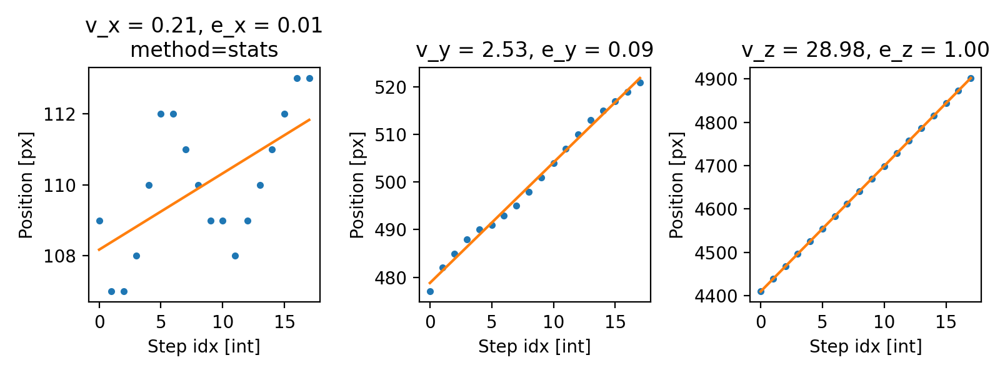

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 85.00deg
e_z = 1.00 --> gamma = 5.02deg
The direction cosines of the beam idx=0, idy = 2 have been updated:
e_x = 0.007, e_y = 0.087, e_z = 0.996


<IPython.core.display.Javascript object>


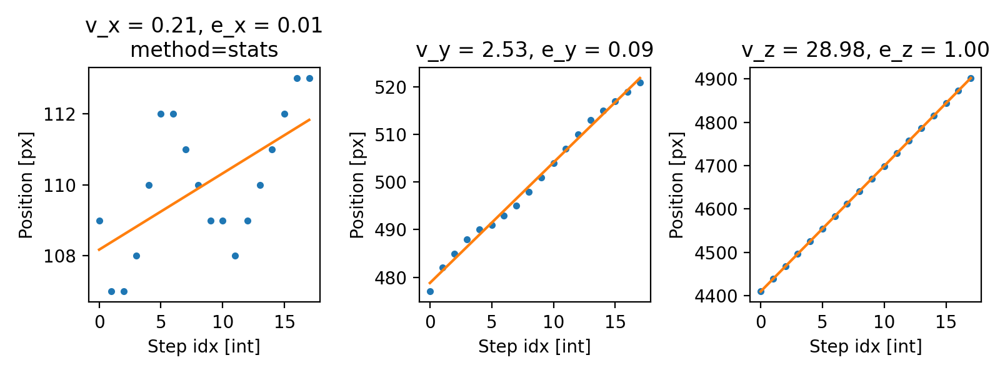

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 85.00deg
e_z = 1.00 --> gamma = 5.02deg
The direction cosines of the beam idx=0, idy = 3 have been updated:
e_x = 0.007, e_y = 0.087, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 85.00deg
e_z = 1.00 --> gamma = 5.02deg
The direction cosines of the beam idx=0, idy = 4 have been updated:
e_x = 0.010, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.45deg
e_y = 0.09 --> beta = 84.71deg
e_z = 1.00 --> gamma = 5.32deg
The direction cosines of the beam idx=0, idy = 5 have been updated:
e_x = 0.009, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.46deg
e_y = 0.09 --> beta = 84.71deg
e_z = 1.00 --> gamma = 5.32deg
The direction cosines of the beam idx=0, idy = 6 have been updated:
e_x = 0.012, e_y = 0.106, e_z = 0.994


<IPython.core.display.Javascript object>


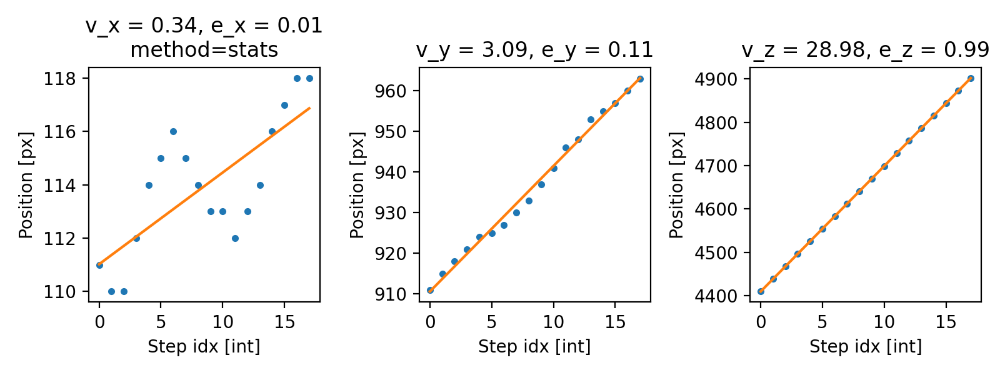

e_x = 0.01 --> alpha = 89.32deg
e_y = 0.11 --> beta = 83.92deg
e_z = 0.99 --> gamma = 6.12deg
The direction cosines of the beam idx=0, idy = 7 have been updated:
e_x = 0.008, e_y = 0.134, e_z = 0.991


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.55deg
e_y = 0.13 --> beta = 82.32deg
e_z = 0.99 --> gamma = 7.69deg
The direction cosines of the beam idx=1, idy = 0 have been updated:
e_x = 0.009, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.51deg
e_y = 0.09 --> beta = 84.74deg
e_z = 1.00 --> gamma = 5.29deg
The direction cosines of the beam idx=1, idy = 1 have been updated:
e_x = 0.009, e_y = 0.092, e_z = 0.996


/Users/rui/Documents/GitHub/beam_tomography/beam_tomo_analyse.py:949: RuntimeWarning: More than 50 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax = plt.subplots(nrows=1, ncols=3, figsize=(8, 3))


<IPython.core.display.Javascript object>


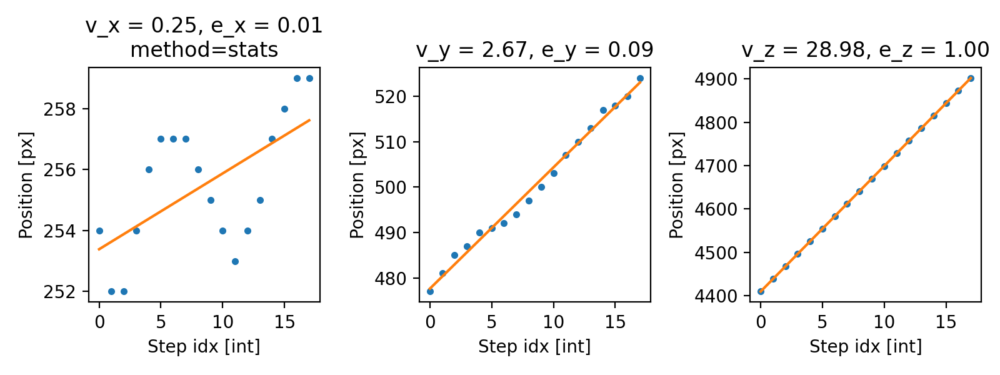

e_x = 0.01 --> alpha = 89.51deg
e_y = 0.09 --> beta = 84.74deg
e_z = 1.00 --> gamma = 5.29deg
The direction cosines of the beam idx=1, idy = 2 have been updated:
e_x = 0.009, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.51deg
e_y = 0.09 --> beta = 84.74deg
e_z = 1.00 --> gamma = 5.29deg
The direction cosines of the beam idx=1, idy = 3 have been updated:
e_x = 0.009, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.51deg
e_y = 0.09 --> beta = 84.74deg
e_z = 1.00 --> gamma = 5.29deg
The direction cosines of the beam idx=1, idy = 4 have been updated:
e_x = 0.009, e_y = 0.082, e_z = 0.997


<IPython.core.display.Javascript object>


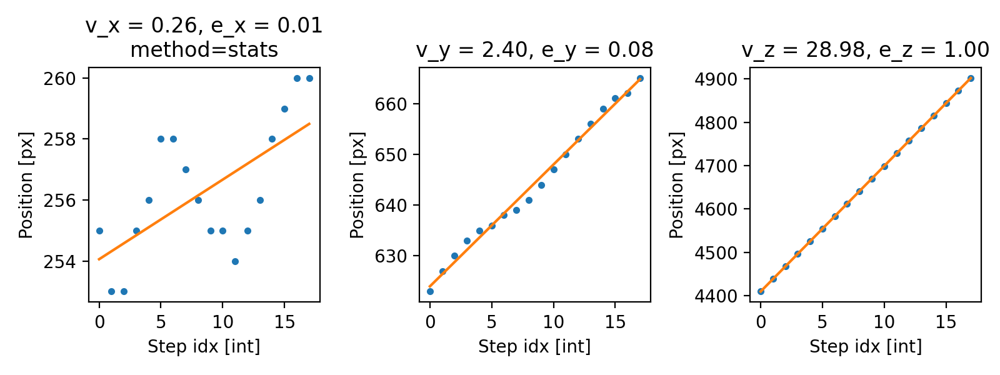

e_x = 0.01 --> alpha = 89.49deg
e_y = 0.08 --> beta = 85.27deg
e_z = 1.00 --> gamma = 4.76deg
The direction cosines of the beam idx=1, idy = 5 have been updated:
e_x = 0.010, e_y = 0.096, e_z = 0.995


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.41deg
e_y = 0.10 --> beta = 84.47deg
e_z = 1.00 --> gamma = 5.57deg
The direction cosines of the beam idx=1, idy = 6 have been updated:
e_x = 0.012, e_y = 0.103, e_z = 0.995


<IPython.core.display.Javascript object>


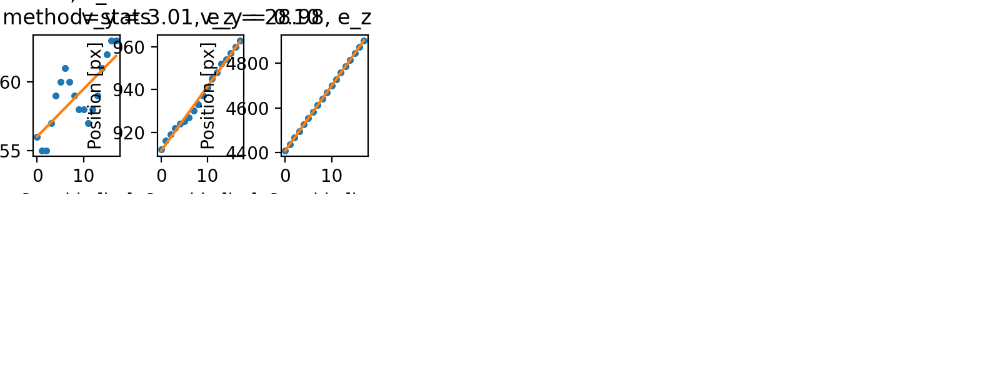

e_x = 0.01 --> alpha = 89.32deg
e_y = 0.10 --> beta = 84.08deg
e_z = 0.99 --> gamma = 5.96deg
The direction cosines of the beam idx=1, idy = 7 have been updated:
e_x = 0.007, e_y = 0.130, e_z = 0.992


<IPython.core.display.Javascript object>


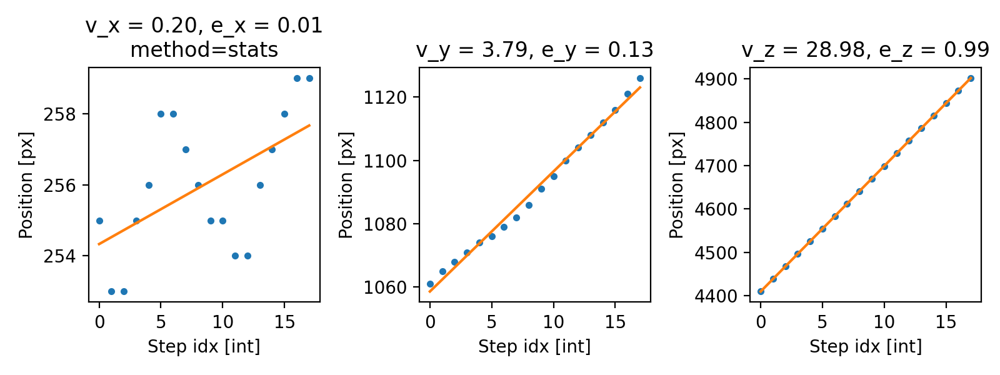

e_x = 0.01 --> alpha = 89.62deg
e_y = 0.13 --> beta = 82.55deg
e_z = 0.99 --> gamma = 7.46deg
The direction cosines of the beam idx=2, idy = 0 have been updated:
e_x = 0.007, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 84.72deg
e_z = 1.00 --> gamma = 5.30deg
The direction cosines of the beam idx=2, idy = 1 have been updated:
e_x = 0.007, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 84.72deg
e_z = 1.00 --> gamma = 5.30deg
The direction cosines of the beam idx=2, idy = 2 have been updated:
e_x = 0.007, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>


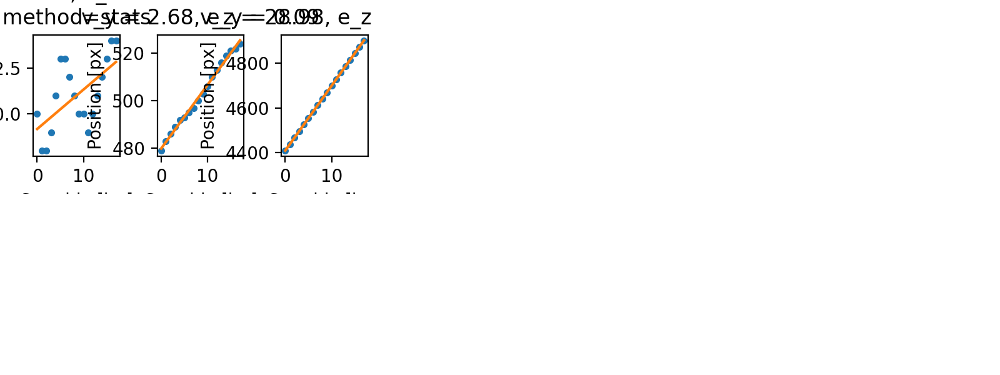

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 84.72deg
e_z = 1.00 --> gamma = 5.30deg
The direction cosines of the beam idx=2, idy = 3 have been updated:
e_x = 0.007, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.58deg
e_y = 0.09 --> beta = 84.72deg
e_z = 1.00 --> gamma = 5.30deg
The direction cosines of the beam idx=2, idy = 4 have been updated:
e_x = 0.010, e_y = 0.130, e_z = 0.992


<IPython.core.display.Javascript object>


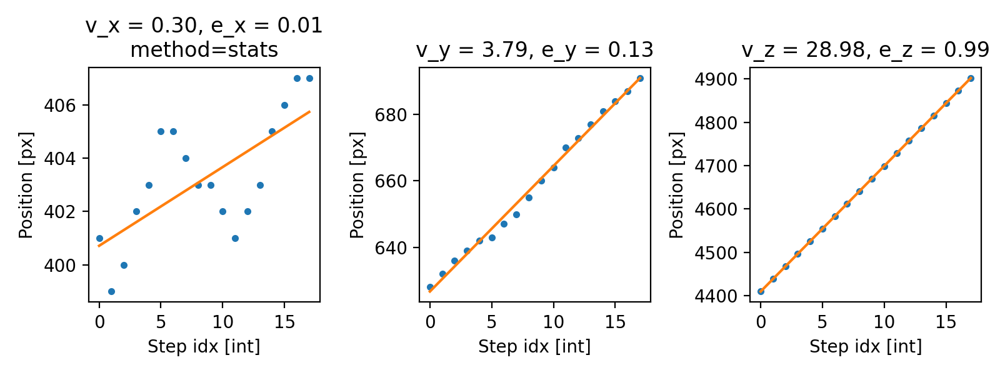

e_x = 0.01 --> alpha = 89.42deg
e_y = 0.13 --> beta = 82.56deg
e_z = 0.99 --> gamma = 7.47deg
The direction cosines of the beam idx=2, idy = 5 have been updated:
e_x = 0.010, e_y = 0.090, e_z = 0.996


<IPython.core.display.Javascript object>


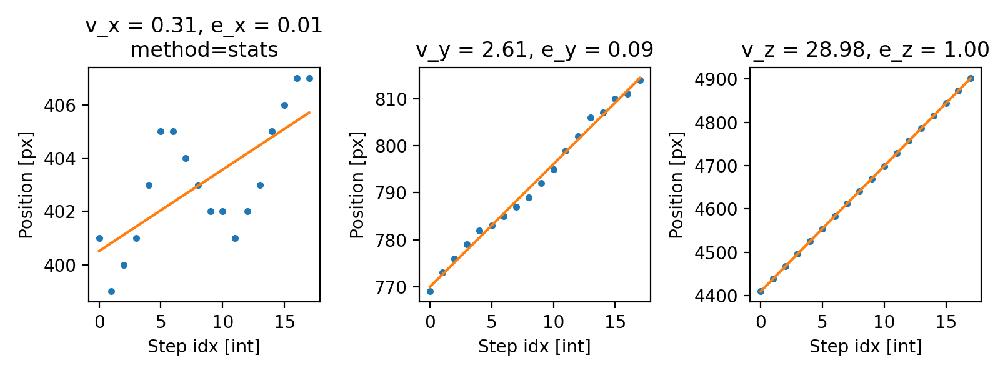

e_x = 0.01 --> alpha = 89.40deg
e_y = 0.09 --> beta = 84.85deg
e_z = 1.00 --> gamma = 5.18deg
The direction cosines of the beam idx=2, idy = 6 have been updated:
e_x = 0.012, e_y = 0.114, e_z = 0.993


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.33deg
e_y = 0.11 --> beta = 83.44deg
e_z = 0.99 --> gamma = 6.60deg
The direction cosines of the beam idx=2, idy = 7 have been updated:
e_x = 0.008, e_y = 0.135, e_z = 0.991


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.52deg
e_y = 0.14 --> beta = 82.24deg
e_z = 0.99 --> gamma = 7.78deg
The direction cosines of the beam idx=3, idy = 0 have been updated:
e_x = 0.004, e_y = 0.148, e_z = 0.989


<IPython.core.display.Javascript object>


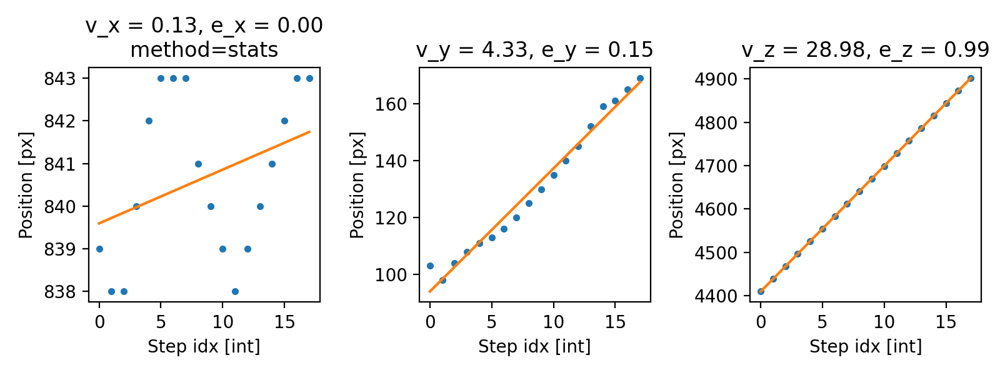

e_x = 0.00 --> alpha = 89.75deg
e_y = 0.15 --> beta = 81.51deg
e_z = 0.99 --> gamma = 8.49deg
The direction cosines of the beam idx=3, idy = 1 have been updated:
e_x = 0.008, e_y = 0.097, e_z = 0.995


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.53deg
e_y = 0.10 --> beta = 84.44deg
e_z = 1.00 --> gamma = 5.58deg
The direction cosines of the beam idx=3, idy = 2 have been updated:
e_x = 0.008, e_y = 0.097, e_z = 0.995


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.53deg
e_y = 0.10 --> beta = 84.44deg
e_z = 1.00 --> gamma = 5.58deg
The direction cosines of the beam idx=3, idy = 3 have been updated:
e_x = 0.008, e_y = 0.097, e_z = 0.995


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.53deg
e_y = 0.10 --> beta = 84.44deg
e_z = 1.00 --> gamma = 5.58deg
The direction cosines of the beam idx=3, idy = 4 have been updated:
e_x = 0.011, e_y = 0.086, e_z = 0.996


<IPython.core.display.Javascript object>


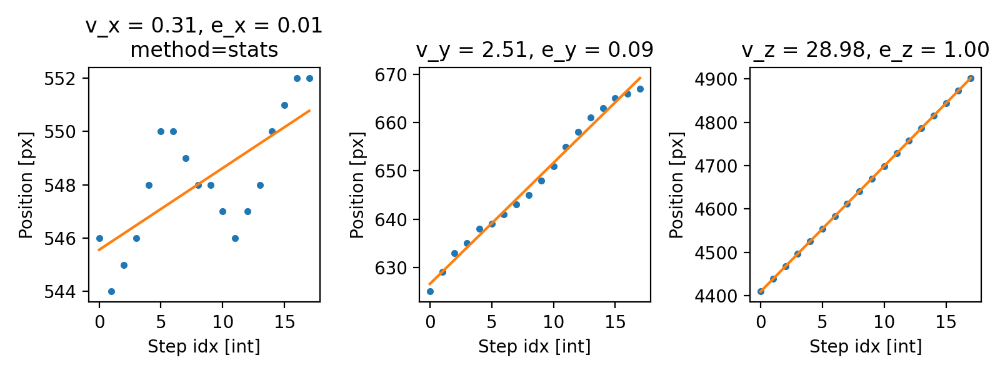

e_x = 0.01 --> alpha = 89.40deg
e_y = 0.09 --> beta = 85.05deg
e_z = 1.00 --> gamma = 4.98deg
The direction cosines of the beam idx=3, idy = 5 have been updated:
e_x = 0.010, e_y = 0.085, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.44deg
e_y = 0.08 --> beta = 85.13deg
e_z = 1.00 --> gamma = 4.90deg
The direction cosines of the beam idx=3, idy = 6 have been updated:
e_x = 0.012, e_y = 0.112, e_z = 0.994


<IPython.core.display.Javascript object>


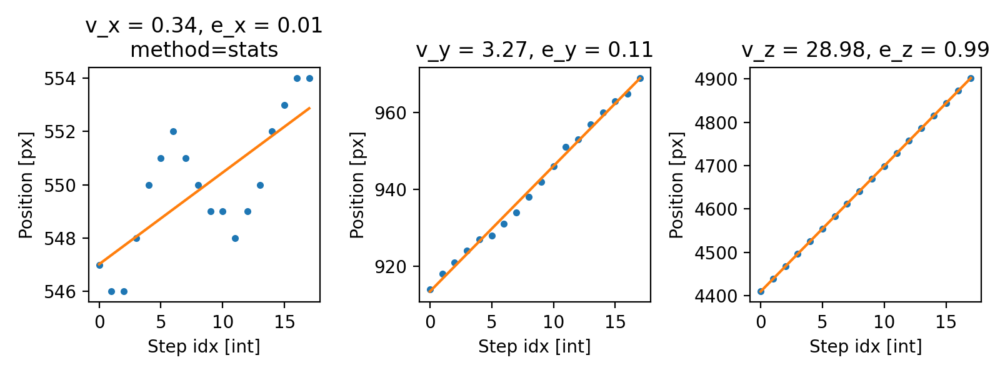

e_x = 0.01 --> alpha = 89.32deg
e_y = 0.11 --> beta = 83.57deg
e_z = 0.99 --> gamma = 6.47deg
The direction cosines of the beam idx=3, idy = 7 have been updated:
e_x = 0.008, e_y = 0.129, e_z = 0.992


<IPython.core.display.Javascript object>


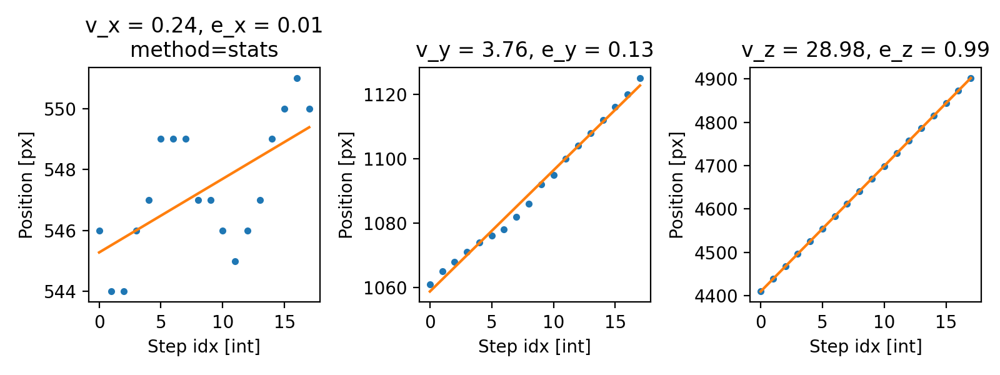

e_x = 0.01 --> alpha = 89.53deg
e_y = 0.13 --> beta = 82.61deg
e_z = 0.99 --> gamma = 7.41deg
The direction cosines of the beam idx=4, idy = 0 have been updated:
e_x = 0.004, e_y = 0.148, e_z = 0.989


<IPython.core.display.Javascript object>

e_x = 0.00 --> alpha = 89.75deg
e_y = 0.15 --> beta = 81.51deg
e_z = 0.99 --> gamma = 8.49deg
The direction cosines of the beam idx=4, idy = 1 have been updated:
e_x = 0.012, e_y = 0.101, e_z = 0.995


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.34deg
e_y = 0.10 --> beta = 84.19deg
e_z = 0.99 --> gamma = 5.85deg
The direction cosines of the beam idx=4, idy = 2 have been updated:
e_x = 0.012, e_y = 0.101, e_z = 0.995


<IPython.core.display.Javascript object>


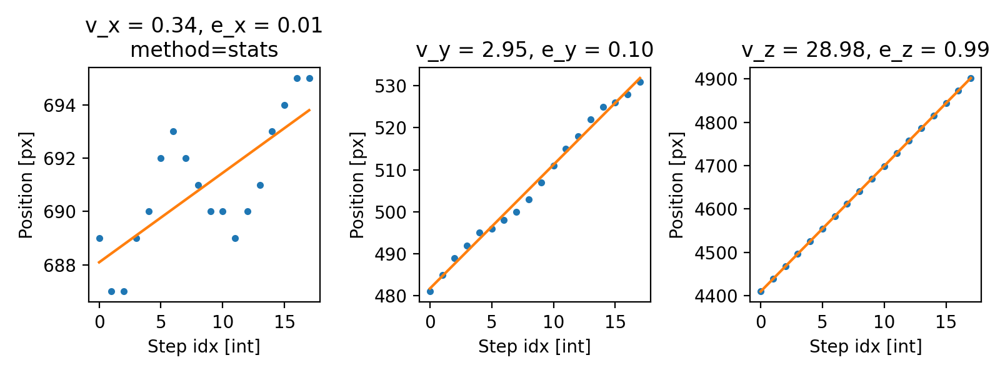

e_x = 0.01 --> alpha = 89.34deg
e_y = 0.10 --> beta = 84.19deg
e_z = 0.99 --> gamma = 5.85deg
The direction cosines of the beam idx=4, idy = 3 have been updated:
e_x = 0.012, e_y = 0.101, e_z = 0.995


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.34deg
e_y = 0.10 --> beta = 84.19deg
e_z = 0.99 --> gamma = 5.85deg
The direction cosines of the beam idx=4, idy = 4 have been updated:
e_x = 0.009, e_y = 0.095, e_z = 0.995


<IPython.core.display.Javascript object>


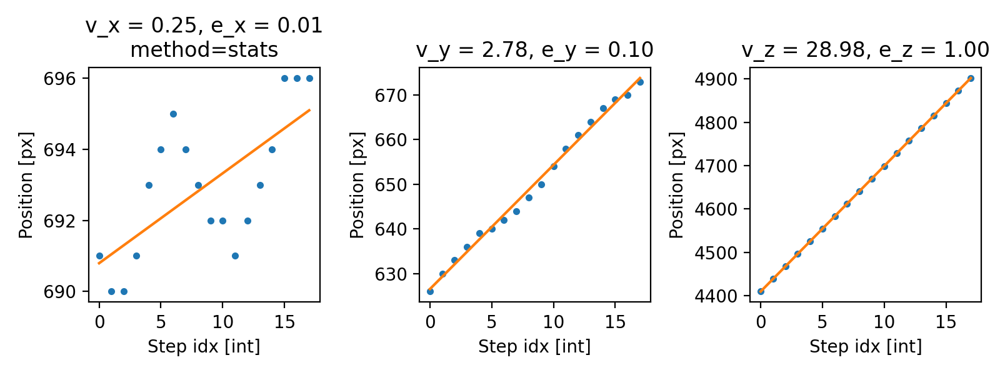

e_x = 0.01 --> alpha = 89.50deg
e_y = 0.10 --> beta = 84.52deg
e_z = 1.00 --> gamma = 5.50deg
The direction cosines of the beam idx=4, idy = 5 have been updated:
e_x = 0.009, e_y = 0.101, e_z = 0.995


<IPython.core.display.Javascript object>


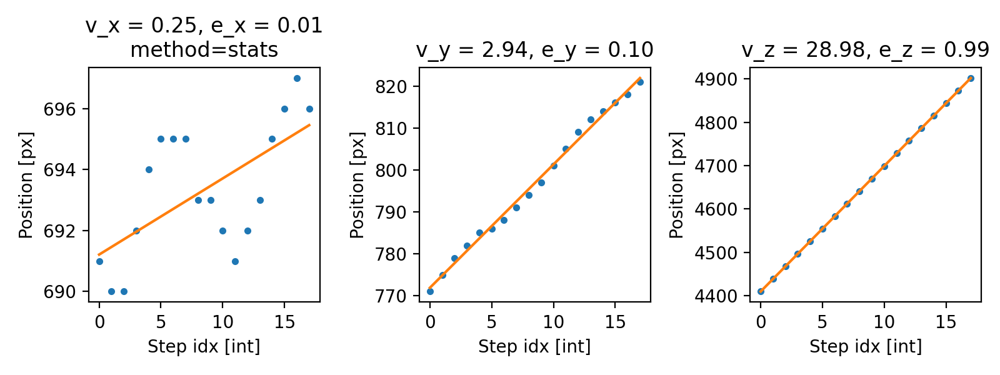

e_x = 0.01 --> alpha = 89.51deg
e_y = 0.10 --> beta = 84.21deg
e_z = 0.99 --> gamma = 5.82deg
The direction cosines of the beam idx=4, idy = 6 have been updated:
e_x = 0.012, e_y = 0.105, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.31deg
e_y = 0.10 --> beta = 83.98deg
e_z = 0.99 --> gamma = 6.06deg
The direction cosines of the beam idx=4, idy = 7 have been updated:
e_x = 0.010, e_y = 0.121, e_z = 0.993


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.45deg
e_y = 0.12 --> beta = 83.04deg
e_z = 0.99 --> gamma = 6.98deg
The direction cosines of the beam idx=5, idy = 0 have been updated:
e_x = 0.004, e_y = 0.148, e_z = 0.989


<IPython.core.display.Javascript object>


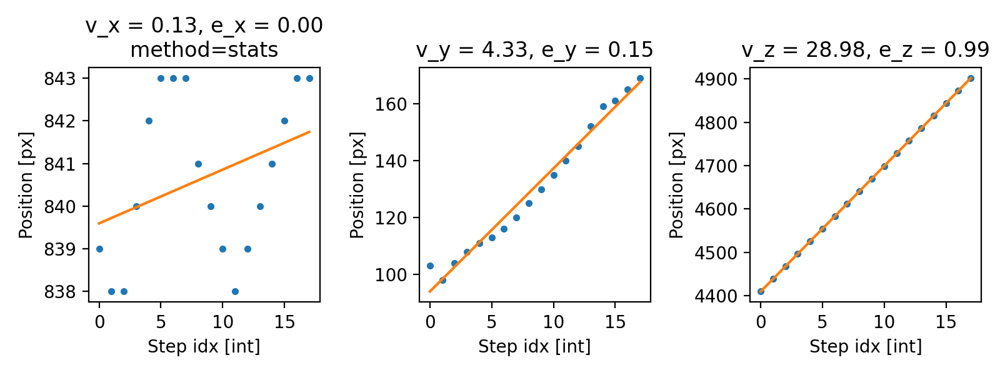

e_x = 0.00 --> alpha = 89.75deg
e_y = 0.15 --> beta = 81.51deg
e_z = 0.99 --> gamma = 8.49deg
The direction cosines of the beam idx=5, idy = 1 have been updated:
e_x = 0.004, e_y = 0.148, e_z = 0.989


<IPython.core.display.Javascript object>

e_x = 0.00 --> alpha = 89.75deg
e_y = 0.15 --> beta = 81.51deg
e_z = 0.99 --> gamma = 8.49deg
The direction cosines of the beam idx=5, idy = 2 have been updated:
e_x = 0.009, e_y = 0.094, e_z = 0.996


<IPython.core.display.Javascript object>


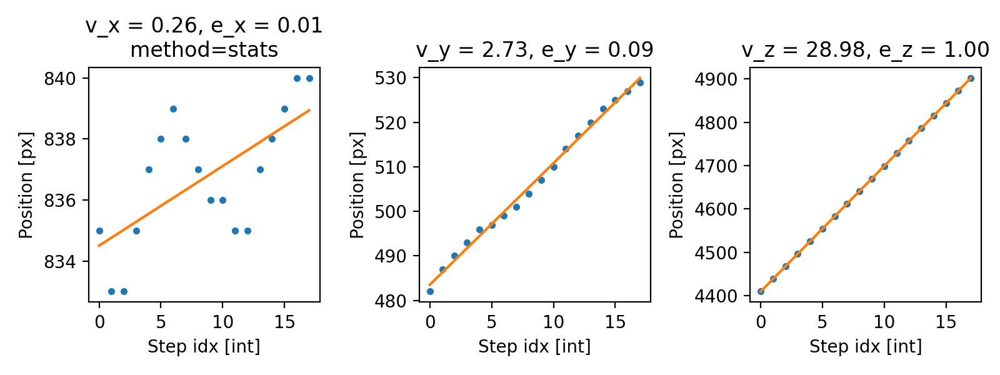

e_x = 0.01 --> alpha = 89.49deg
e_y = 0.09 --> beta = 84.62deg
e_z = 1.00 --> gamma = 5.40deg
The direction cosines of the beam idx=5, idy = 3 have been updated:
e_x = 0.009, e_y = 0.094, e_z = 0.996


<IPython.core.display.Javascript object>


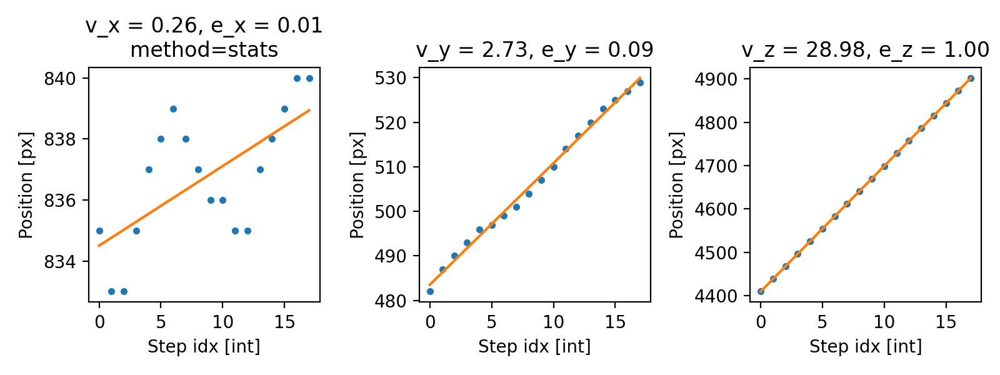

e_x = 0.01 --> alpha = 89.49deg
e_y = 0.09 --> beta = 84.62deg
e_z = 1.00 --> gamma = 5.40deg
The direction cosines of the beam idx=5, idy = 4 have been updated:
e_x = 0.009, e_y = 0.083, e_z = 0.997


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.49deg
e_y = 0.08 --> beta = 85.27deg
e_z = 1.00 --> gamma = 4.76deg
The direction cosines of the beam idx=5, idy = 5 have been updated:
e_x = 0.012, e_y = 0.085, e_z = 0.996


<IPython.core.display.Javascript object>


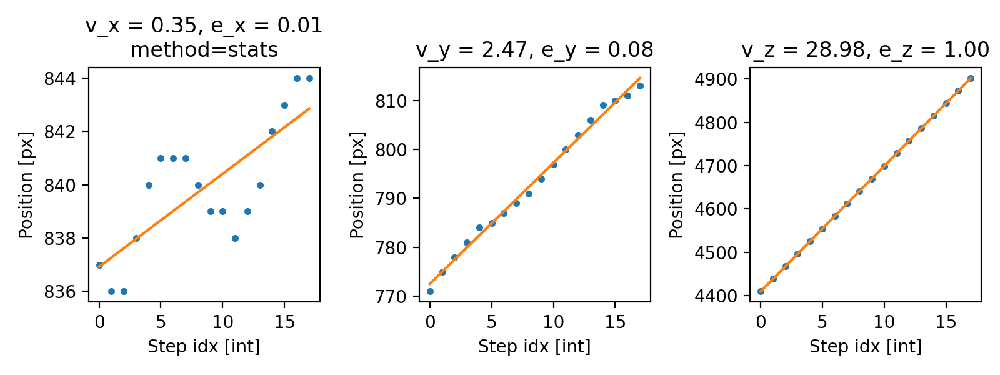

e_x = 0.01 --> alpha = 89.31deg
e_y = 0.08 --> beta = 85.13deg
e_z = 1.00 --> gamma = 4.92deg
The direction cosines of the beam idx=5, idy = 6 have been updated:
e_x = 0.013, e_y = 0.105, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.25deg
e_y = 0.11 --> beta = 83.97deg
e_z = 0.99 --> gamma = 6.08deg
The direction cosines of the beam idx=5, idy = 7 have been updated:
e_x = 0.009, e_y = 0.127, e_z = 0.992


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.49deg
e_y = 0.13 --> beta = 82.68deg
e_z = 0.99 --> gamma = 7.34deg
The direction cosines of the beam idx=6, idy = 0 have been updated:
e_x = 0.004, e_y = 0.148, e_z = 0.989


<IPython.core.display.Javascript object>


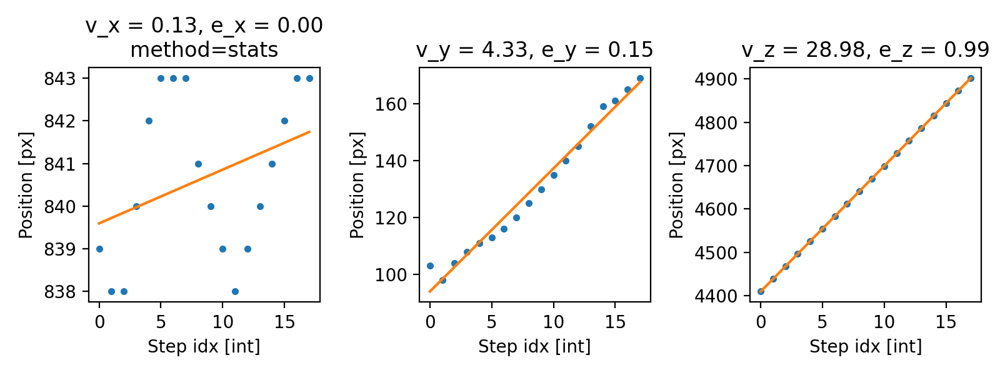

e_x = 0.00 --> alpha = 89.75deg
e_y = 0.15 --> beta = 81.51deg
e_z = 0.99 --> gamma = 8.49deg
The direction cosines of the beam idx=6, idy = 1 have been updated:
e_x = 0.009, e_y = 0.111, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.48deg
e_y = 0.11 --> beta = 83.60deg
e_z = 0.99 --> gamma = 6.42deg
The direction cosines of the beam idx=6, idy = 2 have been updated:
e_x = 0.009, e_y = 0.111, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.48deg
e_y = 0.11 --> beta = 83.60deg
e_z = 0.99 --> gamma = 6.42deg
The direction cosines of the beam idx=6, idy = 3 have been updated:
e_x = 0.009, e_y = 0.111, e_z = 0.994


<IPython.core.display.Javascript object>


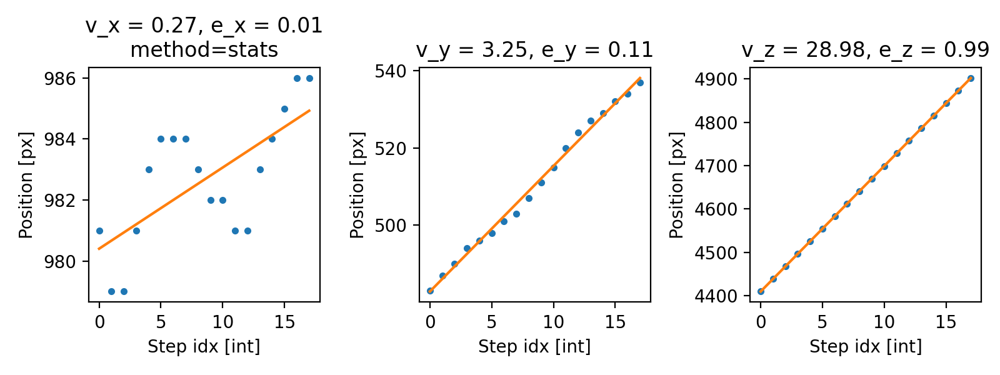

e_x = 0.01 --> alpha = 89.48deg
e_y = 0.11 --> beta = 83.60deg
e_z = 0.99 --> gamma = 6.42deg
The direction cosines of the beam idx=6, idy = 4 have been updated:
e_x = 0.010, e_y = 0.092, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.42deg
e_y = 0.09 --> beta = 84.72deg
e_z = 1.00 --> gamma = 5.31deg
The direction cosines of the beam idx=6, idy = 5 have been updated:
e_x = 0.012, e_y = 0.085, e_z = 0.996


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.31deg
e_y = 0.09 --> beta = 85.10deg
e_z = 1.00 --> gamma = 4.95deg
The direction cosines of the beam idx=6, idy = 6 have been updated:
e_x = 0.012, e_y = 0.108, e_z = 0.994


<IPython.core.display.Javascript object>


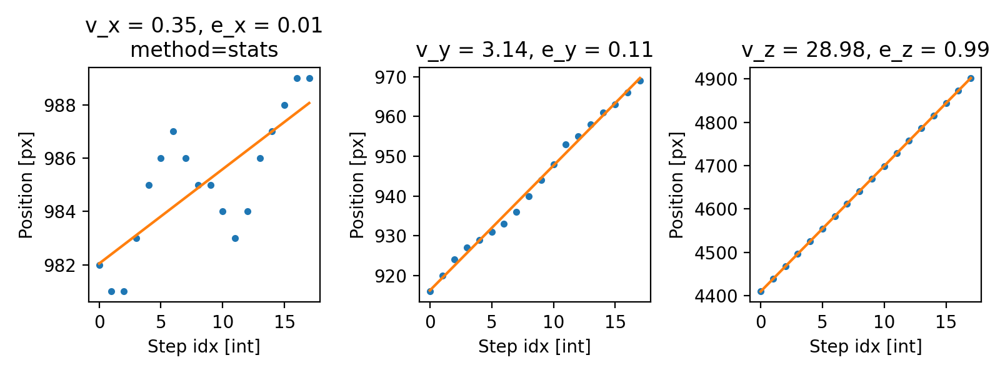

e_x = 0.01 --> alpha = 89.30deg
e_y = 0.11 --> beta = 83.82deg
e_z = 0.99 --> gamma = 6.22deg
The direction cosines of the beam idx=6, idy = 7 have been updated:
e_x = 0.012, e_y = 0.127, e_z = 0.992


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.32deg
e_y = 0.13 --> beta = 82.70deg
e_z = 0.99 --> gamma = 7.33deg
The direction cosines of the beam idx=7, idy = 0 have been updated:
e_x = 0.068, e_y = 0.117, e_z = 0.991


<IPython.core.display.Javascript object>


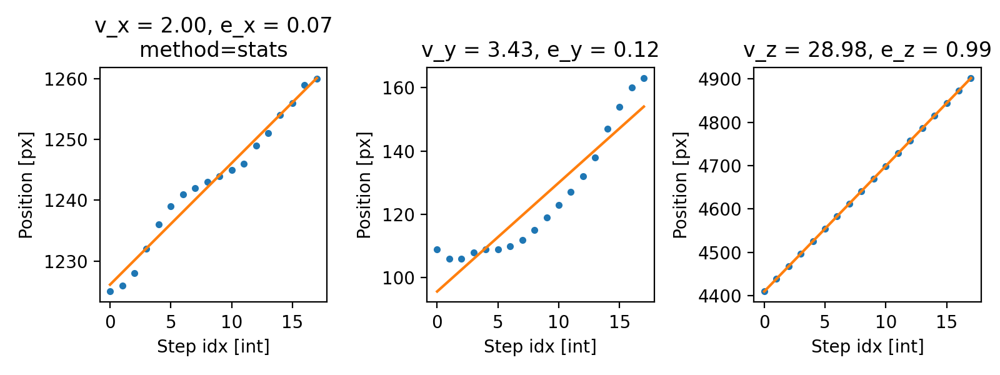

e_x = 0.07 --> alpha = 86.08deg
e_y = 0.12 --> beta = 83.26deg
e_z = 0.99 --> gamma = 7.80deg
The direction cosines of the beam idx=7, idy = 1 have been updated:
e_x = 0.010, e_y = 0.116, e_z = 0.993


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.40deg
e_y = 0.12 --> beta = 83.32deg
e_z = 0.99 --> gamma = 6.71deg
The direction cosines of the beam idx=7, idy = 2 have been updated:
e_x = 0.010, e_y = 0.116, e_z = 0.993


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.40deg
e_y = 0.12 --> beta = 83.32deg
e_z = 0.99 --> gamma = 6.71deg
The direction cosines of the beam idx=7, idy = 3 have been updated:
e_x = 0.010, e_y = 0.116, e_z = 0.993


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.40deg
e_y = 0.12 --> beta = 83.32deg
e_z = 0.99 --> gamma = 6.71deg
The direction cosines of the beam idx=7, idy = 4 have been updated:
e_x = 0.013, e_y = 0.104, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.24deg
e_y = 0.10 --> beta = 84.02deg
e_z = 0.99 --> gamma = 6.03deg
The direction cosines of the beam idx=7, idy = 5 have been updated:
e_x = 0.012, e_y = 0.104, e_z = 0.995


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.31deg
e_y = 0.10 --> beta = 84.04deg
e_z = 0.99 --> gamma = 6.00deg
The direction cosines of the beam idx=7, idy = 6 have been updated:
e_x = 0.015, e_y = 0.119, e_z = 0.993


<IPython.core.display.Javascript object>


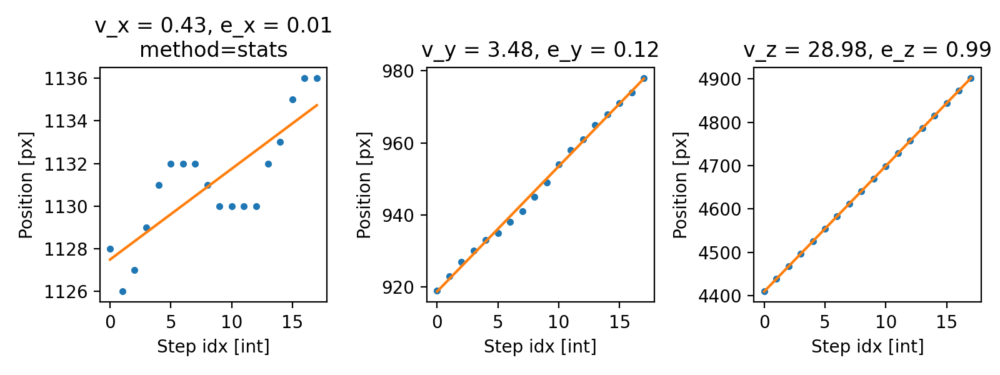

e_x = 0.01 --> alpha = 89.17deg
e_y = 0.12 --> beta = 83.16deg
e_z = 0.99 --> gamma = 6.90deg
The direction cosines of the beam idx=7, idy = 7 have been updated:
e_x = 0.011, e_y = 0.132, e_z = 0.991


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.35deg
e_y = 0.13 --> beta = 82.41deg
e_z = 0.99 --> gamma = 7.62deg
The direction cosines of the beam idx=8, idy = 0 have been updated:
e_x = 0.068, e_y = 0.117, e_z = 0.991


<IPython.core.display.Javascript object>


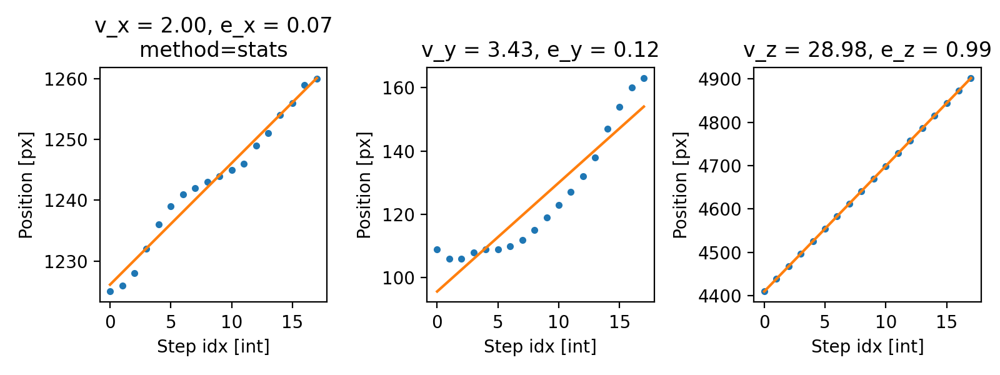

e_x = 0.07 --> alpha = 86.08deg
e_y = 0.12 --> beta = 83.26deg
e_z = 0.99 --> gamma = 7.80deg
The direction cosines of the beam idx=8, idy = 1 have been updated:
e_x = 0.068, e_y = 0.117, e_z = 0.991


<IPython.core.display.Javascript object>

e_x = 0.07 --> alpha = 86.08deg
e_y = 0.12 --> beta = 83.26deg
e_z = 0.99 --> gamma = 7.80deg
The direction cosines of the beam idx=8, idy = 2 have been updated:
e_x = 0.011, e_y = 0.106, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.37deg
e_y = 0.11 --> beta = 83.93deg
e_z = 0.99 --> gamma = 6.11deg
The direction cosines of the beam idx=8, idy = 3 have been updated:
e_x = 0.011, e_y = 0.106, e_z = 0.994


<IPython.core.display.Javascript object>


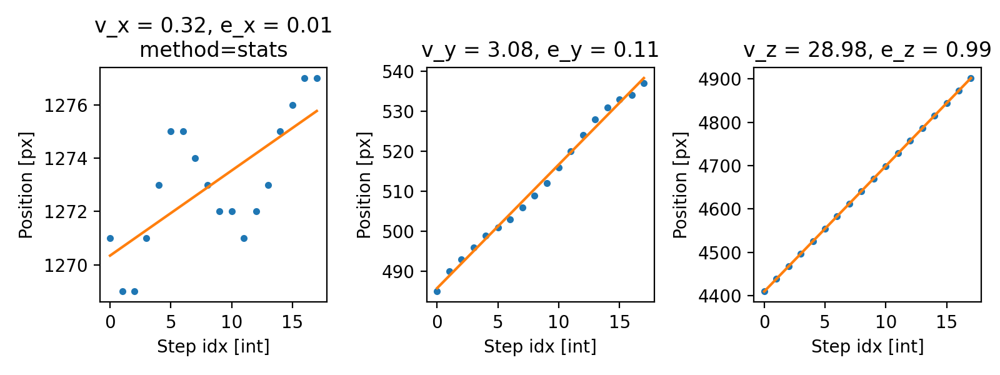

e_x = 0.01 --> alpha = 89.37deg
e_y = 0.11 --> beta = 83.93deg
e_z = 0.99 --> gamma = 6.11deg
The direction cosines of the beam idx=8, idy = 4 have been updated:
e_x = 0.012, e_y = 0.098, e_z = 0.995


<IPython.core.display.Javascript object>


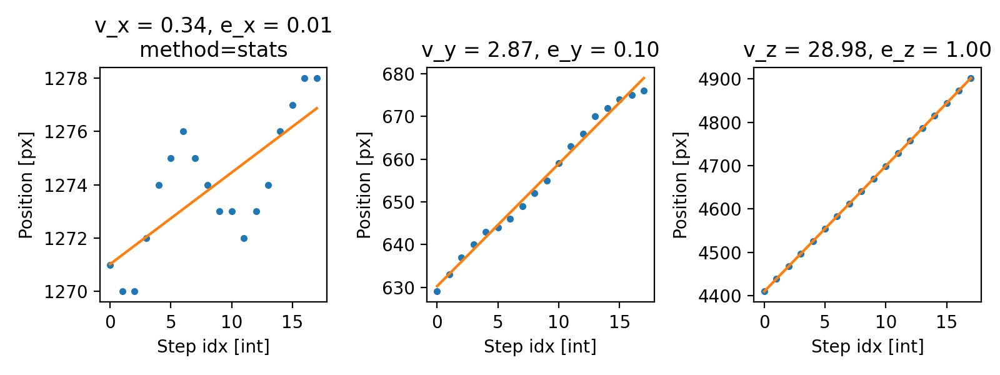

e_x = 0.01 --> alpha = 89.32deg
e_y = 0.10 --> beta = 84.35deg
e_z = 1.00 --> gamma = 5.69deg
The direction cosines of the beam idx=8, idy = 5 have been updated:
e_x = 0.011, e_y = 0.123, e_z = 0.992


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.34deg
e_y = 0.12 --> beta = 82.93deg
e_z = 0.99 --> gamma = 7.10deg
The direction cosines of the beam idx=8, idy = 6 have been updated:
e_x = 0.014, e_y = 0.127, e_z = 0.992


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.18deg
e_y = 0.13 --> beta = 82.70deg
e_z = 0.99 --> gamma = 7.35deg
The direction cosines of the beam idx=8, idy = 7 have been updated:
e_x = 0.009, e_y = 0.135, e_z = 0.991


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.46deg
e_y = 0.14 --> beta = 82.23deg
e_z = 0.99 --> gamma = 7.79deg
The direction cosines of the beam idx=9, idy = 0 have been updated:
e_x = 0.068, e_y = 0.117, e_z = 0.991


<IPython.core.display.Javascript object>


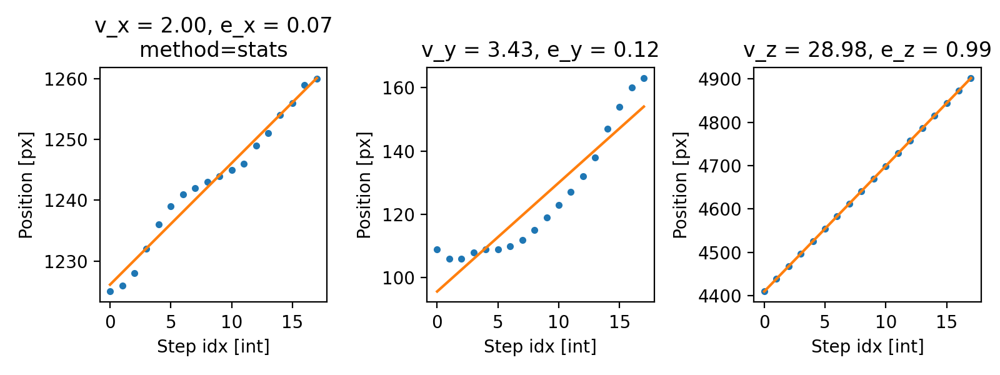

e_x = 0.07 --> alpha = 86.08deg
e_y = 0.12 --> beta = 83.26deg
e_z = 0.99 --> gamma = 7.80deg
The direction cosines of the beam idx=9, idy = 1 have been updated:
e_x = 0.009, e_y = 0.115, e_z = 0.993


<IPython.core.display.Javascript object>


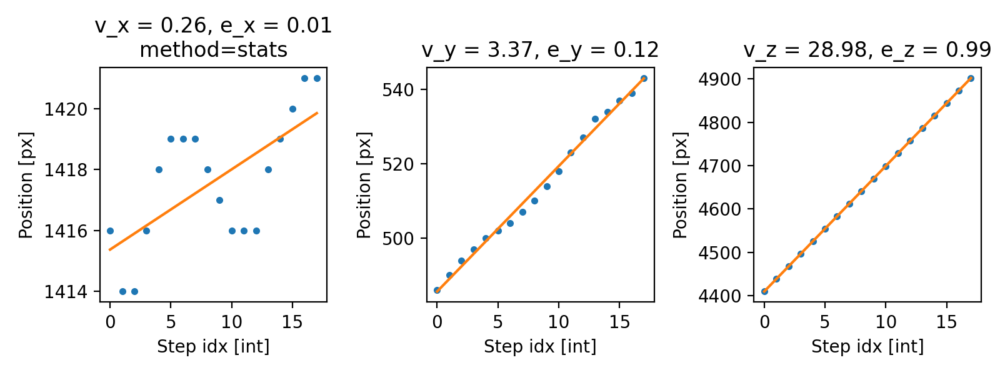

e_x = 0.01 --> alpha = 89.48deg
e_y = 0.12 --> beta = 83.37deg
e_z = 0.99 --> gamma = 6.65deg
The direction cosines of the beam idx=9, idy = 2 have been updated:
e_x = 0.009, e_y = 0.115, e_z = 0.993


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.48deg
e_y = 0.12 --> beta = 83.37deg
e_z = 0.99 --> gamma = 6.65deg
The direction cosines of the beam idx=9, idy = 3 have been updated:
e_x = 0.009, e_y = 0.115, e_z = 0.993


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.48deg
e_y = 0.12 --> beta = 83.37deg
e_z = 0.99 --> gamma = 6.65deg
The direction cosines of the beam idx=9, idy = 4 have been updated:
e_x = 0.011, e_y = 0.108, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.35deg
e_y = 0.11 --> beta = 83.82deg
e_z = 0.99 --> gamma = 6.21deg
The direction cosines of the beam idx=9, idy = 5 have been updated:
e_x = 0.012, e_y = 0.112, e_z = 0.994


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.31deg
e_y = 0.11 --> beta = 83.58deg
e_z = 0.99 --> gamma = 6.46deg
The direction cosines of the beam idx=9, idy = 6 have been updated:
e_x = 0.012, e_y = 0.127, e_z = 0.992


<IPython.core.display.Javascript object>


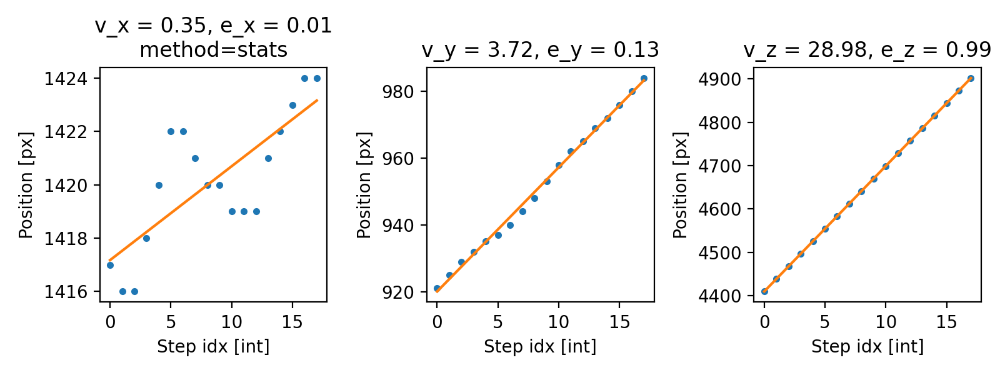

e_x = 0.01 --> alpha = 89.31deg
e_y = 0.13 --> beta = 82.68deg
e_z = 0.99 --> gamma = 7.35deg
The direction cosines of the beam idx=9, idy = 7 have been updated:
e_x = 0.009, e_y = 0.145, e_z = 0.989


<IPython.core.display.Javascript object>

e_x = 0.01 --> alpha = 89.49deg
e_y = 0.15 --> beta = 81.66deg
e_z = 0.99 --> gamma = 8.36deg
The fit is limited to the useful cross sections, defined by tomo.set_max_z()
The divergence angles of the beam idx=0, idy = 0 have been updated:
div_row = 1.333deg, e_col = 0.987deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=0, idy = 1 have been updated:
div_row = 1.333deg, e_col = 0.987deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=0, idy = 2 have been updated:
div_row = 1.333deg, e_col = 0.987deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=0, idy = 3 have been updated:
div_row = 1.333deg, e_col = 0.987deg


<IPython.core.display.Javascript object>


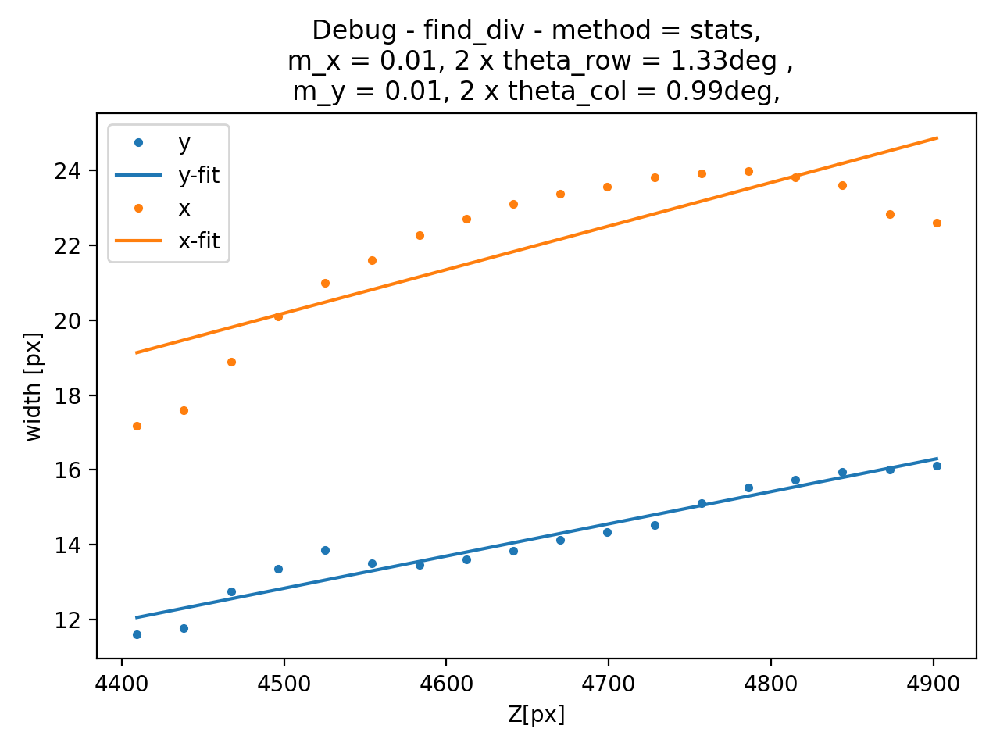

The divergence angles of the beam idx=0, idy = 4 have been updated:
div_row = 1.356deg, e_col = 0.568deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=0, idy = 5 have been updated:
div_row = 1.179deg, e_col = 1.306deg


<IPython.core.display.Javascript object>


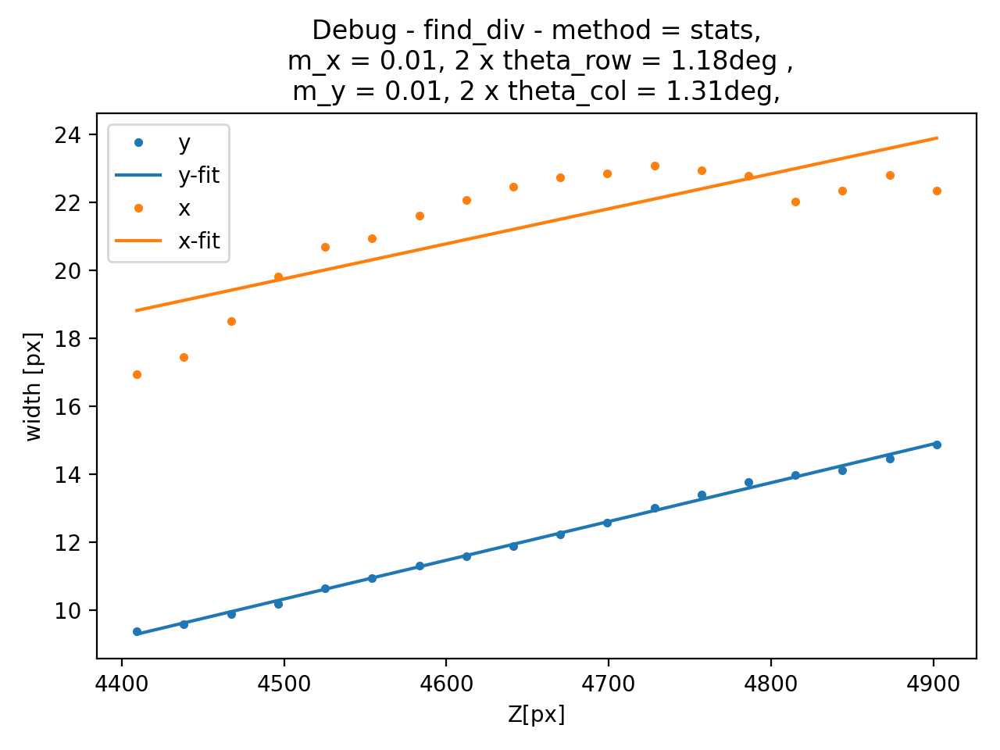

The divergence angles of the beam idx=0, idy = 6 have been updated:
div_row = 1.598deg, e_col = 1.306deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=0, idy = 7 have been updated:
div_row = 0.927deg, e_col = 1.211deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=1, idy = 0 have been updated:
div_row = 2.289deg, e_col = 1.127deg


<IPython.core.display.Javascript object>


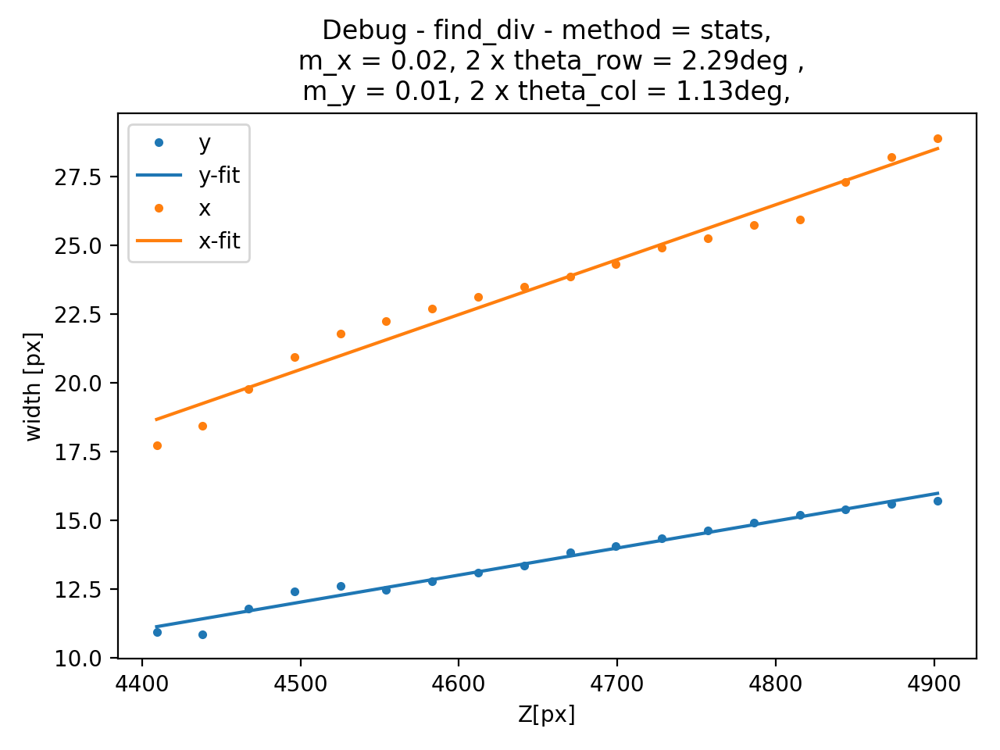

The divergence angles of the beam idx=1, idy = 1 have been updated:
div_row = 2.289deg, e_col = 1.127deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=1, idy = 2 have been updated:
div_row = 2.289deg, e_col = 1.127deg


<IPython.core.display.Javascript object>


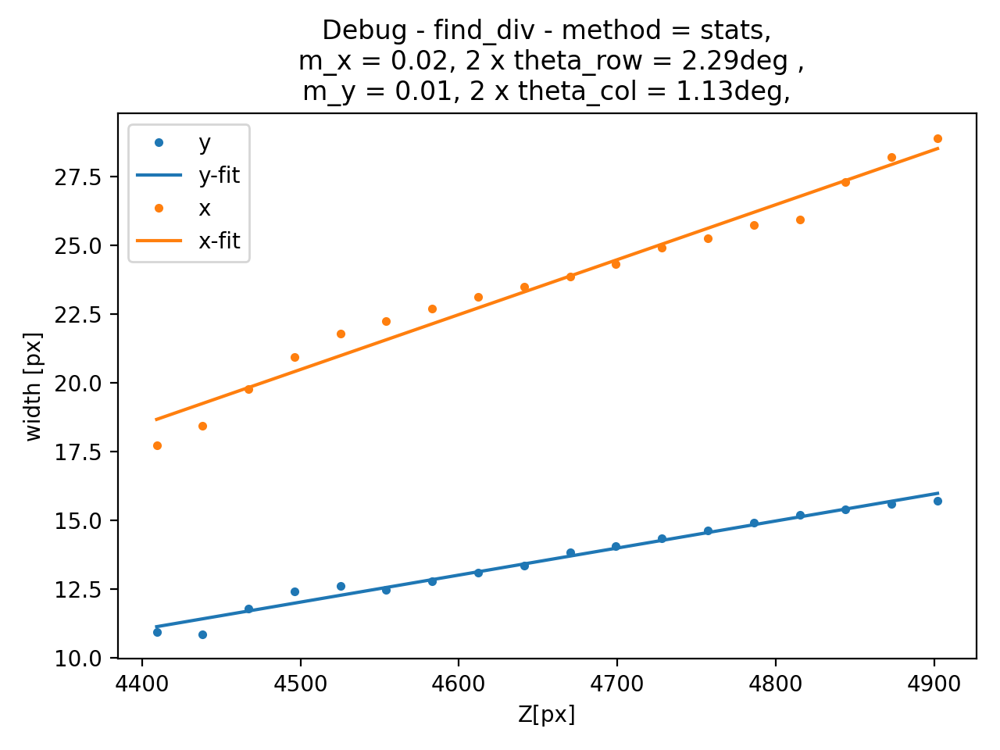

The divergence angles of the beam idx=1, idy = 3 have been updated:
div_row = 2.289deg, e_col = 1.127deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=1, idy = 4 have been updated:
div_row = 0.945deg, e_col = 0.647deg


<IPython.core.display.Javascript object>


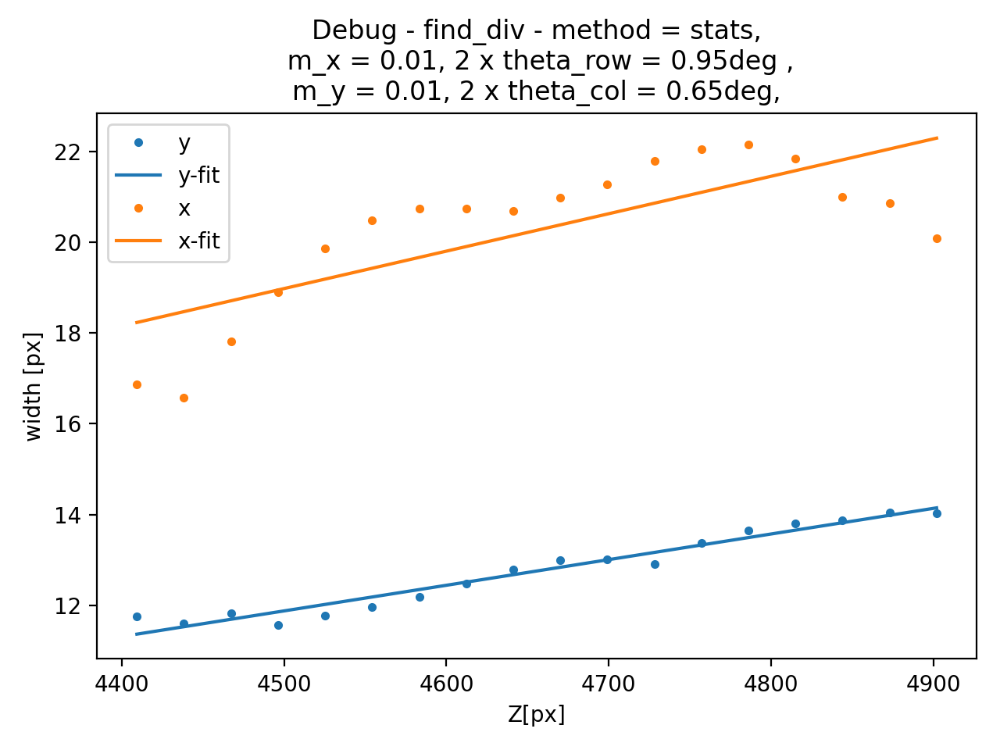

The divergence angles of the beam idx=1, idy = 5 have been updated:
div_row = 0.995deg, e_col = 1.264deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=1, idy = 6 have been updated:
div_row = 1.748deg, e_col = 1.339deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=1, idy = 7 have been updated:
div_row = 1.424deg, e_col = 1.292deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=2, idy = 0 have been updated:
div_row = 1.457deg, e_col = 1.335deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=2, idy = 1 have been updated:
div_row = 1.457deg, e_col = 1.335deg


<IPython.core.display.Javascript object>


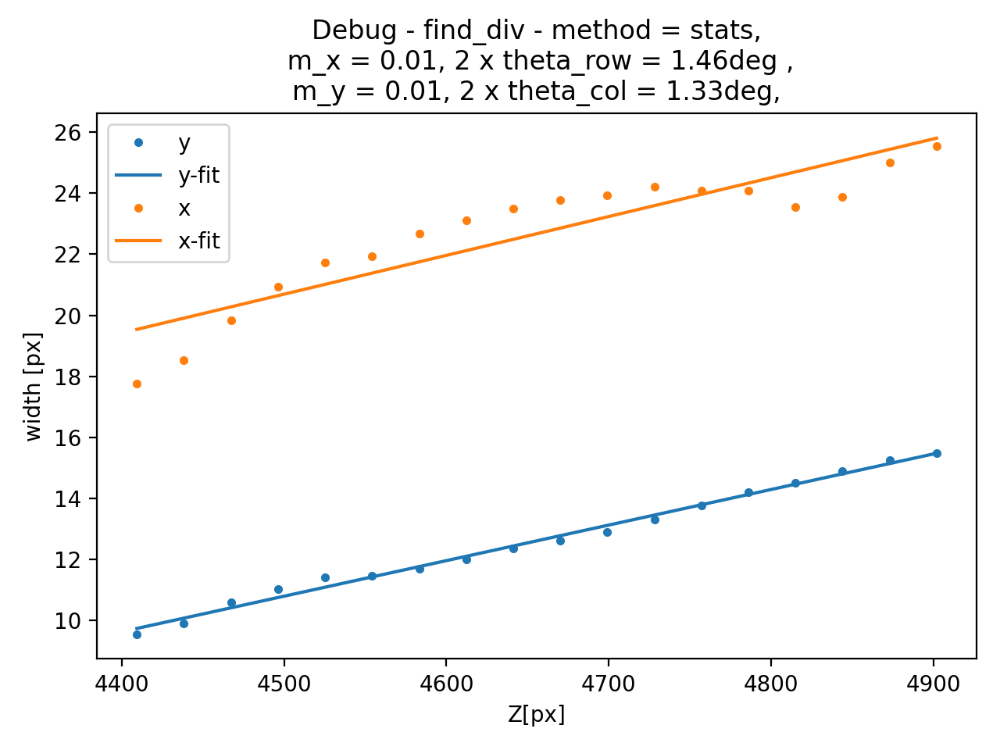

The divergence angles of the beam idx=2, idy = 2 have been updated:
div_row = 1.457deg, e_col = 1.335deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=2, idy = 3 have been updated:
div_row = 1.457deg, e_col = 1.335deg


<IPython.core.display.Javascript object>


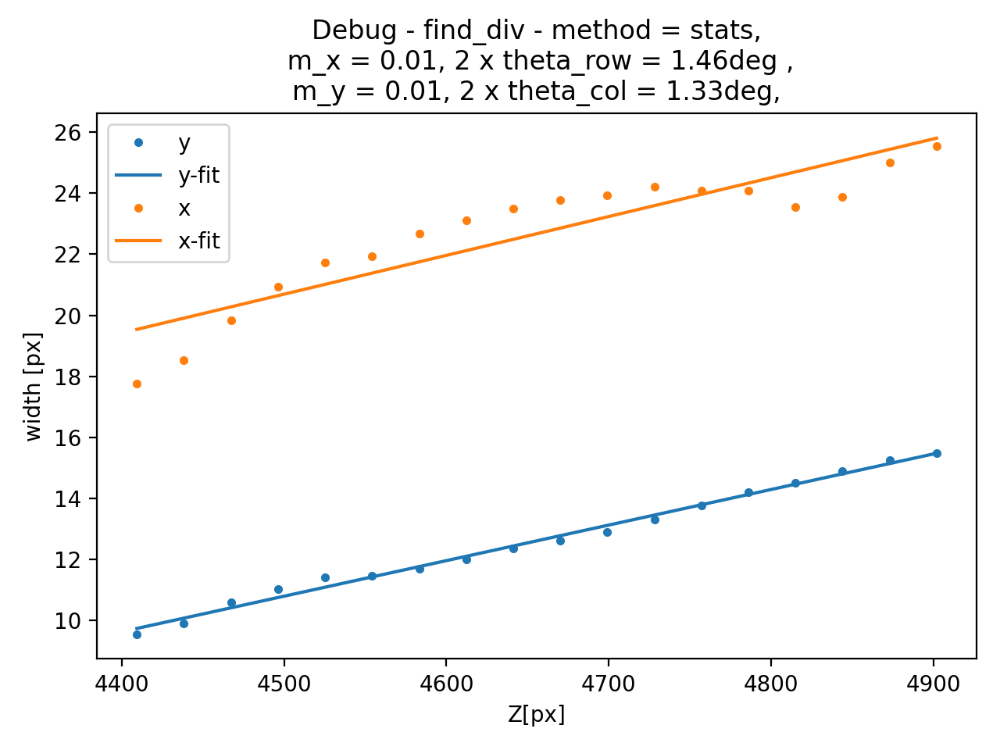

The divergence angles of the beam idx=2, idy = 4 have been updated:
div_row = 1.019deg, e_col = 1.257deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=2, idy = 5 have been updated:
div_row = 1.017deg, e_col = 1.446deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=2, idy = 6 have been updated:
div_row = 1.533deg, e_col = 1.384deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=2, idy = 7 have been updated:
div_row = 0.375deg, e_col = 1.327deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=3, idy = 0 have been updated:
div_row = 2.667deg, e_col = -0.816deg


<IPython.core.display.Javascript object>


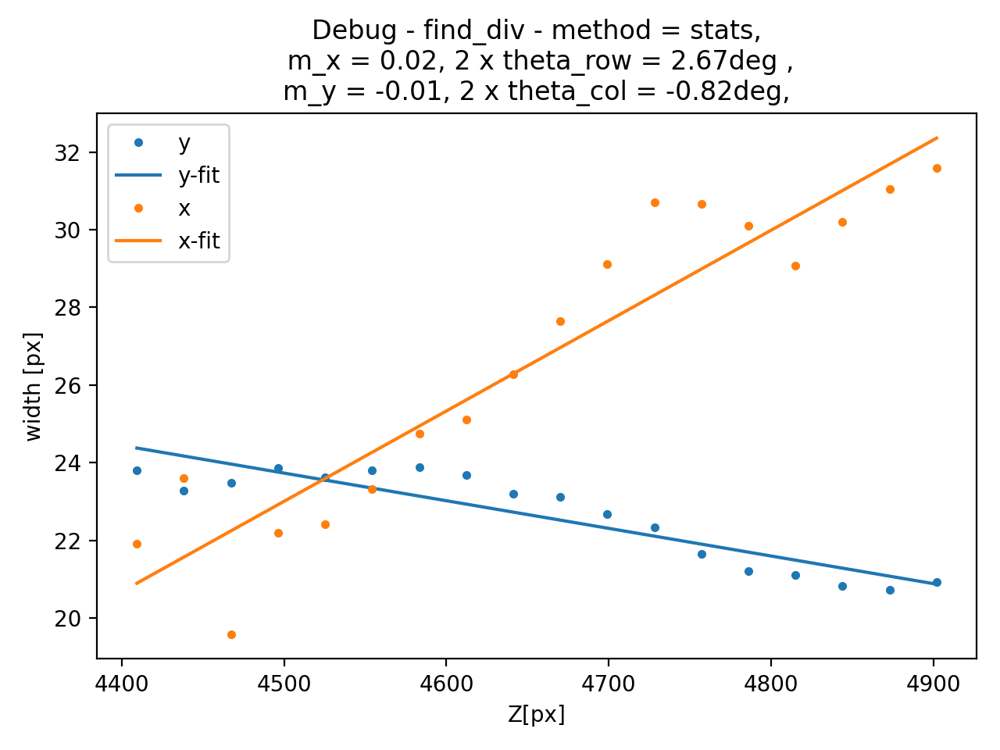

The divergence angles of the beam idx=3, idy = 1 have been updated:
div_row = 0.787deg, e_col = 1.104deg


<IPython.core.display.Javascript object>


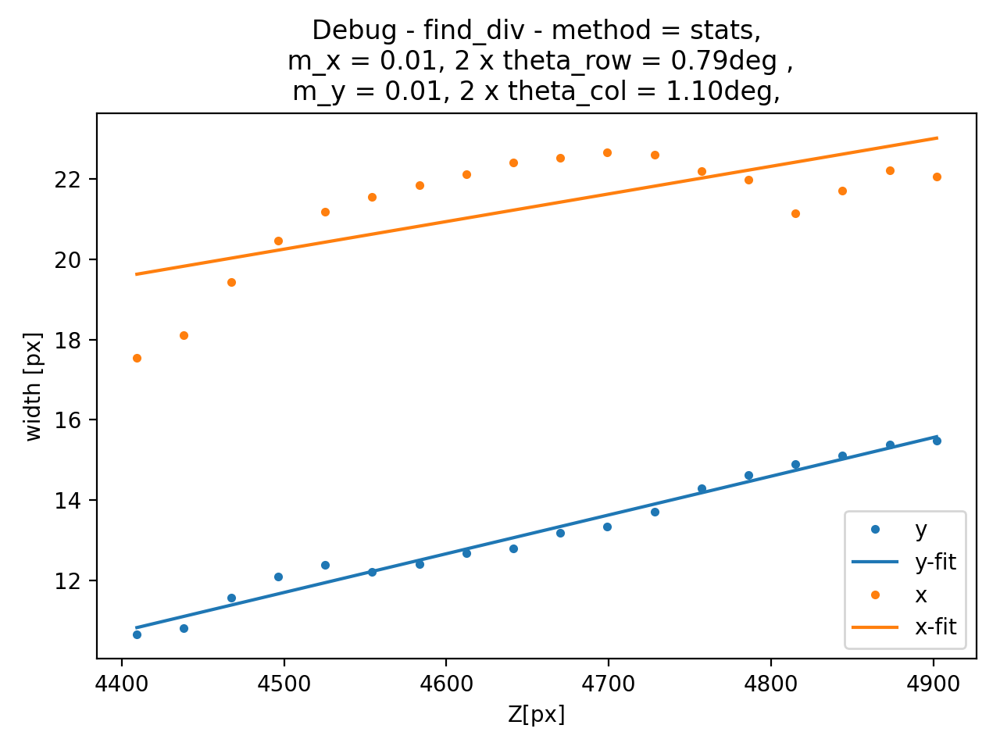

The divergence angles of the beam idx=3, idy = 2 have been updated:
div_row = 0.787deg, e_col = 1.104deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=3, idy = 3 have been updated:
div_row = 0.787deg, e_col = 1.104deg


<IPython.core.display.Javascript object>


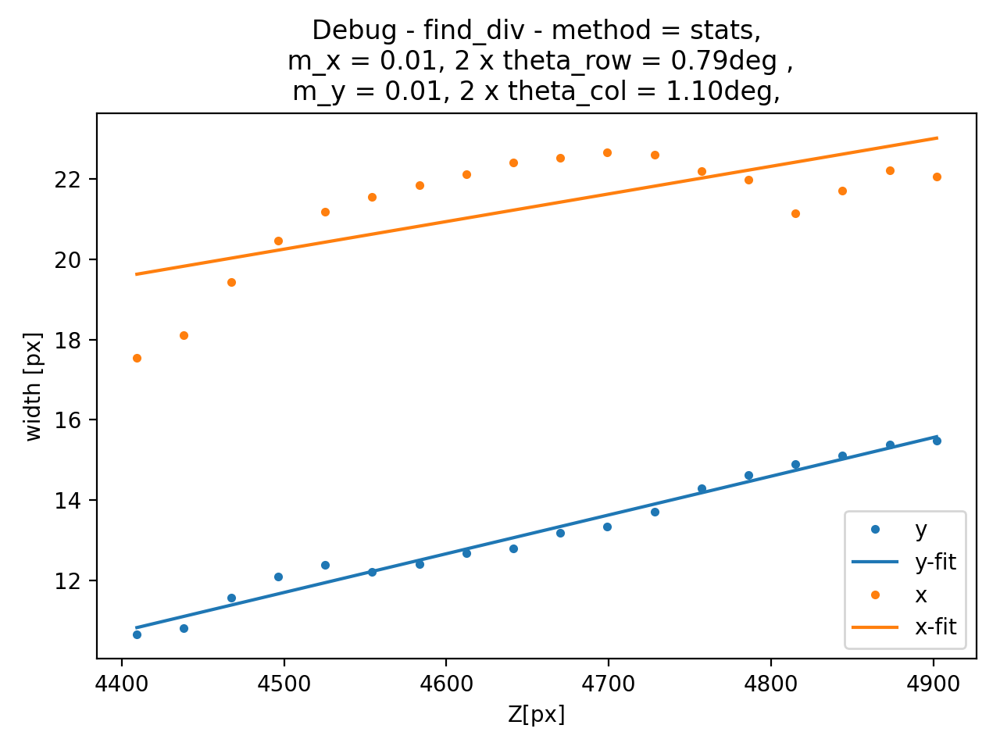

The divergence angles of the beam idx=3, idy = 4 have been updated:
div_row = 0.701deg, e_col = 0.201deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=3, idy = 5 have been updated:
div_row = 0.946deg, e_col = 1.469deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=3, idy = 6 have been updated:
div_row = 0.143deg, e_col = 1.093deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=3, idy = 7 have been updated:
div_row = 1.278deg, e_col = 1.257deg


<IPython.core.display.Javascript object>


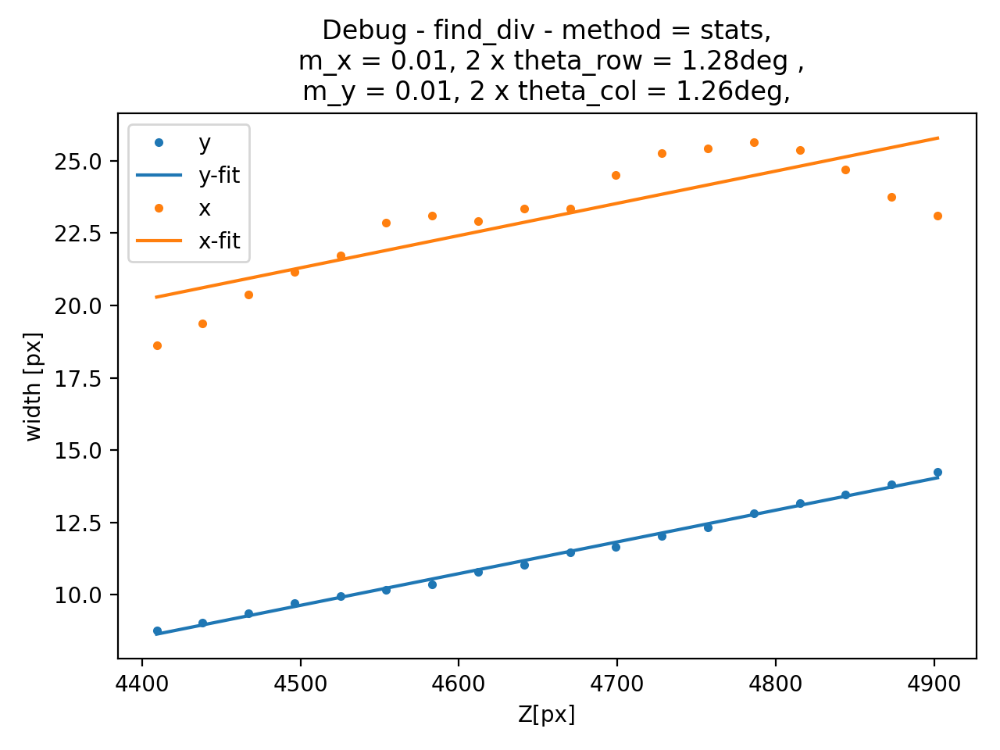

The divergence angles of the beam idx=4, idy = 0 have been updated:
div_row = 2.667deg, e_col = -0.816deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=4, idy = 1 have been updated:
div_row = 0.776deg, e_col = 0.847deg


<IPython.core.display.Javascript object>


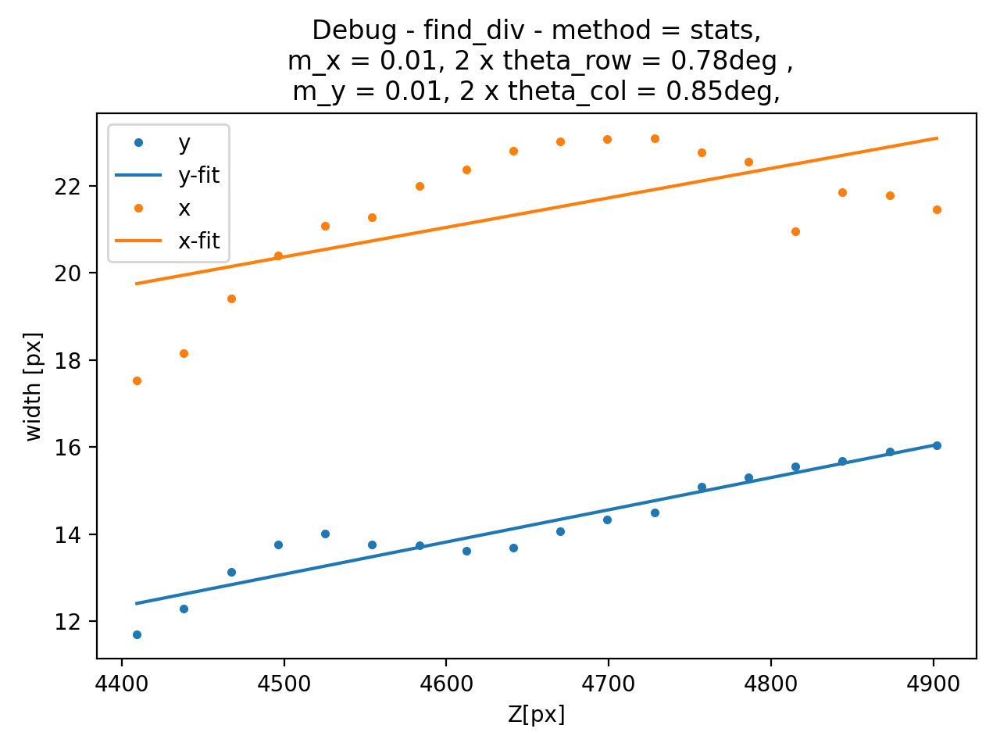

The divergence angles of the beam idx=4, idy = 2 have been updated:
div_row = 0.776deg, e_col = 0.847deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=4, idy = 3 have been updated:
div_row = 0.776deg, e_col = 0.847deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=4, idy = 4 have been updated:
div_row = 0.967deg, e_col = 0.109deg


<IPython.core.display.Javascript object>


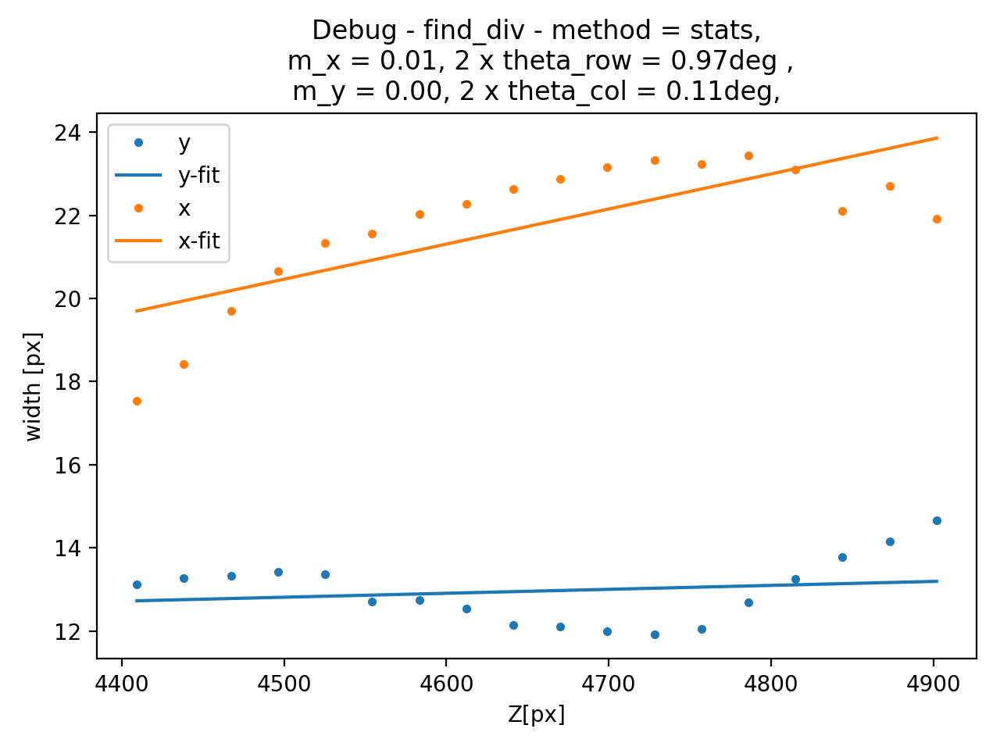

The divergence angles of the beam idx=4, idy = 5 have been updated:
div_row = 0.855deg, e_col = 1.241deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=4, idy = 6 have been updated:
div_row = 0.508deg, e_col = 0.664deg


<IPython.core.display.Javascript object>


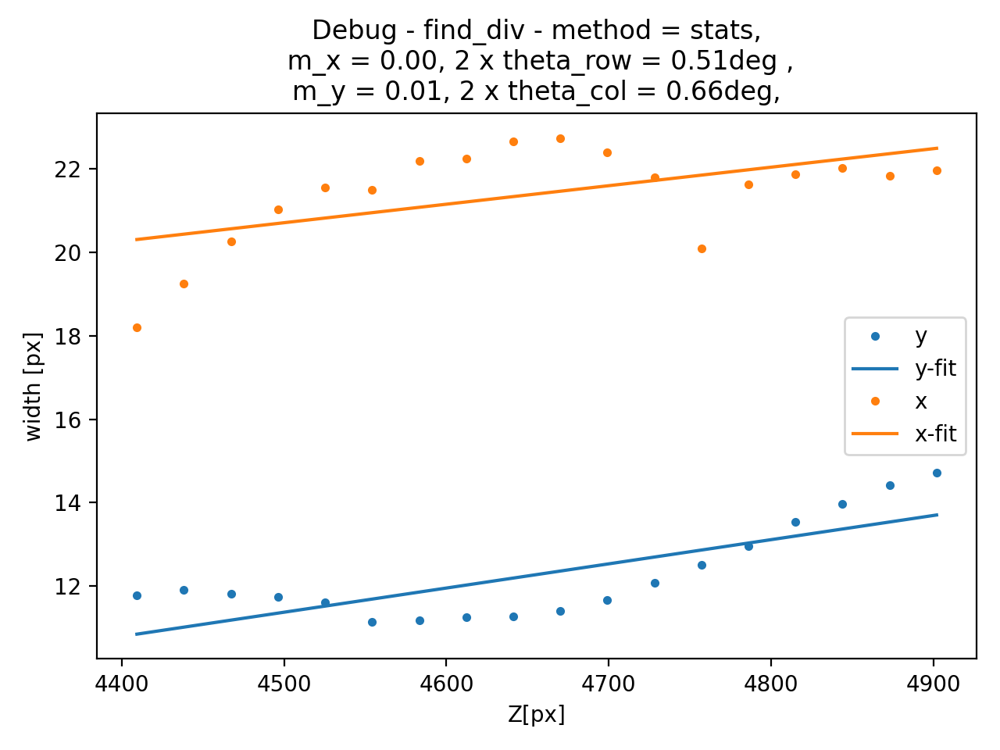

The divergence angles of the beam idx=4, idy = 7 have been updated:
div_row = 0.844deg, e_col = 0.721deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=5, idy = 0 have been updated:
div_row = 2.667deg, e_col = -0.816deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=5, idy = 1 have been updated:
div_row = 2.667deg, e_col = -0.816deg


<IPython.core.display.Javascript object>


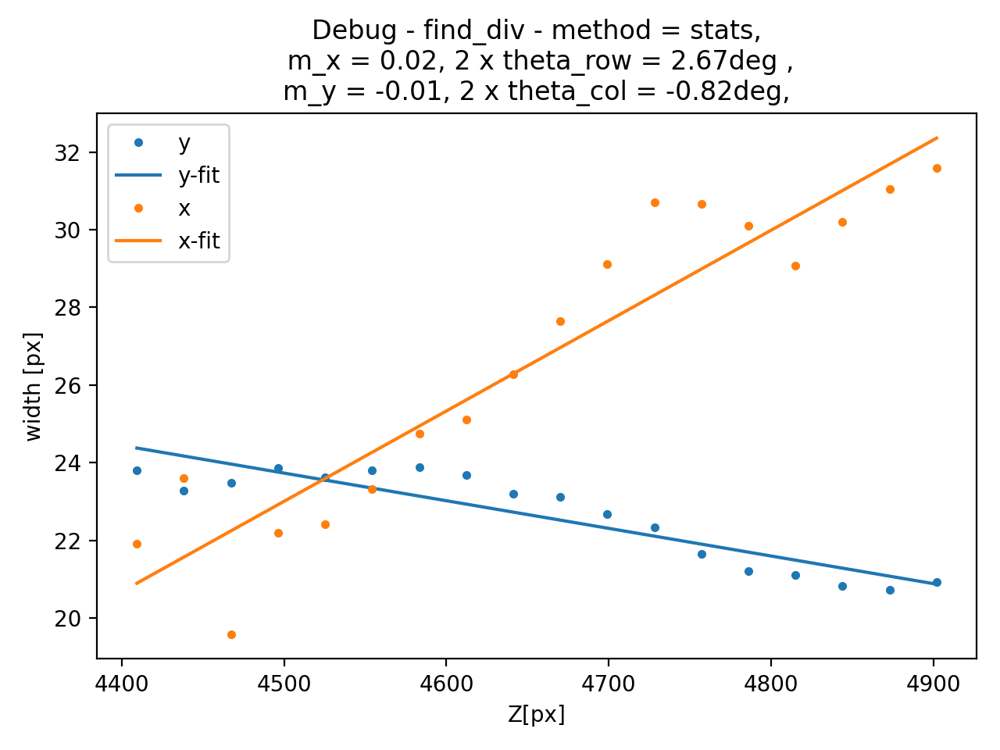

The divergence angles of the beam idx=5, idy = 2 have been updated:
div_row = 0.778deg, e_col = 1.127deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=5, idy = 3 have been updated:
div_row = 0.778deg, e_col = 1.127deg


<IPython.core.display.Javascript object>


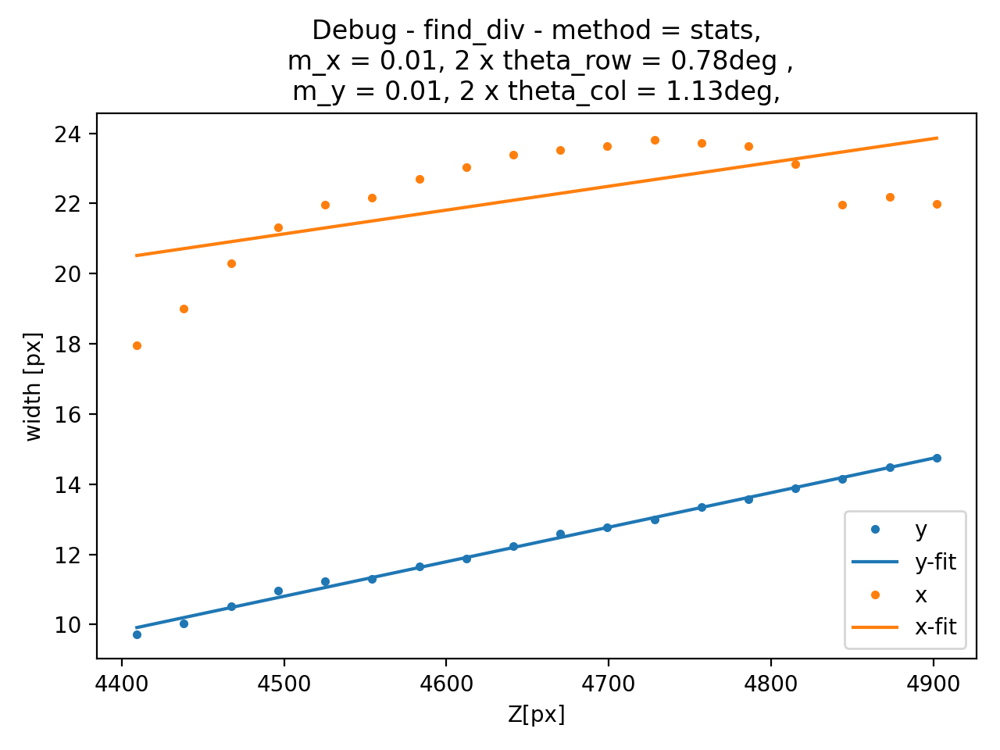

The divergence angles of the beam idx=5, idy = 4 have been updated:
div_row = 0.917deg, e_col = 1.249deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=5, idy = 5 have been updated:
div_row = 0.893deg, e_col = 0.948deg


<IPython.core.display.Javascript object>


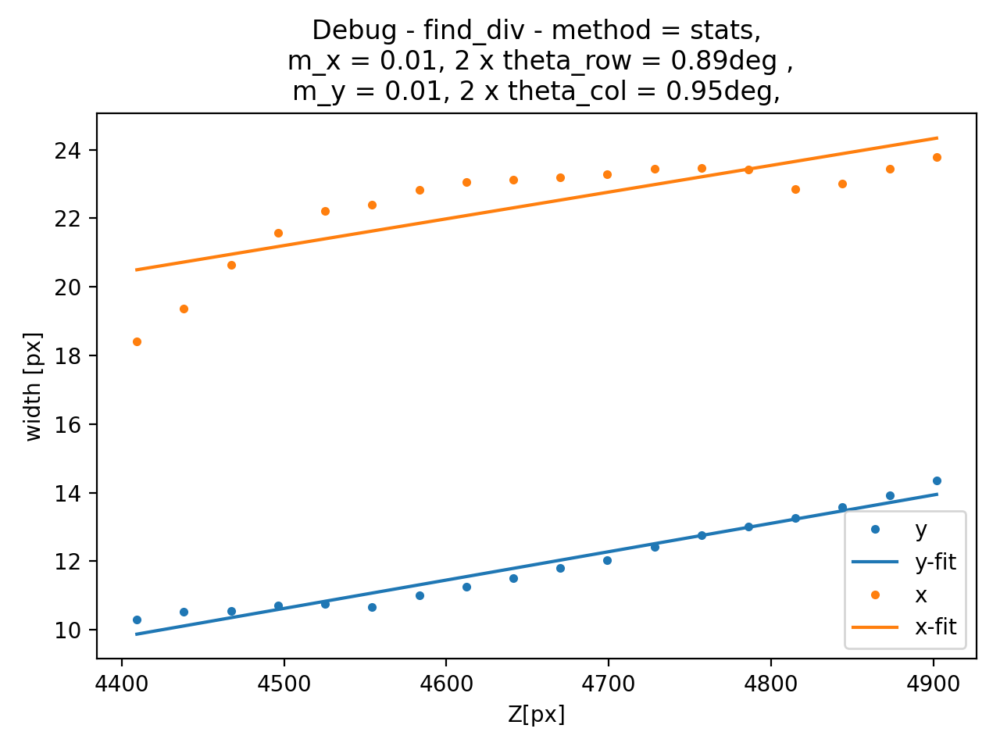

The divergence angles of the beam idx=5, idy = 6 have been updated:
div_row = 0.486deg, e_col = 1.345deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=5, idy = 7 have been updated:
div_row = 0.753deg, e_col = 0.748deg


<IPython.core.display.Javascript object>


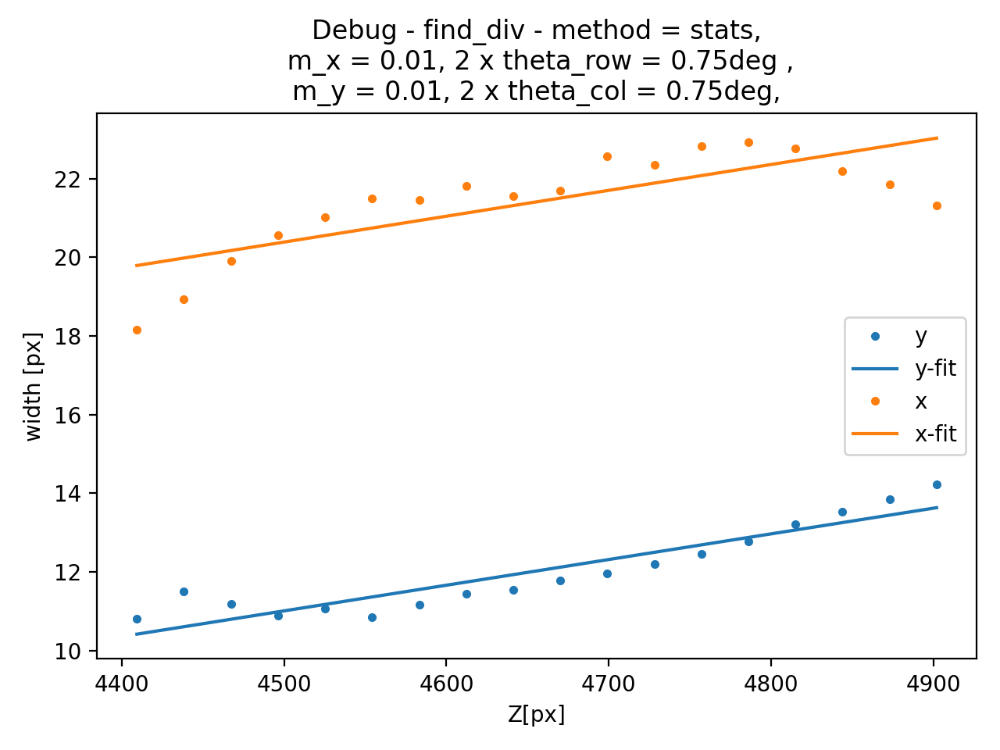

The divergence angles of the beam idx=6, idy = 0 have been updated:
div_row = 2.667deg, e_col = -0.816deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=6, idy = 1 have been updated:
div_row = 1.143deg, e_col = 1.397deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=6, idy = 2 have been updated:
div_row = 1.143deg, e_col = 1.397deg


<IPython.core.display.Javascript object>


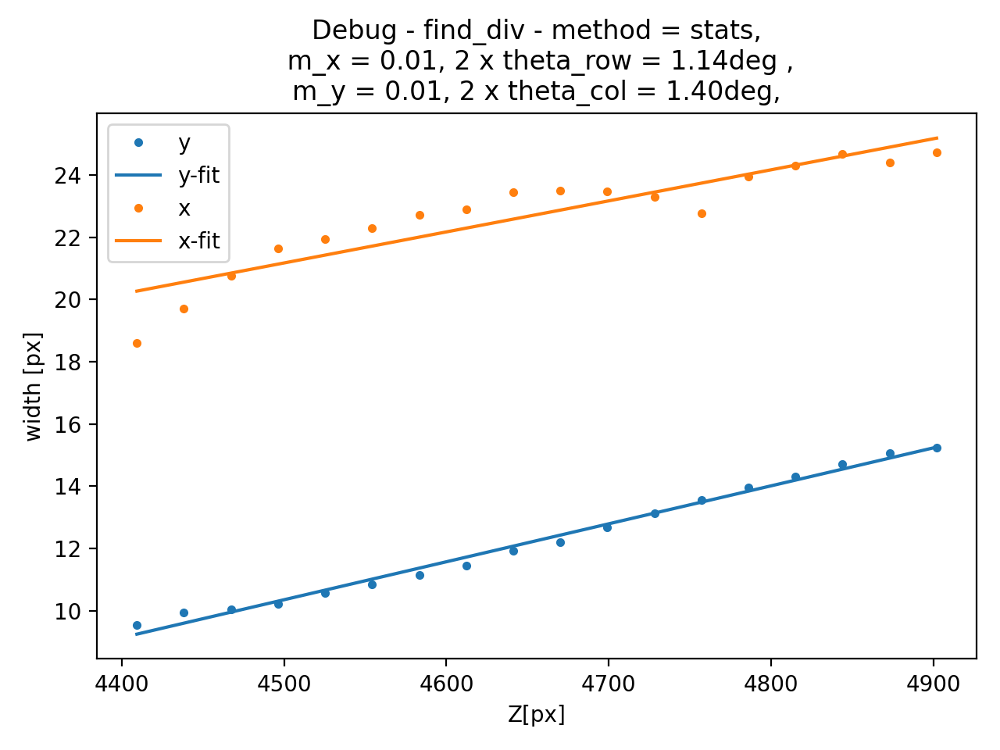

The divergence angles of the beam idx=6, idy = 3 have been updated:
div_row = 1.143deg, e_col = 1.397deg


<IPython.core.display.Javascript object>


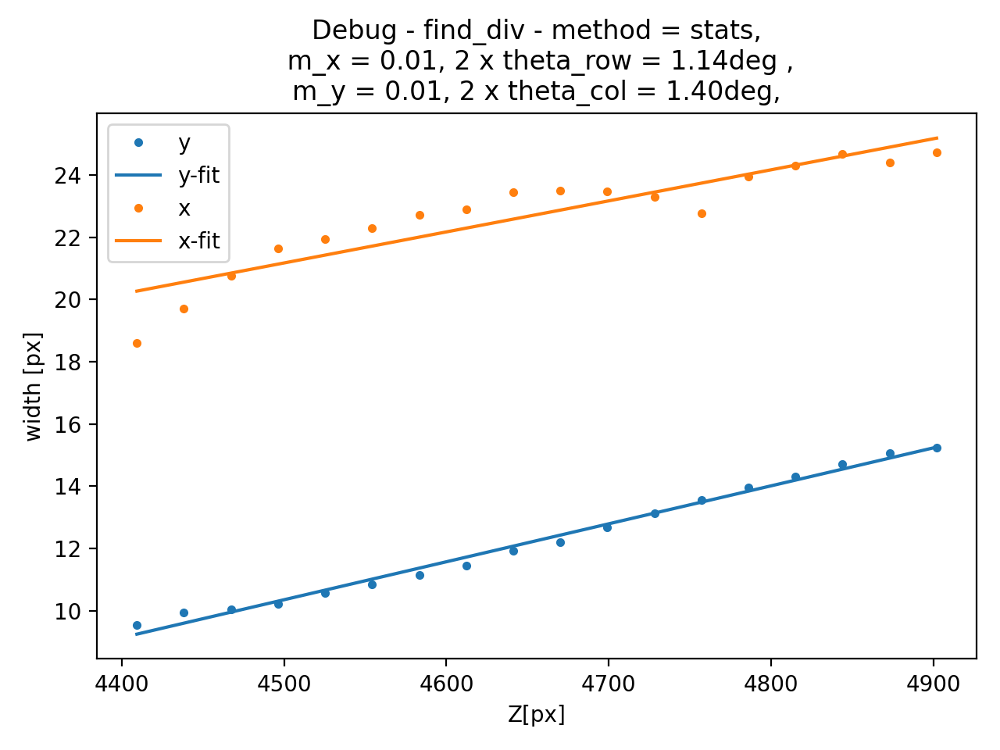

The divergence angles of the beam idx=6, idy = 4 have been updated:
div_row = 1.277deg, e_col = 1.369deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=6, idy = 5 have been updated:
div_row = 1.533deg, e_col = 1.298deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=6, idy = 6 have been updated:
div_row = 1.223deg, e_col = 1.359deg


<IPython.core.display.Javascript object>


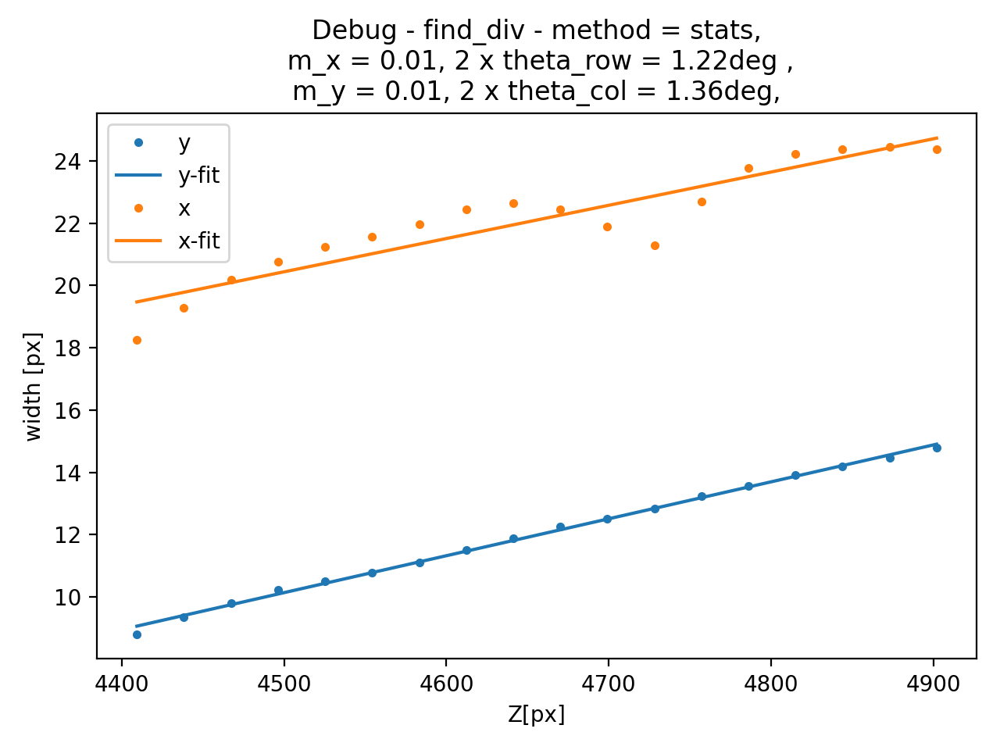

The divergence angles of the beam idx=6, idy = 7 have been updated:
div_row = 0.872deg, e_col = 1.336deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=7, idy = 0 have been updated:
div_row = -1.035deg, e_col = 0.262deg


<IPython.core.display.Javascript object>


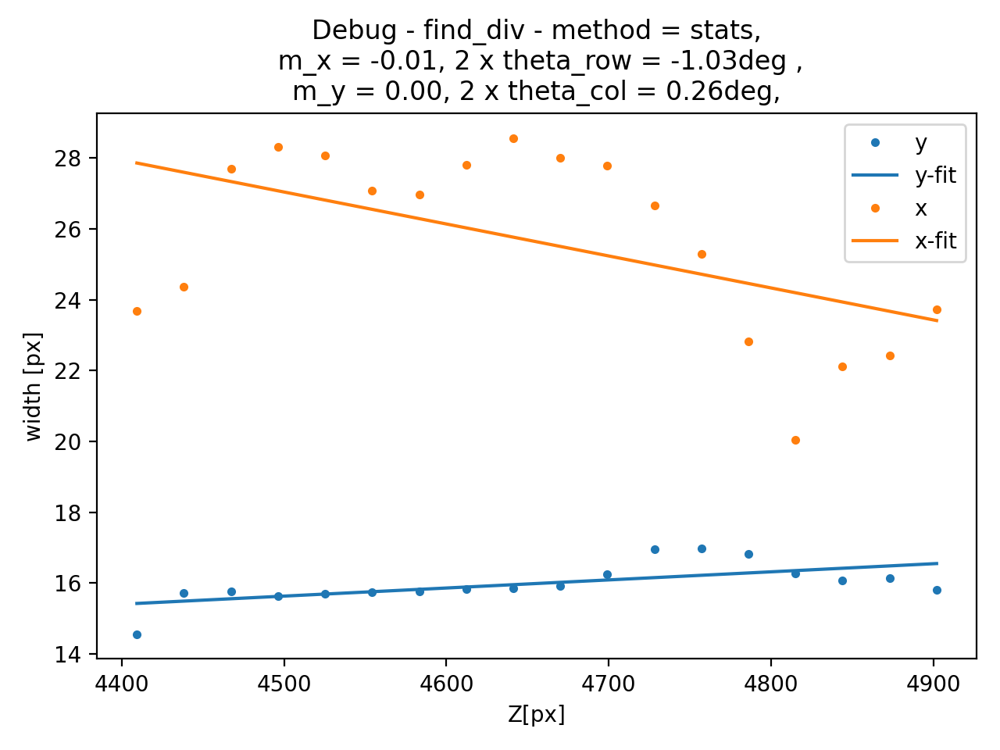

The divergence angles of the beam idx=7, idy = 1 have been updated:
div_row = 1.758deg, e_col = 1.380deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=7, idy = 2 have been updated:
div_row = 1.758deg, e_col = 1.380deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=7, idy = 3 have been updated:
div_row = 1.758deg, e_col = 1.380deg


<IPython.core.display.Javascript object>


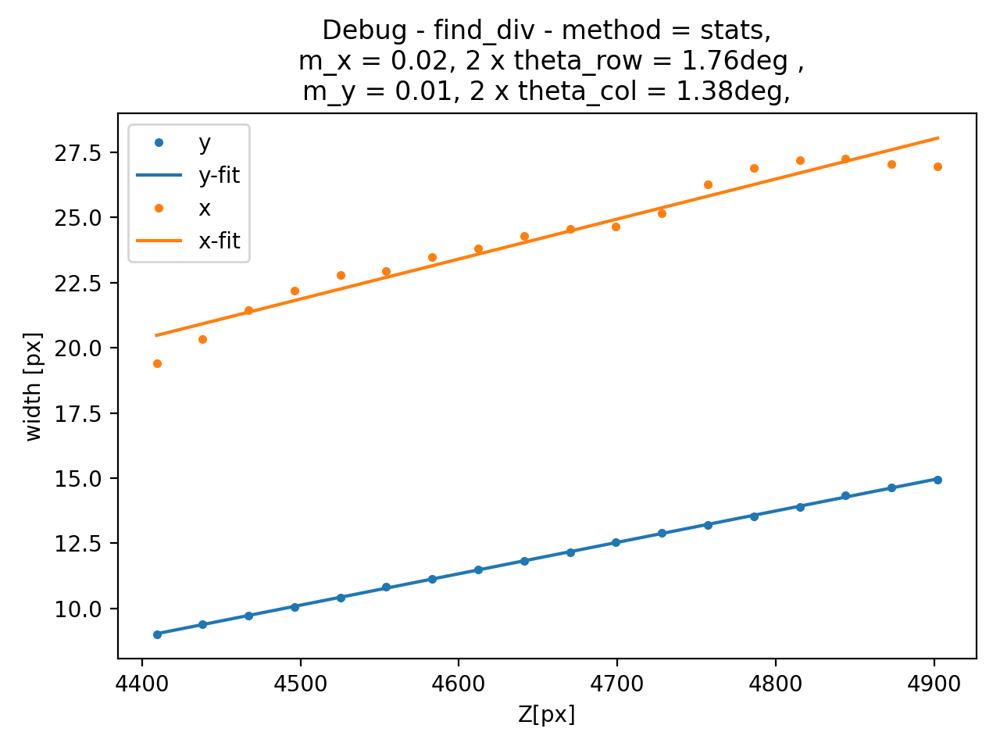

The divergence angles of the beam idx=7, idy = 4 have been updated:
div_row = 1.740deg, e_col = 1.425deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=7, idy = 5 have been updated:
div_row = 1.870deg, e_col = 1.421deg


<IPython.core.display.Javascript object>


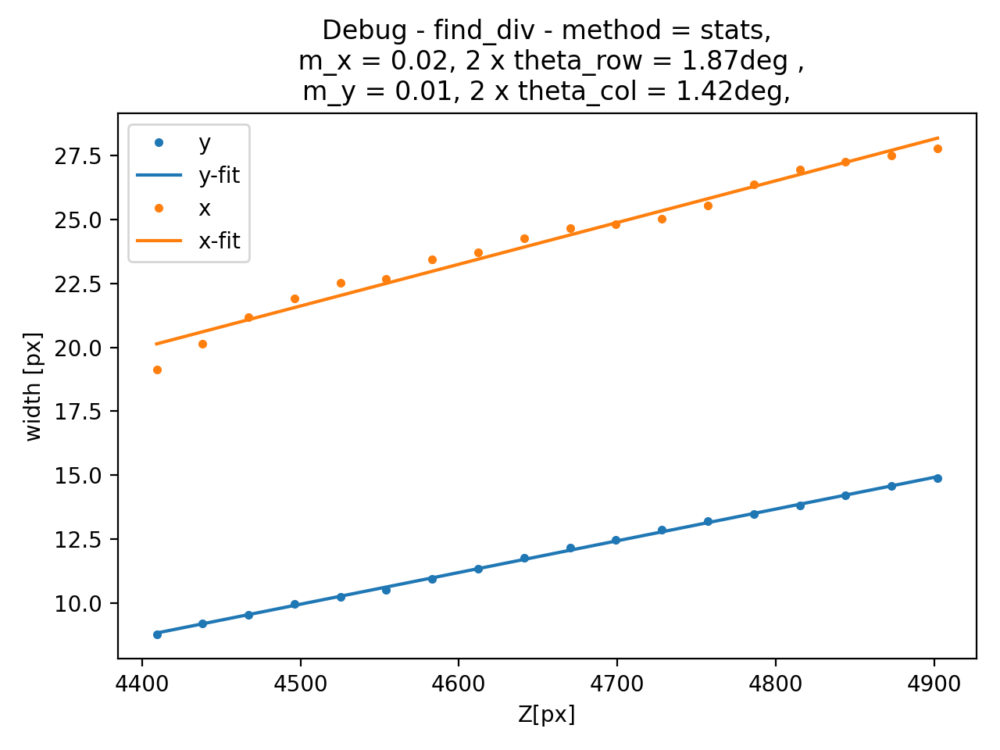

The divergence angles of the beam idx=7, idy = 6 have been updated:
div_row = 1.048deg, e_col = 1.398deg


<IPython.core.display.Javascript object>


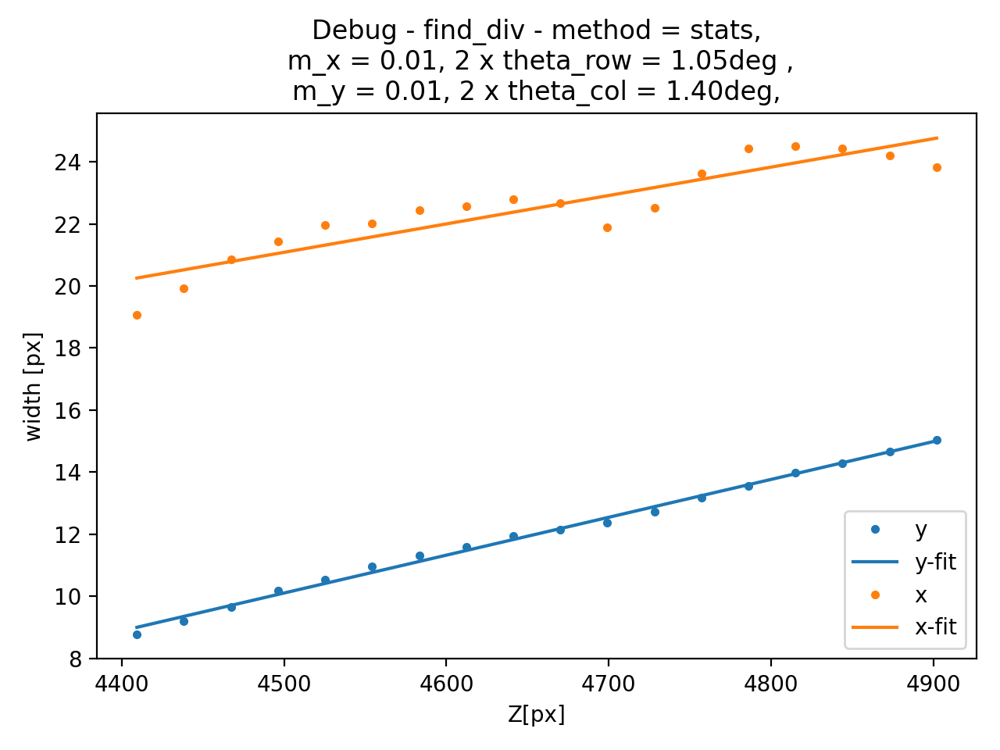

The divergence angles of the beam idx=7, idy = 7 have been updated:
div_row = 0.604deg, e_col = 1.407deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=8, idy = 0 have been updated:
div_row = -1.035deg, e_col = 0.262deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=8, idy = 1 have been updated:
div_row = -1.035deg, e_col = 0.262deg


<IPython.core.display.Javascript object>


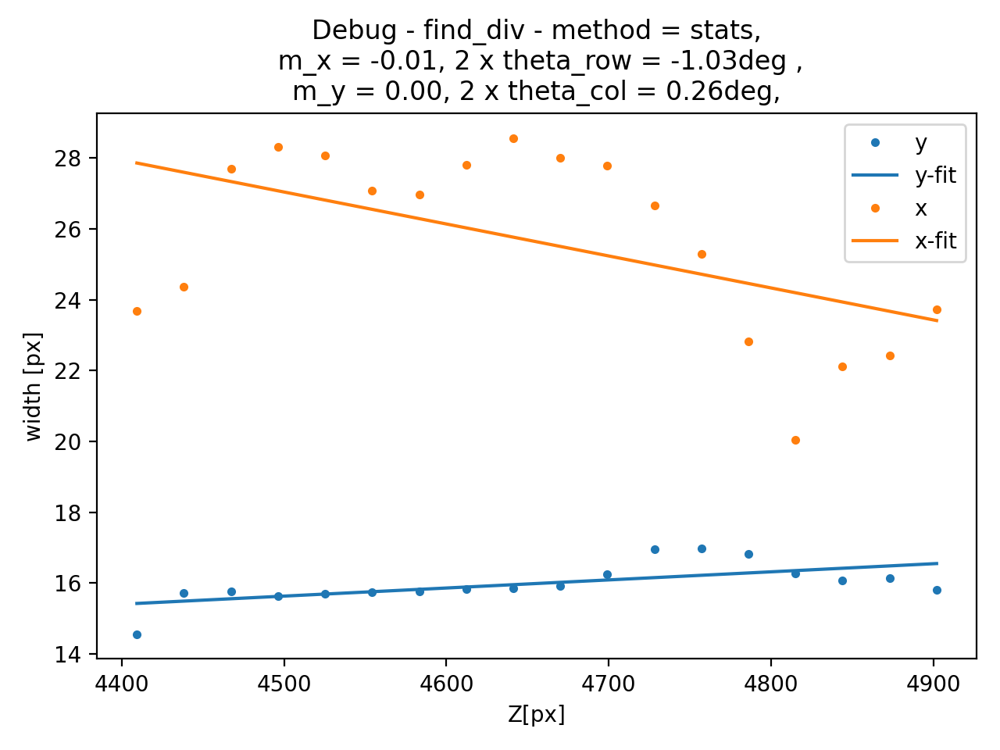

The divergence angles of the beam idx=8, idy = 2 have been updated:
div_row = 1.471deg, e_col = 1.266deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=8, idy = 3 have been updated:
div_row = 1.471deg, e_col = 1.266deg


<IPython.core.display.Javascript object>


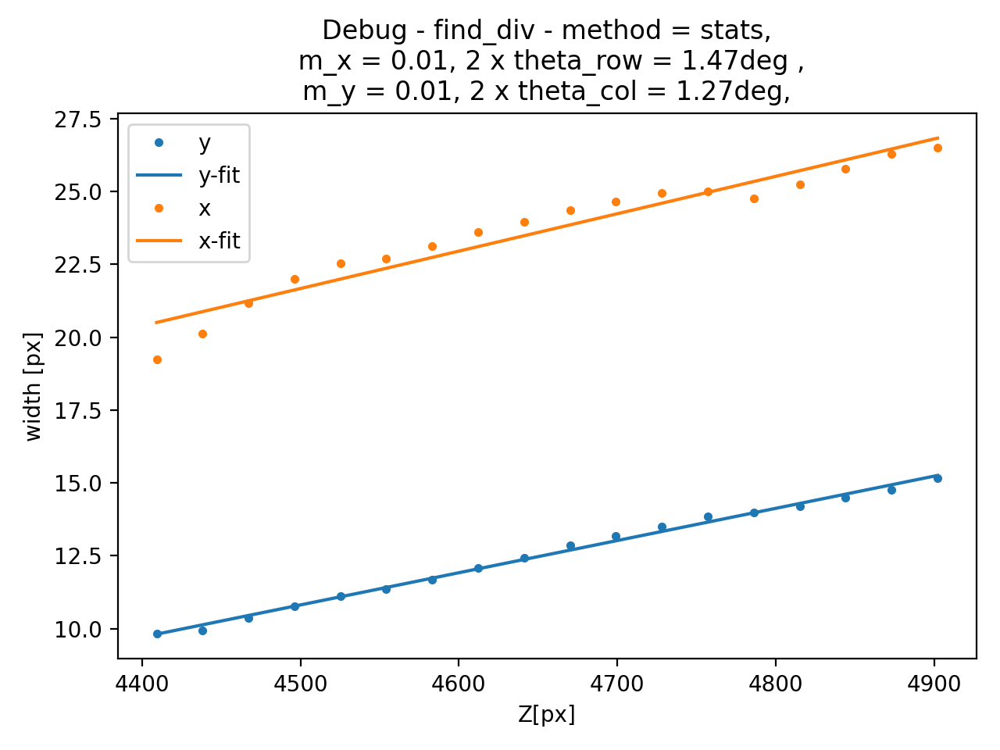

The divergence angles of the beam idx=8, idy = 4 have been updated:
div_row = 1.888deg, e_col = 1.285deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=8, idy = 5 have been updated:
div_row = 0.914deg, e_col = 1.333deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=8, idy = 6 have been updated:
div_row = 1.029deg, e_col = 1.316deg


<IPython.core.display.Javascript object>


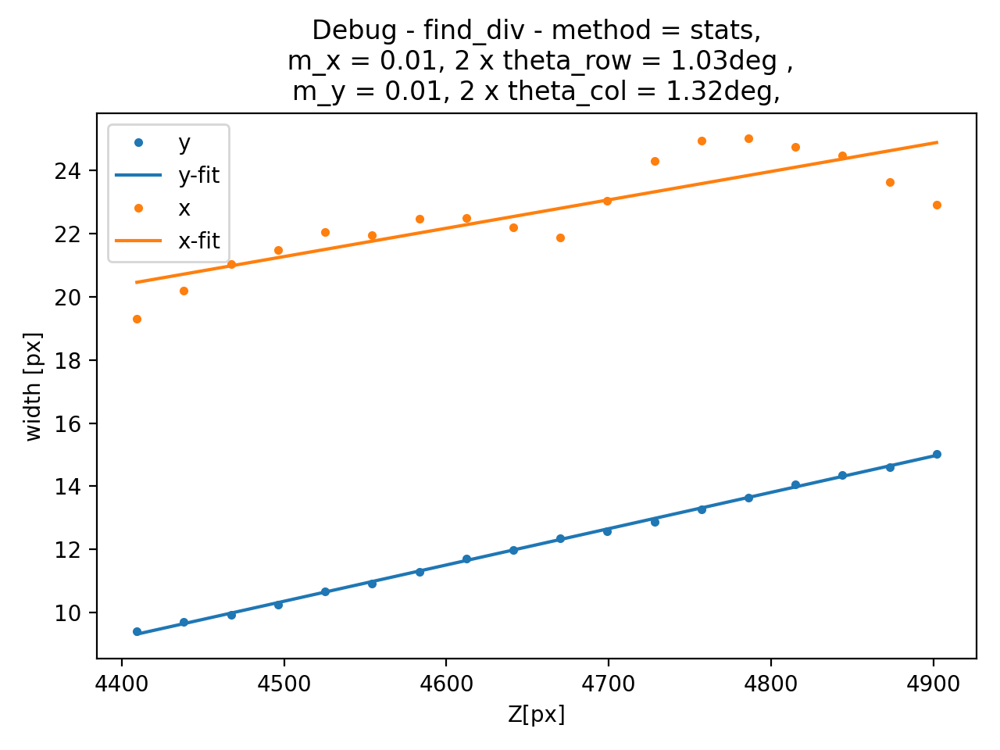

The divergence angles of the beam idx=8, idy = 7 have been updated:
div_row = 0.965deg, e_col = 1.274deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=9, idy = 0 have been updated:
div_row = -1.035deg, e_col = 0.262deg


<IPython.core.display.Javascript object>


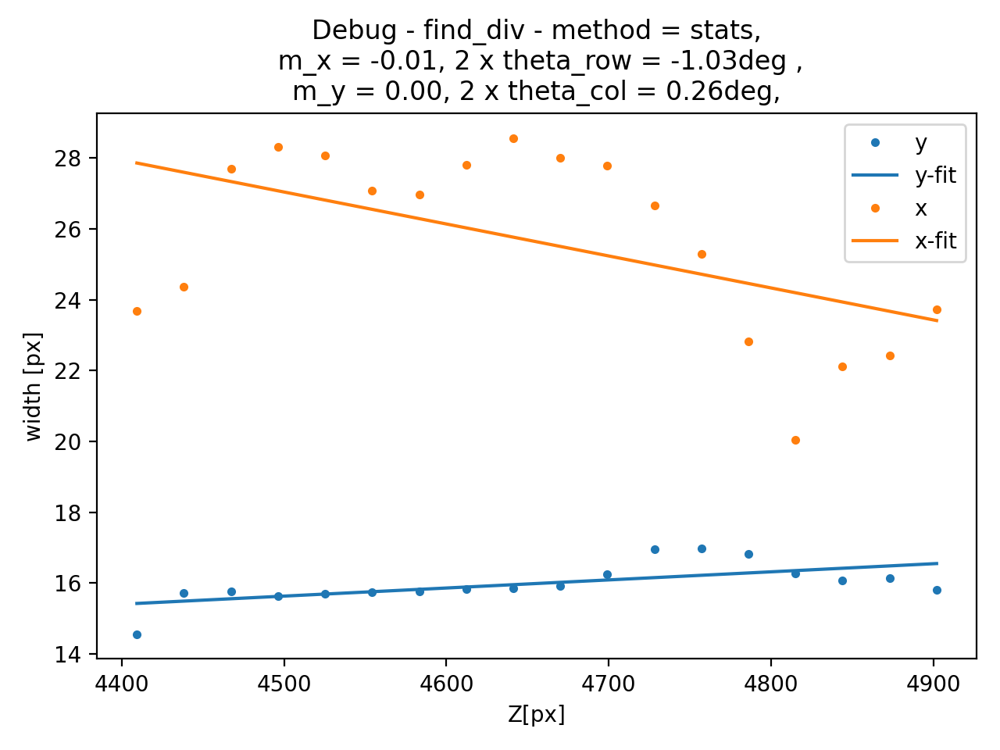

The divergence angles of the beam idx=9, idy = 1 have been updated:
div_row = 0.616deg, e_col = 1.208deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=9, idy = 2 have been updated:
div_row = 0.616deg, e_col = 1.208deg


<IPython.core.display.Javascript object>


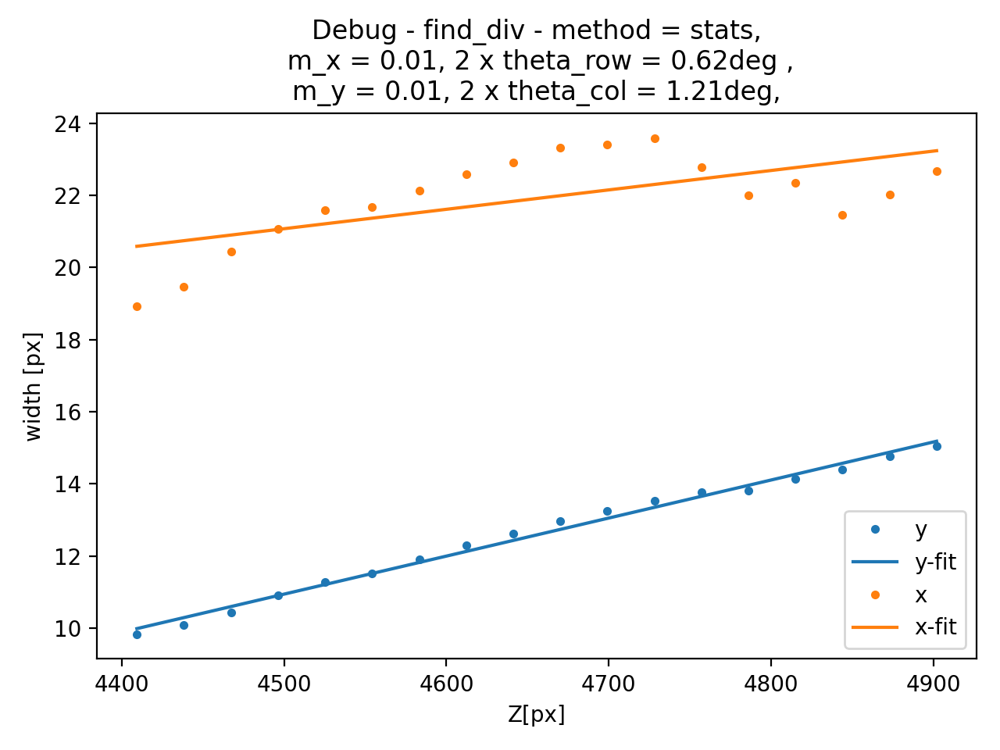

The divergence angles of the beam idx=9, idy = 3 have been updated:
div_row = 0.616deg, e_col = 1.208deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=9, idy = 4 have been updated:
div_row = 2.140deg, e_col = 1.236deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=9, idy = 5 have been updated:
div_row = 2.074deg, e_col = 1.261deg


<IPython.core.display.Javascript object>

The divergence angles of the beam idx=9, idy = 6 have been updated:
div_row = 0.690deg, e_col = 1.288deg


<IPython.core.display.Javascript object>


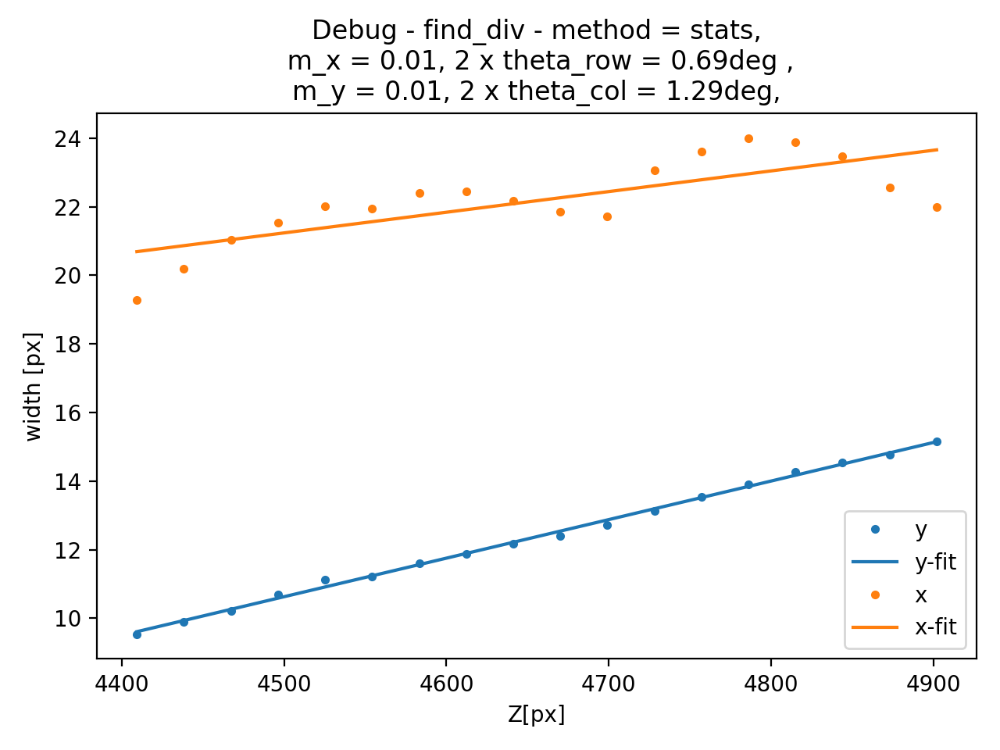

The divergence angles of the beam idx=9, idy = 7 have been updated:
div_row = 0.526deg, e_col = 1.289deg


<IPython.core.display.Javascript object>

Calculated average direction cosine [e_x, e_y, e_z] = [0.01, 0.11, 0.99]


In [6]:
tomo.set_max_z(17.) #limits fits to cross section with z<max_z;

#tomo.find_dir_cos_div(limit_z_fit = True, debug = True) #debug = True, shows and saves the fits to the beam positions and divergence
tomo.find_dir_cos_div(limit_z_fit = True, debug = True) #debug = True, shows and saves the fits to the beam positions and divergence

# Visualise cross sections with location of beams and ROIs

# Plot div_x for all points x,y - tomo.plot_div()

<IPython.core.display.Javascript object>


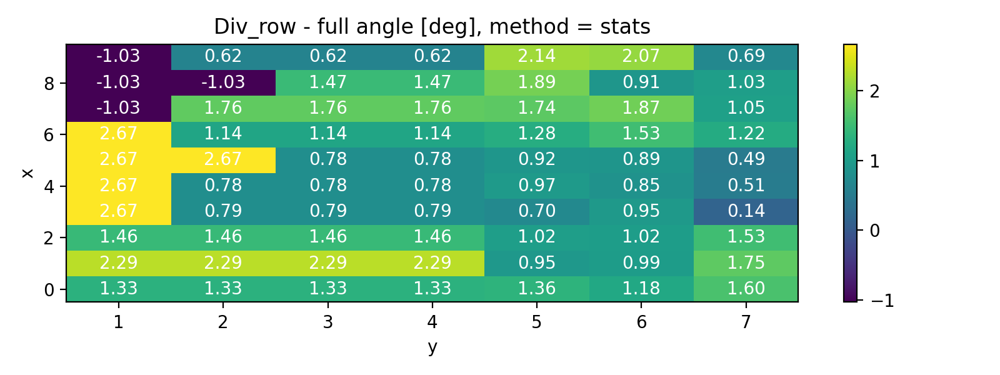

<IPython.core.display.Javascript object>


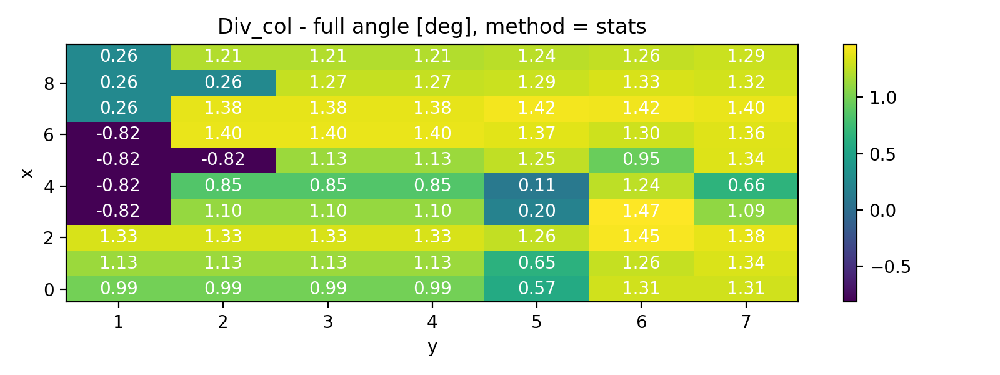

Figure was saved as analysis/2024-01-29 17_53_beam_div_row.png.
Figure was saved as analysis/2024-01-29 17_53_beam_div_col.png.


In [7]:
tomo.plot_div(save = True,)

## Plot histogram with divergences in x and y

<IPython.core.display.Javascript object>


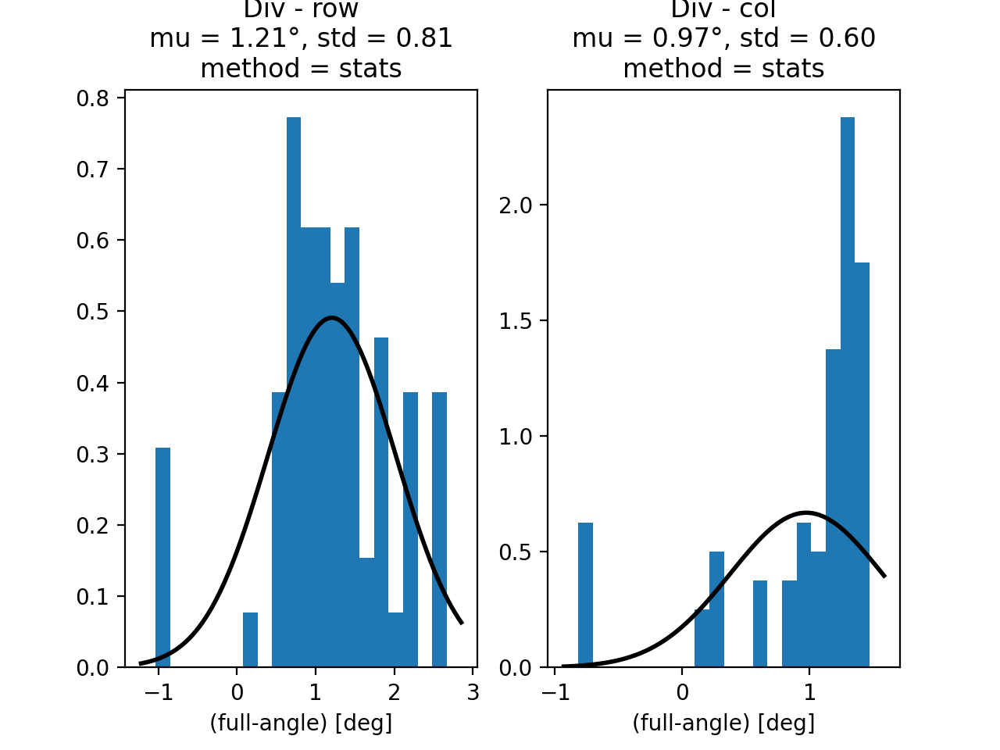

Figure was saved as analysis/2024-01-29 17_53_beam_div_hist.png.


In [8]:
tomo.plot_div_hist(save = True)

## Plot direction of all beams

<IPython.core.display.Javascript object>


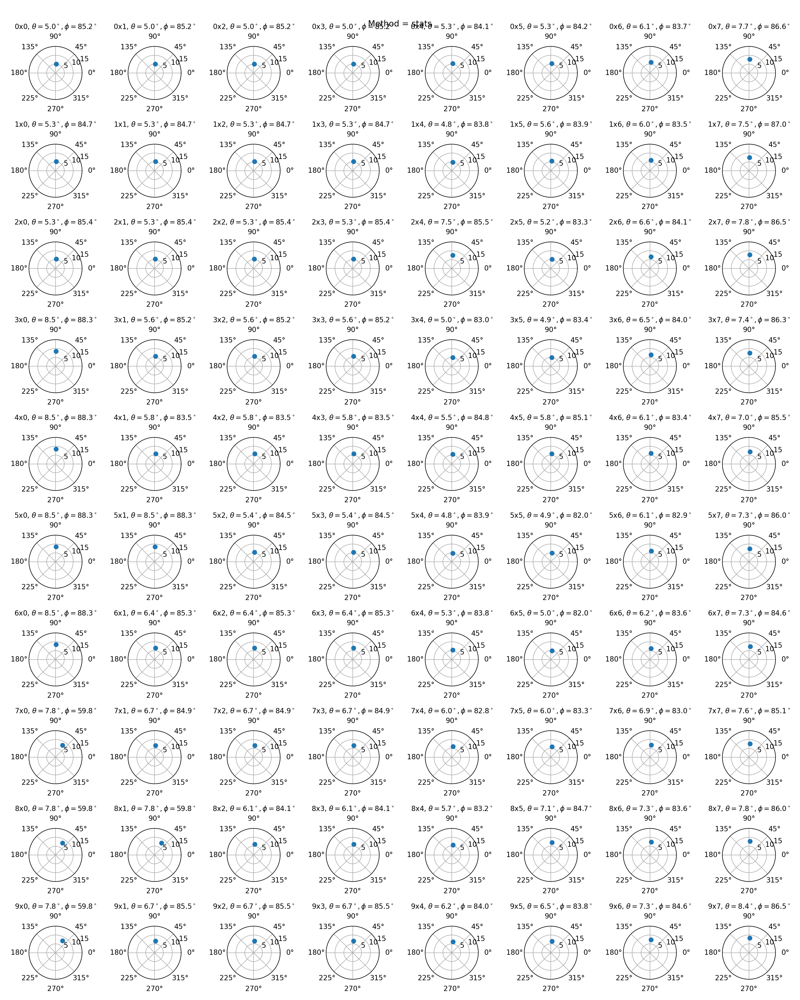

Figure was saved as analysis/2024-01-29 17_54_beam_directions.png.


In [9]:
tomo.plot_dir(save = True)

## Plot direction of all beams - subtract average direction

<IPython.core.display.Javascript object>


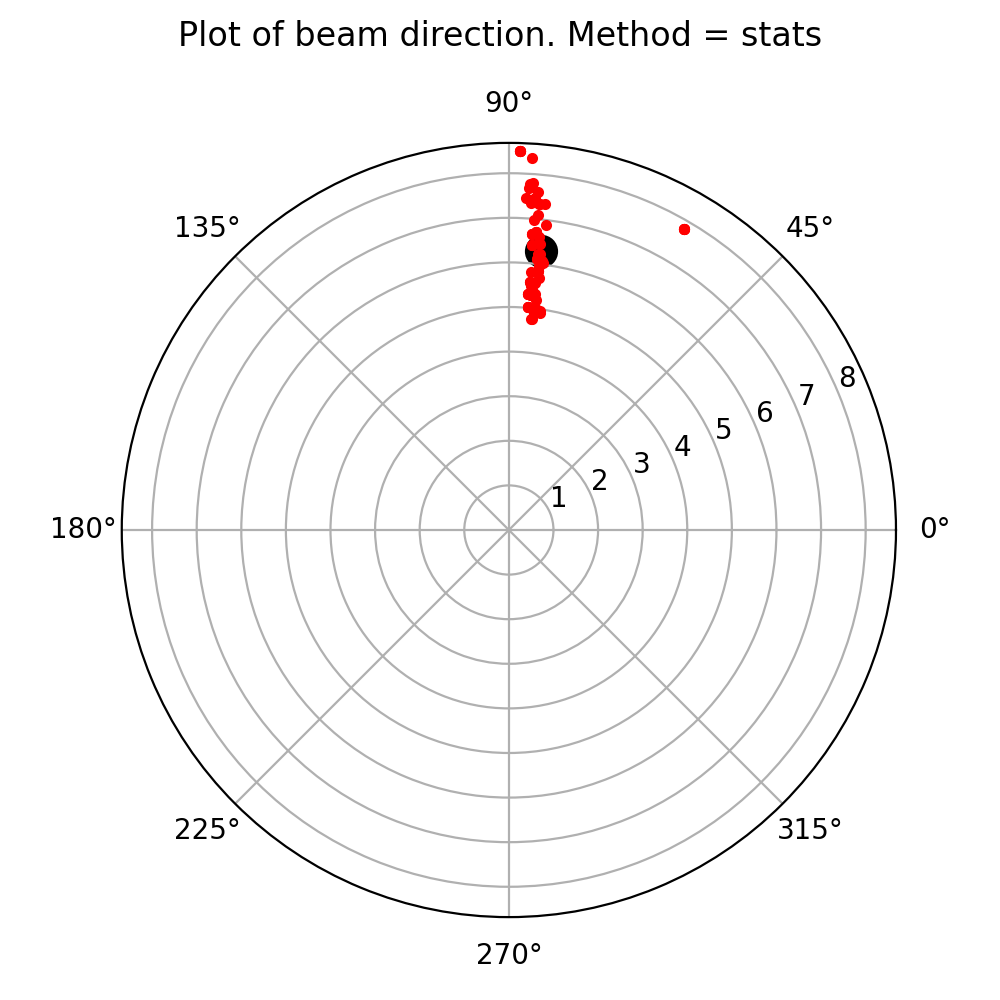

phi_deg = 83.44, theta_deg = 6.29
Figure was saved in home directory as 2024-01-29 17_54_beam_directions_single.png.


In [10]:
tomo.plot_dir_single(save = True)

## Plot uniformity

<IPython.core.display.Javascript object>


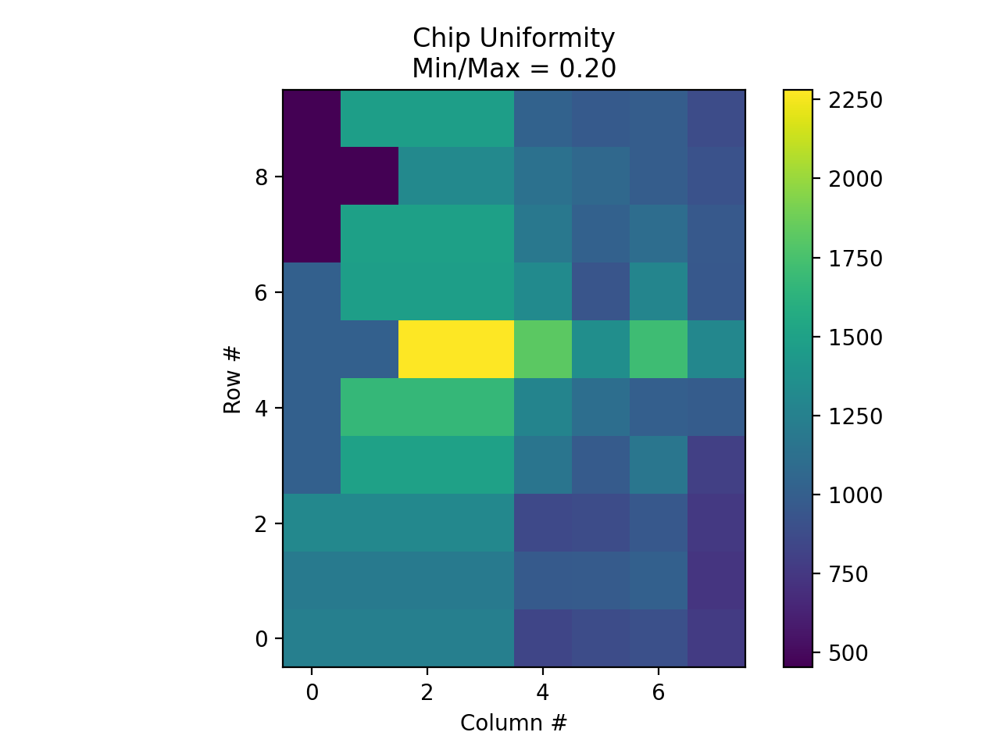

Figure was saved as analysis/2024-01-29 17_54_uniformity.png.


(<Figure size 640x480 with 2 Axes>,
 <AxesSubplot:title={'center':'Chip Uniformity\nMin/Max = 0.20'}, xlabel='Column #', ylabel='Row #'>)

In [11]:
tomo.plot_uniformity(save = True)

# Archive

In [ ]:
vec_mean = tomo.mean_dir_cos

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'},
                          figsize=(5,5),#(2 * tomo.shape[1], 2 * tomo.shape[0]),
                          nrows = 1,
                          ncols = 1)

theta_deg = np.degrees(np.arccos(vec_mean[2]))
phi_rad = np.arctan(vec_mean[1]/vec_mean[0])
print(f"phi_deg = {np.degrees(phi_rad):.2f}, theta_deg = {theta_deg:.2f}")
ax.scatter(phi_rad, theta_deg, marker = "o", s = 120, color = "black")
ax.set_rmax(10)
#ax.set_rlim(10)

#plot direction cosines
for id_x in range(tomo.shape[0]):
    for id_y in range(tomo.shape[1]):
        beam_i = tomo.beam_l[id_x][id_y]
        
        e_x, e_y, e_z = beam_i.e_x, beam_i.e_y, beam_i.e_z
        vec = [e_x, e_y, e_z]

        theta_deg = np.degrees(np.arccos(vec[2]))
        phi_rad = np.arctan(vec[1]/vec[0])
        ax.plot(phi_rad, theta_deg, ".", color = "red")
        
        
#plot direction cosines minus average
beam_i = tomo.beam_l[id_x][id_y]

vec = [beam_i.e_x, beam_i.e_y, beam_i.e_z]
vec = vec - vec_mean
vec = vec / np.linalg.norm(vec)
print(vec)
theta_deg = np.degrees(np.arccos(vec[2]))
phi_rad = np.arctan(vec[1]/vec[0])
#ax.plot(phi_rad, theta_deg, ".", color = "green")

# In the future apply transform to all points that maps the average vector to 0,0,1. 

In [ ]:
vec_mean = tomo.find_mean_dir_cos()
fig, ax_arr = plt.subplots(subplot_kw={'projection': 'polar'},
                           figsize=(2 * tomo.shape[1], 2 * tomo.shape[0]),
                           nrows=tomo.shape[0],
                           ncols=tomo.shape[1])

e_mean_x, e_mean_y, e_mean_z = tomo.mean_dir_cos

#plot mean direction cosines
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})

#plot all direction cosines



for id_x in range(tomo.shape[0]):
    for id_y in range(tomo.shape[1]):
        beam_i = tomo.beam_l[id_x][id_y]
        e_x, e_y, e_z = beam_i.e_x, beam_i.e_y, beam_i.e_z
        
        e_x = e_x - vec_mean[0]
        e_y = e_y - vec_mean[1]
        e_z = e_z - vec_mean[2]

        theta = np.arccos(e_z)
        phi = np.arctan(e_y / e_x)
        label = f"{id_x:.0f}x{id_y:.0f}, $\\theta = {{ {np.degrees(theta):.1f} }}^\circ, \\phi = {{ {np.degrees(phi):.1f} }}^\circ$"

        ax_arr[id_x][id_y].plot(phi, np.degrees(theta), "o")
        ax_arr[id_x][id_y].set_title(f"{label}", fontsize=10)
        ax_arr[id_x][id_y].set_rlim(0, 15)

plt.tight_layout()

In [ ]:
id_x, id_y = 0, 0
beam_i = tomo.beam_l[id_x][id_y]
e_x, e_y, e_z = beam_i.e_x, beam_i.e_y, beam_i.e_z


e_x_m = vec_mean[0]
e_y_m = vec_mean[1]
e_z_m = vec_mean[2]

#default direction
e_x =e_x
e_y =e_y
e_z =e_z

theta_rad = np.arccos(e_z)
phi_rad = np.arctan(e_y / e_x)
theta_deg = np.degrees(theta_rad)
phi_deg = np.degrees(phi_rad)
print(f"Default directions: theta_deg = {theta_deg:.2f}°phi_deg = {phi_deg:.2f}°")

#average directions
theta_m_rad = np.arccos(e_z_m)
phi_m_rad = np.arctan(e_y_m / e_x_m)
theta_m_deg = np.degrees(theta_m_rad)
phi_m_deg = np.degrees(phi_m_rad)
print(f"Average directions: theta_m_deg = {theta_m_deg:.2f}°phi_m_deg = {phi_m_deg:.2f}°")


label = f" $\\theta = {{ {np.degrees(theta):.1f} }}^\circ, \\phi = {{ {np.degrees(phi):.1f} }}^\circ$"
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
print("theta", theta)
print("phi_deg", phi_deg)

ax.plot(phi_rad, theta_deg, ".", label ="default") # default
ax.plot(phi_m_rad, theta_m_deg, ".", label = "average") # average

ax.set_title(f"{label}", fontsize=10)
#ax.set_rlim(0, 15)

plt.legend()
plt.tight_layout()

In [ ]:
fig, ax_arr = plt.subplots(subplot_kw={'projection': 'polar'},
                           figsize = (2*tomo.shape[1], 2*tomo.shape[0]),
                           nrows = tomo.shape[0],
                           ncols = tomo.shape[1])

for id_x in range(tomo.shape[0]):
    for id_y in range(tomo.shape[1]):
        beam_i = tomo.beam_l[id_x][id_y]
        e_x, e_y, e_z = beam_i.e_x, beam_i.e_y, beam_i.e_z

        theta = np.arccos(e_z)
        phi = np.arctan(e_y/e_x)  
        label = f"{id_x:.0f}x{id_y:.0f}, $\\theta = {{ {np.degrees(theta):.1f} }}^\circ, \\phi = {{ {np.degrees(phi):.1f} }}^\circ$"

        ax_arr[id_x][id_y].plot(phi, np.degrees(theta), "o")
        ax_arr[id_x][id_y].set_title(f"{label}", fontsize = 10)
        ax_arr[id_x][id_y].set_rlim(0, 15)
    
plt.tight_layout()

In [ ]:
n_rows = tomo.shape[0]
n_cols = tomo.shape[1]

fig, ax_arr = plt.subplots(subplot_kw={'projection': 'polar'},
                           figsize = (12, 6),
                           nrows = n_rows,
                           ncols = n_cols)

for id_x in range(n_rows):
    for id_y in range(n_cols):
        ax = ax_arr[-id_x-1][id_y]
        beam_i = tomo.beam_l[id_x][id_y]
        e_x, e_y, e_z = beam_i.e_x, beam_i.e_y, beam_i.e_z
        
        theta = np.arccos(e_z)
        phi = np.arctan(e_y/e_x)  
        #label = f"{id_x:.0f}x{id_y:.0f}"

        ax.set_rlim(0, 1.5)
        ax.set_rticks([0.5, 1, 1.5])
        ax.set_yticklabels([])
        
        ax.plot(phi, np.degrees(theta), "o")
        #ax.set_title(f"{label}", fontsize = 10)
        
plt.tight_layout()


In [ ]:
 #ax.set_rticks([])
            #ax2.set_rgrids([0.5, 1, 1.5])
                        #ax.set_xticklabels(['N', '', 'W', '', 'S', '', 'E', ''])
            #ax.set_xticklabels(['', '', '', '', '', '', '', ''])
            #ax.set_rlabel_position(120)

            #ax.plot(phi, np.degrees(theta), "o")
            #ax.set_title(f"{label}", fontsize = 10)

In [ ]:
div_x_arr.shape

In [ ]:
id_x = 0
id_y = 0

div_x_arr = np.zeros(x.shape)
for id_x in range(x.shape[0]):
    for id_y in range(x.shape[1]):
        beam_i = tomo.beam_l[id_x][id_y]
        div_x_arr[id_x, id_y] = beam_i.div_x
        #print(id_x, id_y, ":", beam_i.div_x)
div_x_arr

In [ ]:
# Create a grid of x, y values
x_values = np.linspace(-5, 5, 10)
y_values = np.linspace(-5, 5, 10)
x, y = np.meshgrid(x_values, y_values)

# Evaluate the function on the grid
z = f(x, y)

# Plot using a colormap
plt.figure(figsize=(8, 6))
colormap = plt.pcolormesh(x, y, z, cmap='viridis', shading='auto')

# Print the value of the function on each square
for (i, j), val in np.ndenumerate(z):
    plt.text(x_values[j], y_values[i], f"{val:.2f}", ha='center', va='center', color='white')

# Adding color bar, labels and title
plt.colorbar(colormap)
plt.xlabel('x')
plt.ylabel('y')
plt.title('Scalar values of f(x, y) over a grid')
plt.show()


## Visualise first layer with ROI

## Beam and cross section classes

## Collect cross sections of the same beam for different z